#Overview
membuat dan memvalidasi dataset pelatihan untuk k-NN classifier yang digunakan dalam solusi MediaPipe Pose Classification.

1. Menguji dataset ini dengan algoritma KNN.


# Step 0: Mulai Google Colab

Install Depedensi yang diperlukan

In [ ]:
!pip install pillow==8.1.0
!pip install matplotlib==3.3.4
!pip install numpy==1.19.3
!pip install opencv-python==4.5.1.48
!pip install tqdm==4.56.0
!pip install requests==2.25.1



     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.9/44.9 MB 7.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pillow: filename=Pillow-8.1.0-cp310-cp310-linux_x86_64.whl size=1163256 sha256=7be8d5f6cc181b9202ca110f2c97ef3220580f3d989b64e63a4e0cabea8d5957
  Stored in directory: /root/.cache/pip/wheels/69/ff/e2/ff104a7329d86003512672dcce62234921a9bfb347340fd52c
Successfully built pillow
  Attempting uninstall: pillow
    Found existing installation: pillow 11.0.0
    Uninstalling pillow-11.0.0:
      Successfully uninstalled pillow-11.0.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
fastai 2.7.18 requires pillow>=9.0.0, but you have pillow 8.1.0 which is incompatible.
google-genai 0.1.0 requires pillow<12.0.0,>=10.0.0, but you have pillow 8.1.0 which is incompatible.
imageio 2.36.1 requires pillow>=8.3.2, but you have pillow 8.1.0

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 37.9/37.9 MB 34.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for matplotlib: filename=matplotlib-3.3.4-cp310-cp310-linux_x86_64.whl size=11685174 sha256=879e3a8b589e89d6c594de6ee5a29c6ebfadaf887ffc50fdc4f63658efdd4260
  Stored in directory: /root/.cache/pip/wheels/38/c6/49/eaba6d234887d98d9c85185e2a90bd7bb77934e85eefaf317e
Successfully built matplotlib
  Attempting uninstall: matplotlib
    Found existing installation: matplotlib 3.8.0
    Uninstalling matplotlib-3.8.0:
      Successfully uninstalled matplotlib-3.8.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
arviz 0.20.0 requires matplotlib>=3.5, but you have matplotlib 3.3.4 which is incompatible.
bigframes 1.27.0 requires matplotlib>=3.7.1, but you have matplotlib 3.3.4 which is incompatible.
fastai 2.7.18 requires pillow>=9.0.

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.3/7.3 MB 77.7 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  error: subprocess-exited-with-error
  
  × Building wheel for numpy (pyproject.toml) did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  ERROR: Failed building wheel for numpy
Failed to build numpy
ERROR: ERROR: Failed to build installable wheels for some pyproject.toml based projects (numpy)
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.3/88.3 MB 8.9 MB/s eta 0:00:00
  error: subprocess-exited-with-error
  
  × pip subprocess to install build dependencies did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Installing build dependencies ... error
error:

In [ ]:
!pip install mediapipe==0.10.5

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 33.5/33.5 MB 23.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 41.7 MB/s eta 0:00:00
  Attempting uninstall: protobuf
    Found existing installation: protobuf 4.25.5
    Uninstalling protobuf-4.25.5:
      Successfully uninstalled protobuf-4.25.5
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
grpcio-status 1.62.3 requires protobuf>=4.21.6, but you have protobuf 3.20.3 which is incompatible.


# Code


## matplotlib



In [ ]:
from matplotlib import pyplot as plt

def show_image(img, figsize=(10, 10)):

  # Membuat area tampilan
  plt.figure(figsize=figsize)
  # Menampilkan gambar
  plt.imshow(img)
  plt.show()


## Pose embedding

# FullBodyPoseEmbedder
Kelas ini bertujuan untuk mengonversi landmark 3D dari pose tubuh menjadi embedding 3D.
Embedding ini dapat digunakan untuk membandingkan pose atau melakukan klasifikasi lebih lanjut.

Fitur Utama:
1. Normalisasi Landmark
Landmark dipusatkan dan diskalakan berdasarkan ukuran tubuh, sehingga lebih seragam untuk berbagai ukuran tubuh pengguna.

2. Pembuatan Embedding
Menggunakan jarak antar landmark tertentu untuk membuat representasi pose.

In [ ]:
class FullBodyPoseEmbedder(object):
  """Mengonversi landmark 3D pose menjadi embedding 3D."""

  def __init__(self, torso_size_multiplier=2.5):
    # Faktor pengali untuk menentukan ukuran minimum tubuh
    self._torso_size_multiplier = torso_size_multiplier

    # landmark
    self._landmark_names = [
        'nose',
        'left_eye_inner', 'left_eye', 'left_eye_outer',
        'right_eye_inner', 'right_eye', 'right_eye_outer',
        'left_ear', 'right_ear',
        'mouth_left', 'mouth_right',
        'left_shoulder', 'right_shoulder',
        'left_elbow', 'right_elbow',
        'left_wrist', 'right_wrist',
        'left_pinky_1', 'right_pinky_1',
        'left_index_1', 'right_index_1',
        'left_thumb_2', 'right_thumb_2',
        'left_hip', 'right_hip',
        'left_knee', 'right_knee',
        'left_ankle', 'right_ankle',
        'left_heel', 'right_heel',
        'left_foot_index', 'right_foot_index',
    ]

  def __call__(self, landmarks):
    """Normalisasi landmark pose dan konversi menjadi embedding.

    Args:
      landmarks: Array NumPy dengan landmark 3D, berbentuk (N, 3).

    Returns:
      Embedding pose berbentuk array NumPy (M, 3), di mana `M` adalah jumlah
      jarak pasangan yang didefinisikan dalam `_get_pose_distance_embedding`.
    """


    assert landmarks.shape[0] == len(self._landmark_names), \
        'Jumlah landmark tidak sesuai: {}'.format(landmarks.shape[0])

    landmarks = np.copy(landmarks)

    # Normalisasi landmark
    landmarks = self._normalize_pose_landmarks(landmarks)

    # Dapatkan embedding.
    embedding = self._get_pose_distance_embedding(landmarks)

    return embedding

  def _normalize_pose_landmarks(self, landmarks):
    """Menormalisasi landmark berdasarkan posisi dan skala."""
    landmarks = np.copy(landmarks)

    # Normalisasi posisi (pusatkan ke titik tengah panggul).
    pose_center = self._get_pose_center(landmarks)
    landmarks -= pose_center

    # Normalisasi skala
    pose_size = self._get_pose_size(landmarks, self._torso_size_multiplier)
    landmarks /= pose_size

    landmarks *= 100

    return landmarks

  def _get_pose_center(self, landmarks):
    """Menghitung pusat pose sebagai titik tengah antara kedua panggul."""
    left_hip = landmarks[self._landmark_names.index('left_hip')]
    right_hip = landmarks[self._landmark_names.index('right_hip')]
    center = (left_hip + right_hip) * 0.5
    return center

  def _get_pose_size(self, landmarks, torso_size_multiplier):
    """Menghitung ukuran tubuh berdasarkan torso dan jarak maksimum."""
    # Ambil hanya koordinat X dan Y untuk perhitungan ukuran.
    landmarks = landmarks[:, :2]

    # Titik tengah panggul.
    left_hip = landmarks[self._landmark_names.index('left_hip')]
    right_hip = landmarks[self._landmark_names.index('right_hip')]
    hips = (left_hip + right_hip) * 0.5

    # Titik tengah bahu.
    left_shoulder = landmarks[self._landmark_names.index('left_shoulder')]
    right_shoulder = landmarks[self._landmark_names.index('right_shoulder')]
    shoulders = (left_shoulder + right_shoulder) * 0.5

    # Ukuran torso dari jarak bahu ke panggul.
    torso_size = np.linalg.norm(shoulders - hips)

    # Hitung jarak maksimum dari pusat pose ke landmark lainnya.
    pose_center = self._get_pose_center(landmarks)
    max_dist = np.max(np.linalg.norm(landmarks - pose_center, axis=1))

    return max(torso_size * torso_size_multiplier, max_dist)

  def _get_pose_distance_embedding(self, landmarks):
    """Mengonversi landmark menjadi embedding berbasis jarak antar landmark."""
    embedding = np.array([
        # Jarak antar sendi utama.
        self._get_distance(
            self._get_average_by_names(landmarks, 'left_hip', 'right_hip'),
            self._get_average_by_names(landmarks, 'left_shoulder', 'right_shoulder')),

        self._get_distance_by_names(landmarks, 'left_shoulder', 'left_elbow'),
        self._get_distance_by_names(landmarks, 'right_shoulder', 'right_elbow'),
    ])
    return embedding

  def _get_average_by_names(self, landmarks, name_from, name_to):
    """Menghitung titik tengah antara dua landmark."""
    lmk_from = landmarks[self._landmark_names.index(name_from)]
    lmk_to = landmarks[self._landmark_names.index(name_to)]
    return (lmk_from + lmk_to) * 0.5

  def _get_distance_by_names(self, landmarks, name_from, name_to):
    """Menghitung jarak antara dua landmark berdasarkan nama."""
    lmk_from = landmarks[self._landmark_names.index(name_from)]
    lmk_to = landmarks[self._landmark_names.index(name_to)]
    return self._get_distance(lmk_from, lmk_to)

  def _get_distance(self, lmk_from, lmk_to):
    """Menghitung perbedaan posisi dua landmark."""
    return lmk_to - lmk_from


## Pose classification

In [ ]:
# merepresentasikan sampel pose beserta detailnya
class PoseSample(object):

    def __init__(self, name, landmarks, class_name, embedding):
        """
        Menginisialisasi sampel pose dengan atribut berikut:
        - name: Nama atau pengenal unik untuk sampel pose.
        - landmarks: Titik-titik pose sebagai array NumPy.
        - class_name: Kelas atau kategori pose (misalnya squat, push-up).
        - embedding: Representasi embedding dari pose untuk digunakan dalam klasifikasi.
        """
        self.name = name
        self.landmarks = landmarks
        self.class_name = class_name
        self.embedding = embedding


# Definisikan kelas untuk merepresentasikan outlier
class PoseSampleOutlier(object):

    def __init__(self, sample, detected_class, all_classes):
        """
        Menginisialisasi sampel outlier dengan atribut berikut:
        - sample: Sampel pose yang terdeteksi sebagai outlier.
        - detected_class: Kelas yang terdeteksi oleh sistem untuk pose ini.
        - all_classes: Daftar semua kelas yang mungkin dalam proses klasifikasi.
        """
        self.sample = sample
        self.detected_class = detected_class
        self.all_classes = all_classes


In [ ]:
import csv
import numpy as np
import os

class PoseClassifier(object):
    """Mengklasifikasikan pose berdasarkan landmark."""

    def __init__(self,
                 pose_samples_folder,
                 pose_embedder,
                 file_extension='csv',
                 file_separator=',',
                 n_landmarks=33,
                 n_dimensions=3,
                 top_n_by_max_distance=30,
                 top_n_by_mean_distance=10,
                 axes_weights=(1., 1., 0.2)):
        """
        Inisialisasi PoseClassifier.
        Parameter penting:
        - pose_samples_folder: Folder berisi data pose (format CSV).
        - pose_embedder: Fungsi embedding untuk landmark pose.
        - axes_weights: Bobot tiap sumbu (x, y, z) dalam perhitungan jarak.
        """
        self._pose_embedder = pose_embedder
        self._n_landmarks = n_landmarks
        self._n_dimensions = n_dimensions
        self._top_n_by_max_distance = top_n_by_max_distance
        self._top_n_by_mean_distance = top_n_by_mean_distance
        self._axes_weights = axes_weights

        # Memuat data pose
        self._pose_samples = self._load_pose_samples(
            pose_samples_folder,
            file_extension,
            file_separator,
            n_landmarks,
            n_dimensions,
            pose_embedder
        )

    def _load_pose_samples(self,
                           pose_samples_folder,
                           file_extension,
                           file_separator,
                           n_landmarks,
                           n_dimensions,
                           pose_embedder):
        """
        Memuat sampel pose dari folder yang ditentukan.

        Format folder yang diperlukan:
        - pushups_down.csv, squats_up.csv, dll.
        Format CSV:
        - Baris pertama berisi nama sampel dan koordinat landmark (x, y, z).
        """
        file_names = [
            name for name in os.listdir(pose_samples_folder)
            if name.endswith(file_extension)
        ]

        pose_samples = []
        for file_name in file_names:
            class_name = file_name[:-(len(file_extension) + 1)]

            with open(os.path.join(pose_samples_folder, file_name)) as csv_file:
                csv_reader = csv.reader(csv_file, delimiter=file_separator)
                for row in csv_reader:
                    assert len(row) == n_landmarks * n_dimensions + 1, \
                        'Jumlah nilai tidak sesuai: {}'.format(len(row))

                    # Landmark pose disimpan dalam array NumPy.
                    landmarks = np.array(row[1:], np.float32).reshape([n_landmarks, n_dimensions])
                    pose_samples.append(PoseSample(
                        name=row[0],
                        landmarks=landmarks,
                        class_name=class_name,
                        embedding=pose_embedder(landmarks),
                    ))

        return pose_samples

    def find_pose_sample_outliers(self):
        """Mendeteksi pose sampel yang dianggap outlier."""
        outliers = []
        for sample in self._pose_samples:
            # Temukan pose terdekat berdasarkan landmark.
            pose_landmarks = sample.landmarks.copy()
            pose_classification = self.__call__(pose_landmarks)
            class_names = [
                class_name for class_name, count in pose_classification.items()
                if count == max(pose_classification.values())
            ]

            # Sampel dianggap outlier jika terdeteksi memiliki kelas berbeda atau memiliki lebih dari satu kelas terdekat.
            if sample.class_name not in class_names or len(class_names) != 1:
                outliers.append(PoseSampleOutlier(sample, class_names, pose_classification))

        return outliers

    def __call__(self, pose_landmarks):
        """
        Mengklasifikasikan pose berdasarkan landmark.

        Proses klasifikasi:
        1. Pilih N sampel teratas berdasarkan jarak maksimum untuk menghilangkan outlier.
        2. Pilih N sampel teratas berdasarkan jarak rata-rata untuk hasil akhir.

        Args:
        - pose_landmarks: Array NumPy dengan landmark 3D (N x 3).

        Returns:
        - Dictionary hasil klasifikasi (kelas -> jumlah sampel terdekat).
        """
        assert pose_landmarks.shape == (self._n_landmarks, self._n_dimensions), \
            'Shape tidak sesuai: {}'.format(pose_landmarks.shape)

        # Embedding pose yang diberikan
        # flipped
        pose_embedding = self._pose_embedder(pose_landmarks)
        flipped_pose_embedding = self._pose_embedder(pose_landmarks * np.array([-1, 1, 1]))

        # Filter arak maksimum.
        max_dist_heap = []
        for sample_idx, sample in enumerate(self._pose_samples):
            max_dist = min(
                np.max(np.abs(sample.embedding - pose_embedding) * self._axes_weights),
                np.max(np.abs(sample.embedding - flipped_pose_embedding) * self._axes_weights),
            )
            max_dist_heap.append([max_dist, sample_idx])

        max_dist_heap = sorted(max_dist_heap, key=lambda x: x[0])[:self._top_n_by_max_distance]

        # Filter jarak rta-rata.
        mean_dist_heap = []
        for _, sample_idx in max_dist_heap:
            sample = self._pose_samples[sample_idx]
            mean_dist = min(
                np.mean(np.abs(sample.embedding - pose_embedding) * self._axes_weights),
                np.mean(np.abs(sample.embedding - flipped_pose_embedding) * self._axes_weights),
            )
            mean_dist_heap.append([mean_dist, sample_idx])

        mean_dist_heap = sorted(mean_dist_heap, key=lambda x: x[0])[:self._top_n_by_mean_distance]

        # Hasilkan kelas berdasarkan jumlah sampel terdekat.
        class_names = [
            self._pose_samples[sample_idx].class_name for _, sample_idx in mean_dist_heap
        ]
        result = {class_name: class_names.count(class_name) for class_name in set(class_names)}

        return result


## Classification smoothing

In [ ]:
class EMADictSmoothing(object):
    """ Exponential Moving Average (EMA)."""

    def __init__(self, window_size=10, alpha=0.2):
        """
        Inisialisasi smoothing.
        Args:
        - window_size: Jumlah maksimum data yang dipertimbangkan dalam jendela waktu.
        - alpha: Faktor peluruhan untuk perhitungan EMA (nilai lebih kecil memberikan lebih banyak kelancaran).
        """
        self._window_size = window_size
        self._alpha = alpha
        self._data_in_window = []  # Buffer untuk menyimpan data klasifikasi

    def __call__(self, data):
        """
        Melakukan smoothing pada klasifikasi pose.
        Smoothing dilakukan dengan menghitung EMA untuk setiap kelas pose.

        Args:
        - data: Dictionary dengan hasil klasifikasi pose. Contoh:
            {
              'pushups_down': 8,
              'pushups_up': 2,
            }

        Returns:
        - Dictionary dengan nilai yang telah di-smoothed (float). Contoh:
            {
              'pushups_down': 8.3,
              'pushups_up': 1.7,
            }
        """
        # buffer
        self._data_in_window.insert(0, data)
        self._data_in_window = self._data_in_window[:self._window_size]

        # Identifikasi semua kelas pose yang udah pernah muncul
        keys = set([key for data in self._data_in_window for key, _ in data.items()])

        # nilai smoothed
        smoothed_data = dict()
        for key in keys:
            factor = 1.0
            top_sum = 0.0
            bottom_sum = 0.0

            for data in self._data_in_window:
                value = data[key] if key in data else 0.0

                # Update top_sum dan bottom_sum sama faktor.
                top_sum += factor * value
                bottom_sum += factor

                # Perbarui faktor
                factor *= (1.0 - self._alpha)

            smoothed_data[key] = top_sum / bottom_sum

        return smoothed_data


## Repetition counter

In [ ]:
class RepetitionCounter(object):

    def __init__(self, class_name, enter_threshold=6, exit_threshold=4):
        """
        Inisialisasi repetisi counter
        Args:
        - class_name: Nama kelas pose yang akan dihitung repetisinya.
        - enter_threshold: Ambang batas untuk memasuki pose (jika pose confidence melewati threshold ini, kita anggap masuk).
        - exit_threshold: Ambang batas untuk keluar dari pose (jika pose confidence turun di bawah threshold ini, kita anggap keluar).
        """
        self._class_name = class_name
        self._enter_threshold = enter_threshold
        self._exit_threshold = exit_threshold

        # Status pose masukk
        self._pose_entered = False

        # Jumlah repetisi dihitung.
        self._n_repeats = 0

    @property
    def n_repeats(self):
        return self._n_repeats

    def __call__(self, pose_classification):
        """
        Menghitung jumlah repetisi yang terjadi hingga frame tertentu.

        Untuk menghindari prediksi yang salah karena jittering (getaran kecil), kita menggunakan dua threshold:
        - Masuk pose jika confidence melebihi `enter_threshold`.
        - Keluar pose jika confidence turun di bawah `exit_threshold`.

        Args:
        - pose_classification: Dictionary klasifikasi pose untuk frame saat ini. Contoh:
          {
            'pushups_down': 8.3,
            'pushups_up': 1.7,
          }

        Returns:
        - Jumlah repetisi yang telah dihitung.
        """
        # conpidence
        pose_confidence = 0.0
        if self._class_name in pose_classification:
            pose_confidence = pose_classification[self._class_name]

        if not self._pose_entered:
            self._pose_entered = pose_confidence > self._enter_threshold
            return self._n_repeats

        if pose_confidence < self._exit_threshold:
            self._n_repeats += 1
            self._pose_entered = False

        return self._n_repeats


## Classification visualizer

In [ ]:
import io
from PIL import Image
from PIL import ImageFont
from PIL import ImageDraw
import requests
import matplotlib.pyplot as plt


class PoseClassificationVisualizer(object):

  def __init__(self,
               class_name,
               plot_location_x=0.05,
               plot_location_y=0.05,
               plot_max_width=0.4,
               plot_max_height=0.4,
               plot_figsize=(9, 4),
               plot_x_max=None,
               plot_y_max=None,
               counter_location_x=0.85,
               counter_location_y=0.05,
               counter_font_path='https://github.com/googlefonts/roboto/blob/main/src/hinted/Roboto-Regular.ttf?raw=true',
               counter_font_color='red',
               counter_font_size=0.15):
    # Inisialisasi parameter untuk klasifikasi
    self._class_name = class_name
    self._plot_location_x = plot_location_x
    self._plot_location_y = plot_location_y
    self._plot_max_width = plot_max_width
    self._plot_max_height = plot_max_height
    self._plot_figsize = plot_figsize
    self._plot_x_max = plot_x_max
    self._plot_y_max = plot_y_max
    self._counter_location_x = counter_location_x
    self._counter_location_y = counter_location_y
    self._counter_font_path = counter_font_path
    self._counter_font_color = counter_font_color
    self._counter_font_size = counter_font_size

    self._counter_font = None
    self._pose_classification_history = []
    self._pose_classification_filtered_history = []

  def __call__(self,
             frame,
             pose_classification,
             pose_classification_filtered,
             repetitions_count):

    self._pose_classification_history.append(pose_classification)
    self._pose_classification_filtered_history.append(pose_classification_filtered)

    output_img = Image.fromarray(frame)
    output_width, output_height = output_img.size

    img = self._plot_classification_history(output_width, output_height)
    if img is not None:  # Pastikan img tidak kosong.
        img.thumbnail((int(output_width * self._plot_max_width),
                       int(output_height * self._plot_max_height)),
                      Image.ANTIALIAS)
        output_img.paste(img,
                         (int(output_width * self._plot_location_x),
                          int(output_height * self._plot_location_y)))

    output_img_draw = ImageDraw.Draw(output_img)
    if self._counter_font is None:
        font_size = int(output_height * self._counter_font_size)
        font_request = requests.get(self._counter_font_path, allow_redirects=True)
        self._counter_font = ImageFont.truetype(io.BytesIO(font_request.content), size=font_size)
    output_img_draw.text((output_width * self._counter_location_x,
                          output_height * self._counter_location_y),
                         str(repetitions_count),
                         font=self._counter_font,
                         fill=self._counter_font_color)

    return np.array(output_img)



  def _plot_classification_history(self, output_width, output_height):
    fig = plt.figure(figsize=self._plot_figsize)

    for classification_history in [self._pose_classification_history,
                                   self._pose_classification_filtered_history]:
      y = []
      for classification in classification_history:
        y.append(classification.get(self._class_name, 0) if classification else None)
      plt.plot(y, linewidth=7)

    plt.grid(axis='y', alpha=0.75)
    plt.xlabel('Frame')
    plt.ylabel('Confidence')
    plt.title(f'Riwayat Klasifikasi untuk `{self._class_name}`')
    plt.legend(loc='upper right')

    # batas sumbu plot
    if self._plot_y_max is None:
      plt.ylim(top=max(1, max(y)))
    if self._plot_x_max is None:
      plt.xlim(right=len(y))


    # konpersi plot
    buf = io.BytesIO()
    dpi = min(
        output_width * self._plot_max_width / float(self._plot_figsize[0]),
        output_height * self._plot_max_height / float(self._plot_figsize[1]))
    fig.savefig(buf, dpi=dpi)
    buf.seek(0)
    img = Image.open(buf)
    plt.close()

    return img


## Bootstrap helper

BootstrapHelper: Kelas ini membantu mengelola dan memproses gambar-gambar pose tubuh dengan menggunakan MediaPipe untuk deteksi pose. Ia menangani pembacaan gambar, deteksi landmark pose, serta penyimpanan gambar dan landmark dalam format CSV.

Proyeksi XZ: Menggambar proyeksi 2D dari landmark pose tubuh pada bidang XZ untuk visualisasi tambahan.

Aligning Gambar dan CSV: Memastikan gambar dan CSV memiliki sampel yang konsisten, menghapus data yang tidak sesuai.

In [ ]:
import cv2
from matplotlib import pyplot as plt
import numpy as np
import os
from PIL import Image
import sys
import tqdm

# Mengimpor pustaka MediaPipe untuk deteksi pose dan menggambar landmark
from mediapipe.python.solutions import drawing_utils as mp_drawing
from mediapipe.python.solutions import pose as mp_pose


class BootstrapHelper(object):
  """Kelas ini membantu untuk bootstrap gambar dan memfilter sampel pose untuk klasifikasi."""

  def __init__(self,
               images_in_folder,
               images_out_folder,
               csvs_out_folder):
    # Menyimpan folder input, output gambar, dan output CSV
    self._images_in_folder = images_in_folder
    self._images_out_folder = images_out_folder
    self._csvs_out_folder = csvs_out_folder

    # Daftar kelas pose yang akan diproses
    self._pose_class_names = ["pushups","pushdowns"]

  def bootstrap(self, per_pose_class_limit=None):
    """Proses bootstrap gambar dalam folder yang diberikan.

    Folder gambar input harus memiliki struktur seperti ini:
      pushups_up/
        image_001.jpg
        image_002.jpg
        ...
      pushups_down/
        image_001.jpg
        image_002.jpg
        ...

    Folder output CSV yang dihasilkan:
      pushups_up.csv
      pushups_down.csv

    Struktur CSV yang dihasilkan dengan landmark 3D pose:
      sample_00001,x1,y1,z1,x2,y2,z2,....
      sample_00002,x1,y1,z1,x2,y2,z2,....
    """
    # Membuat folder output untuk CSV jika belum ada
    if not os.path.exists(self._csvs_out_folder):
      os.makedirs(self._csvs_out_folder)

    # Memproses setiap kelas pose
    for pose_class_name in self._pose_class_names:
      print('Bootstrapping ', pose_class_name, file=sys.stderr)

      # Menentukan path untuk folder gambar dan CSV untuk setiap kelas pose
      images_in_folder = os.path.join(self._images_in_folder, pose_class_name)
      images_out_folder = os.path.join(self._images_out_folder, pose_class_name)
      csv_out_path = os.path.join(self._csvs_out_folder, pose_class_name + '.csv')
      if not os.path.exists(images_out_folder):
        os.makedirs(images_out_folder)

      # Membuka file CSV untuk menulis data landmark
      with open(csv_out_path, 'w') as csv_out_file:
        csv_out_writer = csv.writer(csv_out_file, delimiter=',', quoting=csv.QUOTE_MINIMAL)

        # Mendapatkan daftar gambar yang ada di folder
        image_names = sorted([n for n in os.listdir(images_in_folder) if not n.startswith('.')])
        if per_pose_class_limit is not None:
          image_names = image_names[:per_pose_class_limit]

        # Memproses setiap gambar
        for image_name in tqdm.tqdm(image_names):
          # Membaca gambar dan mengonversinya ke RGB
          input_frame = cv2.imread(os.path.join(images_in_folder, image_name))
          input_frame = cv2.cvtColor(input_frame, cv2.COLOR_BGR2RGB)

          # Inisialisasi tracker pose dan jalankan proses deteksi pose
          with mp_pose.Pose() as pose_tracker:
            result = pose_tracker.process(image=input_frame)
            pose_landmarks = result.pose_landmarks

          # Menyimpan gambar dengan prediksi pose (jika pose terdeteksi)
          output_frame = input_frame.copy()
          if pose_landmarks is not None:
            mp_drawing.draw_landmarks(
                image=output_frame,
                landmark_list=pose_landmarks,
                connections=mp_pose.POSE_CONNECTIONS)
          output_frame = cv2.cvtColor(output_frame, cv2.COLOR_RGB2BGR)
          cv2.imwrite(os.path.join(images_out_folder, image_name), output_frame)

          # Menyimpan data landmark jika pose terdeteksi
          if pose_landmarks is not None:
            frame_height, frame_width = output_frame.shape[0], output_frame.shape[1]
            pose_landmarks = np.array(
                [[lmk.x * frame_width, lmk.y * frame_height, lmk.z * frame_width]
                 for lmk in pose_landmarks.landmark],
                dtype=np.float32)
            assert pose_landmarks.shape == (33, 3), 'Unexpected landmarks shape: {}'.format(pose_landmarks.shape)
            csv_out_writer.writerow([image_name] + pose_landmarks.flatten().astype(str).tolist())

          # Menggambar proyeksi XZ dan menggabungkannya dengan gambar
          projection_xz = self._draw_xz_projection(
              output_frame=output_frame, pose_landmarks=pose_landmarks)
          output_frame = np.concatenate((output_frame, projection_xz), axis=1)

  def _draw_xz_projection(self, output_frame, pose_landmarks, r=0.5, color='red'):
    """Menggambar proyeksi XZ dari landmark pose."""
    frame_height, frame_width = output_frame.shape[0], output_frame.shape[1]
    img = Image.new('RGB', (frame_width, frame_height), color='white')

    if pose_landmarks is None:
      return np.asarray(img)

    # Mengatur radius berdasarkan lebar gambar
    r *= frame_width * 0.01

    draw = ImageDraw.Draw(img)
    for idx_1, idx_2 in mp_pose.POSE_CONNECTIONS:
      # Membalik Z dan memindahkan pusat pinggul ke tengah gambar
      x1, y1, z1 = pose_landmarks[idx_1] * [1, 1, -1] + [0, 0, frame_height * 0.5]
      x2, y2, z2 = pose_landmarks[idx_2] * [1, 1, -1] + [0, 0, frame_height * 0.5]

      # Menggambar titik dan garis penghubung landmark
      draw.ellipse([x1 - r, z1 - r, x1 + r, z1 + r], fill=color)
      draw.ellipse([x2 - r, z2 - r, x2 + r, z2 + r], fill=color)
      draw.line([x1, z1, x2, z2], width=int(r), fill=color)

    return np.asarray(img)

  def align_images_and_csvs(self, print_removed_items=False):
    for pose_class_name in self._pose_class_names:
      # Menentukan path untuk folder gambar dan CSV untuk setiap kelas pose
      images_out_folder = os.path.join(self._images_out_folder, pose_class_name)
      csv_out_path = os.path.join(self._csvs_out_folder, pose_class_name + '.csv')


      rows = []
      with open(csv_out_path) as csv_out_file:
        csv_out_reader = csv.reader(csv_out_file, delimiter=',')
        for row in csv_out_reader:
          rows.append(row)

      image_names_in_csv = []

      # Menulis kembali CSV setelah menghapus baris yang tidak ada gambar yang sesuai
      with open(csv_out_path, 'w') as csv_out_file:
        csv_out_writer = csv.writer(csv_out_file, delimiter=',', quoting=csv.QUOTE_MINIMAL)
        for row in rows:
          image_name = row[0]
          image_path = os.path.join(images_out_folder, image_name)
          if os.path.exists(image_path):
            image_names_in_csv.append(image_name)
            csv_out_writer.writerow(row)
          elif print_removed_items:
            print('Removed image from CSV: ', image_path)

      # Menghapus gambar yang tidak ada barisnya dalam CSV
      for image_name in os.listdir(images_out_folder):
        if image_name not in image_names_in_csv:
          image_path = os.path.join(images_out_folder, image_name)
          os.remove(image_path)
          if print_removed_items:
            print('Removed image from folder: ', image_path)

  def analyze_outliers(self, outliers):
    for outlier in outliers:
      image_path = os.path.join(self._images_out_folder, outlier.sample.class_name, outlier.sample.name)

      print('Outlier')
      print('  sample path =    ', image_path)
      print('  sample class =   ', outlier.sample.class_name)
      print('  detected class = ', outlier.detected_class)
      print('  all classes =    ', outlier.all_classes)

      # Menampilkan gambar yang terdeteksi
      img = cv2.imread(image_path)
      img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
      show_image(img, figsize=(20, 20))

  def remove_outliers(self, outliers):
    for outlier in outliers:
      image_path = os.path.join(self._images_out_folder, outlier.sample.class_name, outlier.sample.name)
      os.remove(image_path)

  def print_images_in_statistics(self):
    self._print_images_statistics(self._images_in_folder, self._pose_class_names)

  def print_images_out_statistics(self):
    self._print_images_statistics(self._images_out_folder, self._pose_class_names)

  def _print_images_statistics(self, images_folder, pose_class_names):
    print('Number of images per pose class:')
    for pose_class_name in pose_class_names:
      n_images = len([n for n in os.listdir(os.path.join(images_folder, pose_class_name)) if not n.startswith('.')])
      print('  {}: {}'.format(pose_class_name, n_images))


# Step 1: Build classifier

## Upload image samples

Buat folder dengan nama `fitness_poses_images_in`

Gambar-gambar ini harus mewakili posisi akhir dari kelas pose yang diinginkan. Misalnya, jika kamu ingin mengklasifikasikan push-up, sediakan gambar untuk dua kelas: posisi ketika orang tersebut di atas (up) dan posisi ketika orang tersebut di bawah (down).

Pastikan gambar yang disediakan mencakup berbagai sudut kamera, kondisi lingkungan, bentuk tubuh, dan variasi gerakan agar model klasifikator dapat bekerja dengan baik.




In [ ]:
from google.colab import files
import os

uploaded = files.upload()
os.listdir('.')

KeyboardInterrupt: 

Unzip


In [ ]:
import zipfile
import io

zf = zipfile.ZipFile(io.BytesIO(uploaded['output_images1.zip']), "r")
zf.extractall()
os.listdir('.')

KeyError: 'output_images1.zip'

## Bootstrap images

In [ ]:
# Folder gambar yang akan digunakan untuk bootstrap
bootstrap_images_in_folder = 'output_images1'
# Folder output untuk menyimpan gambar hasil bootstrap dan CSVs
bootstrap_images_out_folder = 'fitness_poses_images_out'
bootstrap_csvs_out_folder = 'fitness_poses_csvs_out'


In [ ]:
# Inisialisasi
bootstrap_helper = BootstrapHelper(
    images_in_folder=bootstrap_images_in_folder,
    images_out_folder=bootstrap_images_out_folder,
    csvs_out_folder=bootstrap_csvs_out_folder,
)

In [ ]:
bootstrap_helper.print_images_in_statistics()

Number of images per pose class:
  pushups: 187
  pushdowns: 204


In [ ]:
bootstrap_helper.bootstrap(per_pose_class_limit=None)

Bootstrapping  pushups
100%|██████████| 187/187 [00:44<00:00,  4.24it/s]
Bootstrapping  pushdowns
100%|██████████| 204/204 [00:45<00:00,  4.49it/s]


In [ ]:
bootstrap_helper.print_images_out_statistics()

Number of images per pose class:
  pushups: 187
  pushdowns: 204


In [ ]:
bootstrap_helper.align_images_and_csvs(print_removed_items=False)

bootstrap_helper.print_images_out_statistics()

Number of images per pose class:
  pushups: 185
  pushdowns: 189


In [ ]:

bootstrap_helper.align_images_and_csvs(print_removed_items=True)
bootstrap_helper.print_images_out_statistics()

Number of images per pose class:
  pushups: 185
  pushdowns: 189


Klasifikasikan setiap sampel terhadap database dari semua sampel lainnya dan periksa apakah hasil klasifikasinya sesuai dengan kelas yang sudah dianotasi sebelumnya.

Ada dua kemungkinan penyebab untuk outliers:

Prediksi pose yang salah: Jika prediksi pose salah, hapus sampel tersebut.

Klasifikasi yang salah (misalnya, pose diprediksi dengan benar dan kamu setuju dengan kelas pose yang asli yang ditugaskan ke sampel tersebut): Dalam kasus ini, sampel berasal dari grup yang kurang terwakili (misalnya, sudut yang tidak biasa atau jumlah sampel yang sedikit). Tambahkan lebih banyak sampel serupa dan lakukan proses bootstrapping dari awal.

Meskipun kamu baru saja menghapus beberapa sampel, disarankan untuk menjalankan penyaringan otomatis lagi karena database pose sudah berubah.

Penting!! Pastikan kamu menggunakan parameter yang sama saat mengklasifikasikan video secara keseluruhan nanti.

In [ ]:

# Transforms pose landmarks into embedding.
pose_embedder = FullBodyPoseEmbedder()

# Classifies give pose against database of poses.
pose_classifier = PoseClassifier(
    pose_samples_folder=bootstrap_csvs_out_folder,
    pose_embedder=pose_embedder,
    top_n_by_max_distance=30,
    top_n_by_mean_distance=10)

outliers = pose_classifier.find_pose_sample_outliers()
print('Number of outliers: ', len(outliers))

Number of outliers:  20


Outlier
  sample path =     fitness_poses_images_out/pushups/frame_1585_push_up.png
  sample class =    pushups
  detected class =  ['pushdowns']
  all classes =     {'pushdowns': 9, 'pushups': 1}


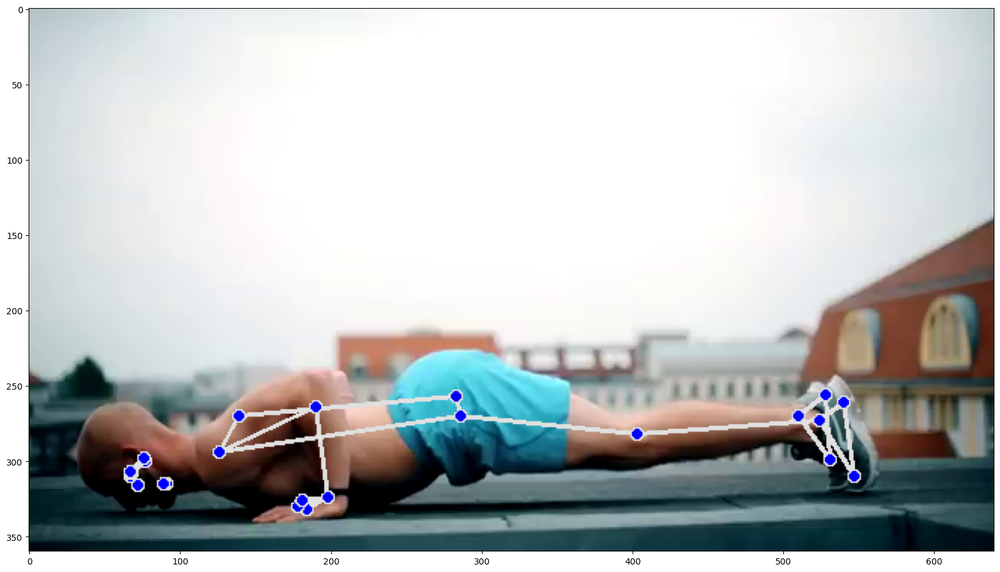

Outlier
  sample path =     fitness_poses_images_out/pushups/frame_1998_push_up.png
  sample class =    pushups
  detected class =  ['pushdowns']
  all classes =     {'pushdowns': 9, 'pushups': 1}


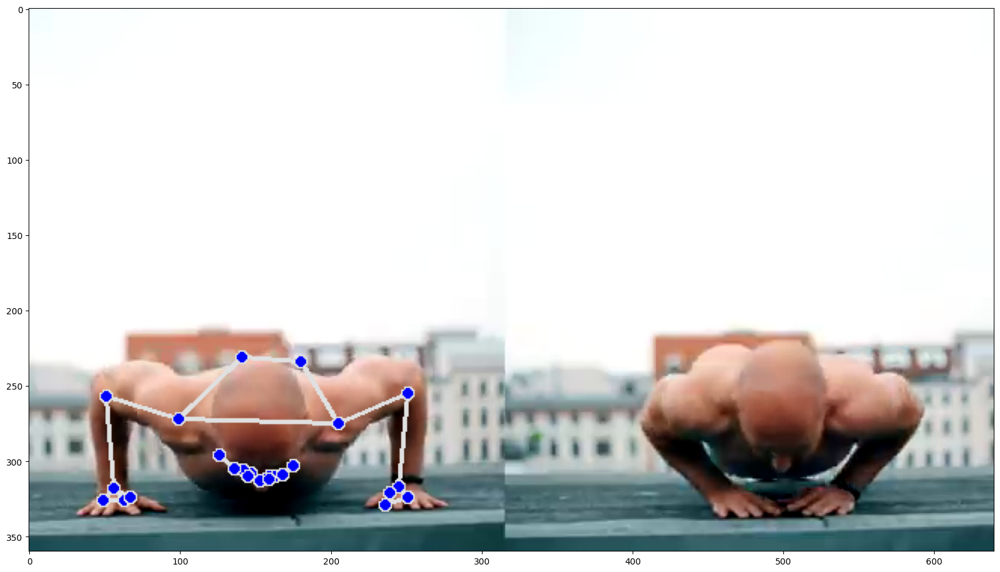

Outlier
  sample path =     fitness_poses_images_out/pushups/frame_2937_push_up.png
  sample class =    pushups
  detected class =  ['pushdowns']
  all classes =     {'pushdowns': 8, 'pushups': 2}


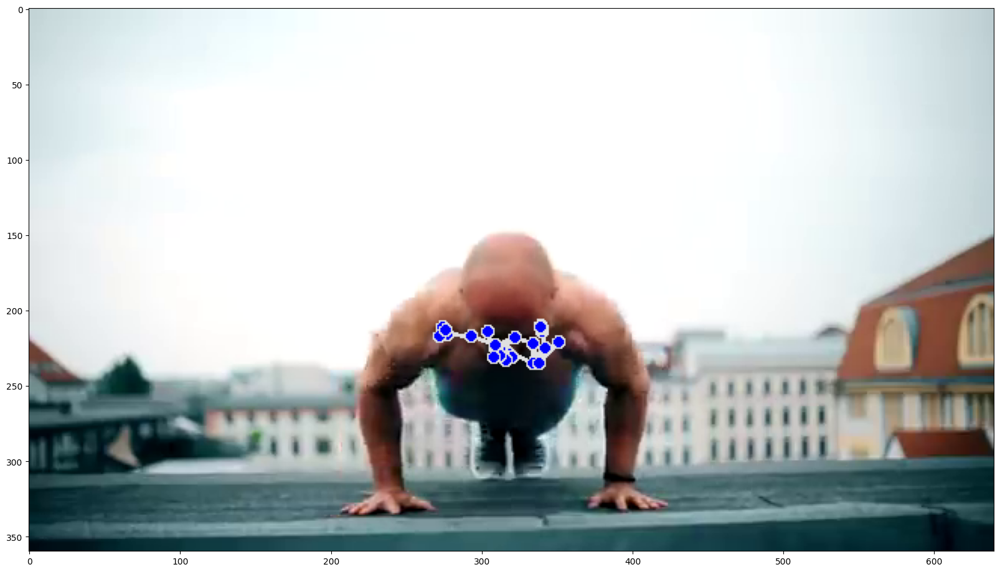

Outlier
  sample path =     fitness_poses_images_out/pushups/frame_3071_push_up.png
  sample class =    pushups
  detected class =  ['pushdowns']
  all classes =     {'pushdowns': 9, 'pushups': 1}


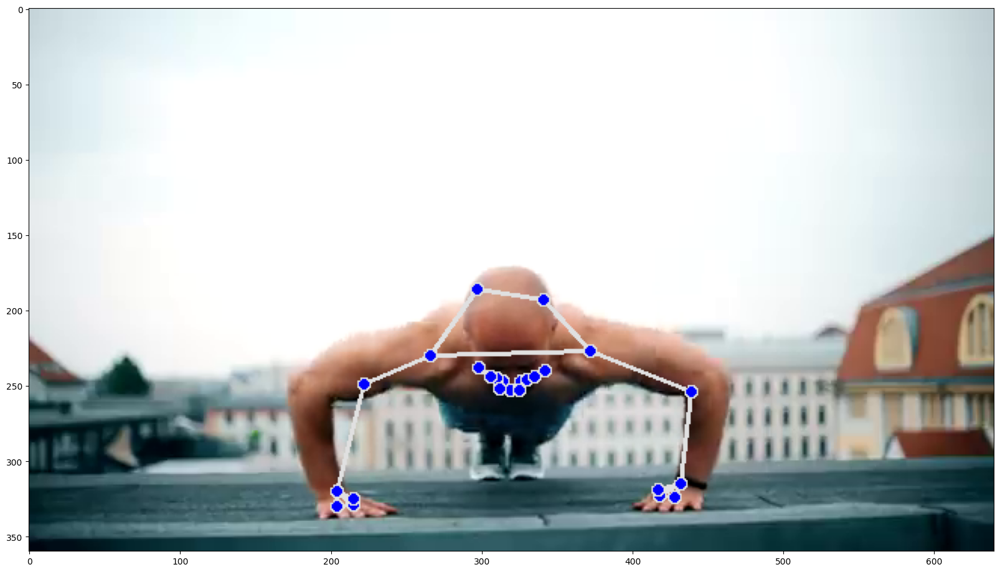

Outlier
  sample path =     fitness_poses_images_out/pushups/frame_3830_push_up.png
  sample class =    pushups
  detected class =  ['pushdowns']
  all classes =     {'pushdowns': 8, 'pushups': 2}


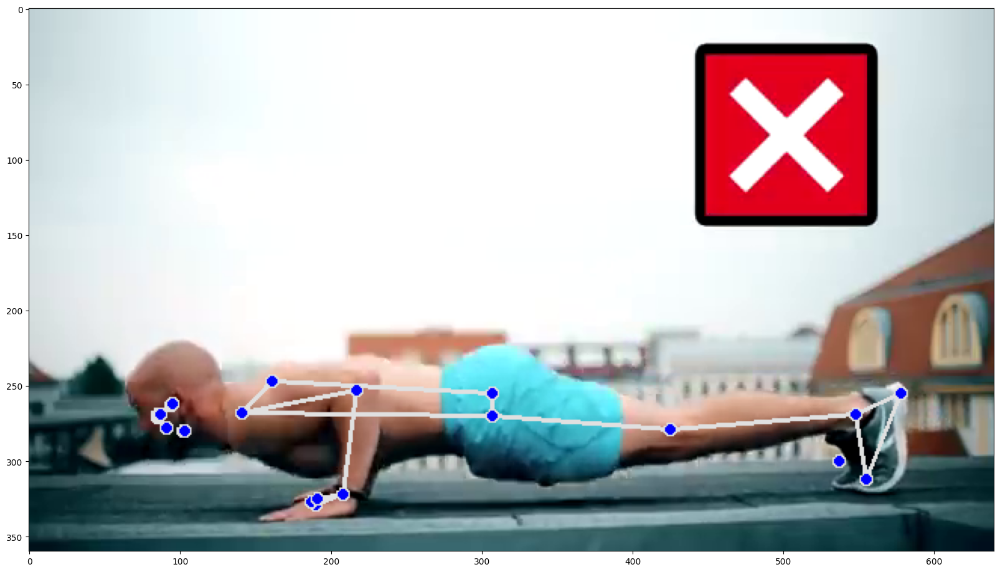

Outlier
  sample path =     fitness_poses_images_out/pushups/frame_3836_push_up.png
  sample class =    pushups
  detected class =  ['pushdowns']
  all classes =     {'pushdowns': 9, 'pushups': 1}


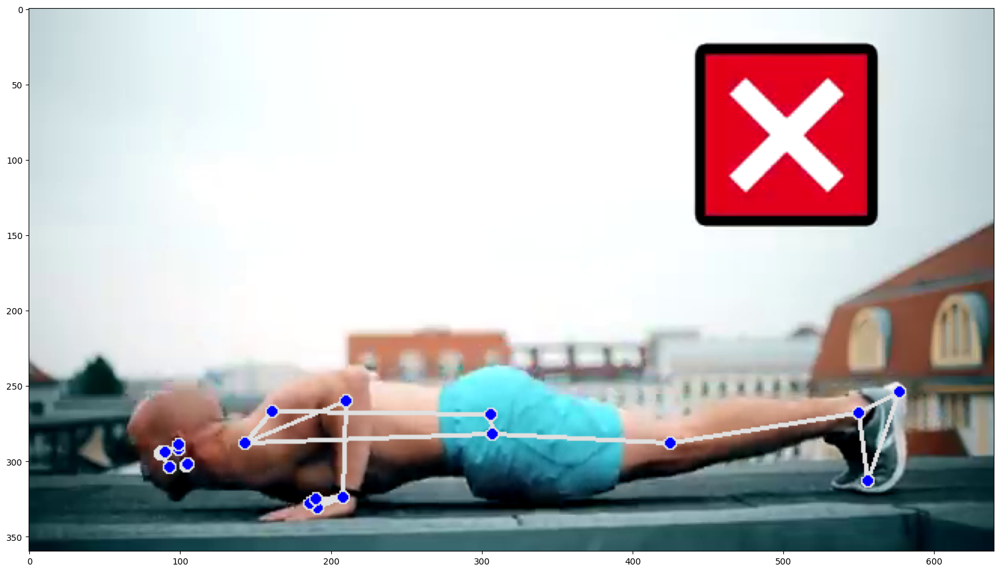

Outlier
  sample path =     fitness_poses_images_out/pushups/frame_3931_push_up.png
  sample class =    pushups
  detected class =  ['pushdowns']
  all classes =     {'pushdowns': 8, 'pushups': 2}


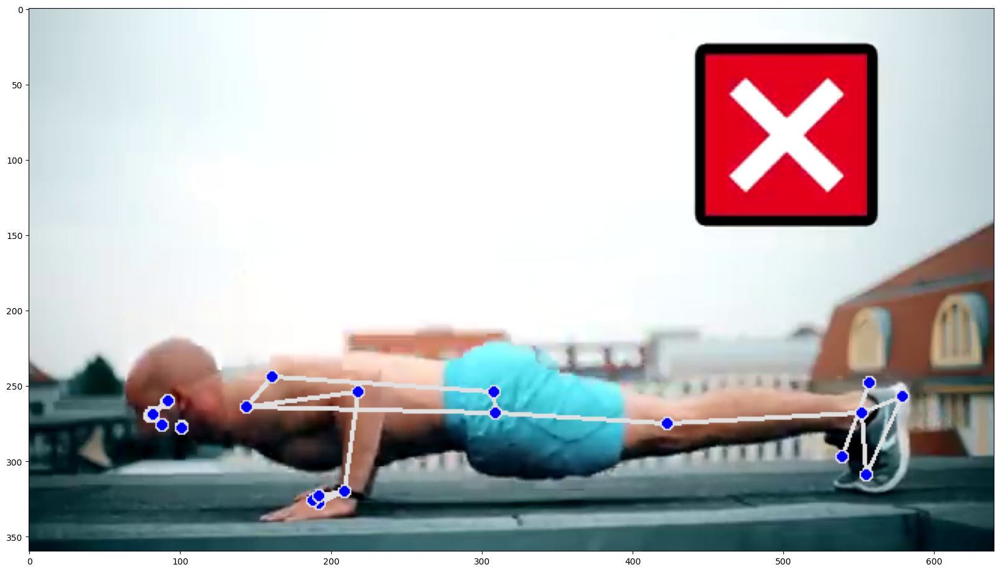

Outlier
  sample path =     fitness_poses_images_out/pushups/frame_5051_push_up.png
  sample class =    pushups
  detected class =  ['pushdowns']
  all classes =     {'pushdowns': 6, 'pushups': 4}


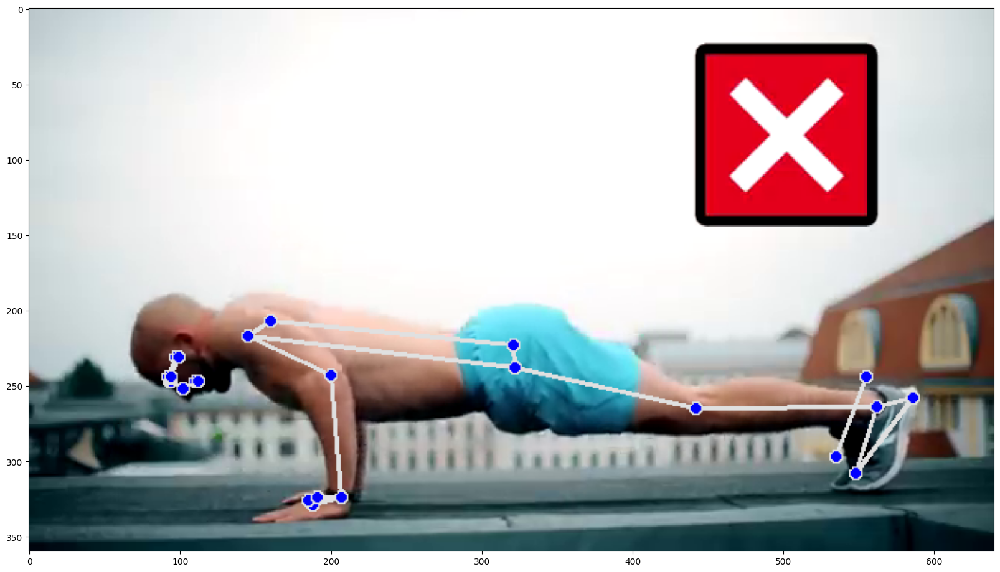

Outlier
  sample path =     fitness_poses_images_out/pushups/frame_526_push_up.png
  sample class =    pushups
  detected class =  ['pushdowns']
  all classes =     {'pushdowns': 6, 'pushups': 4}


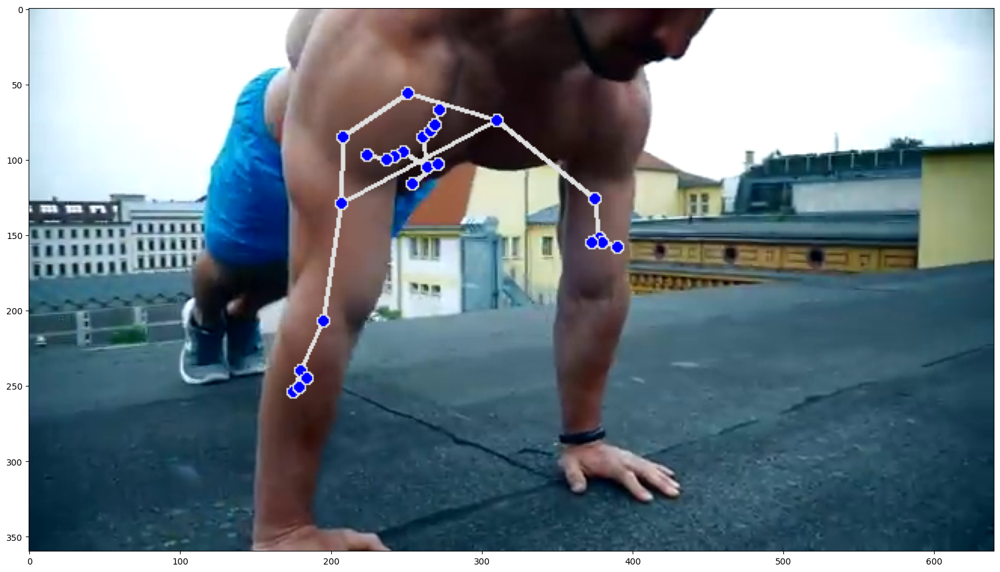

Outlier
  sample path =     fitness_poses_images_out/pushups/frame_5865_push_up.png
  sample class =    pushups
  detected class =  ['pushdowns', 'pushups']
  all classes =     {'pushdowns': 5, 'pushups': 5}


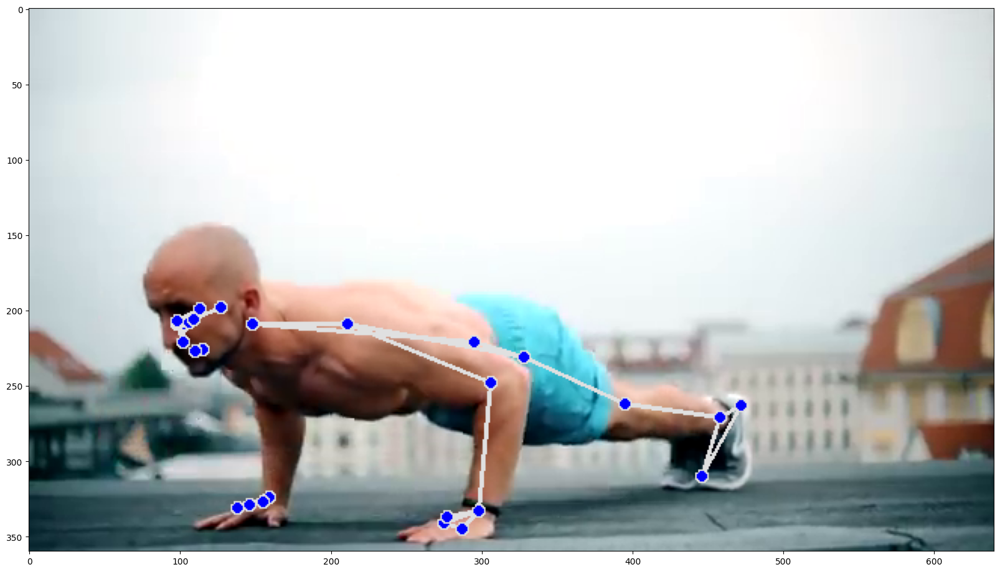

Outlier
  sample path =     fitness_poses_images_out/pushdowns/frame_1393_push_down.png
  sample class =    pushdowns
  detected class =  ['pushups']
  all classes =     {'pushdowns': 1, 'pushups': 9}


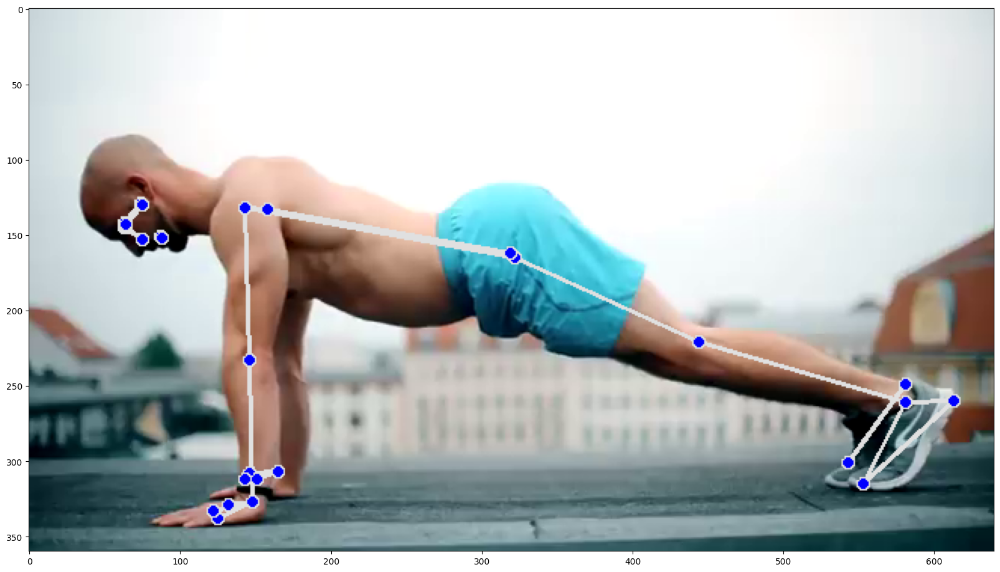

Outlier
  sample path =     fitness_poses_images_out/pushdowns/frame_1734_push_down.png
  sample class =    pushdowns
  detected class =  ['pushups']
  all classes =     {'pushdowns': 2, 'pushups': 8}


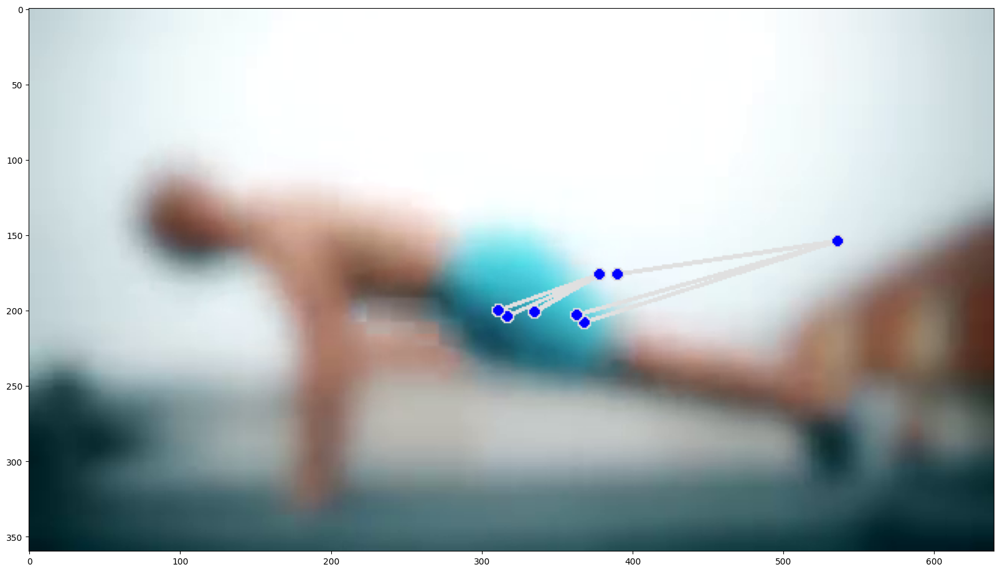

Outlier
  sample path =     fitness_poses_images_out/pushdowns/frame_2593_push_down.png
  sample class =    pushdowns
  detected class =  ['pushdowns', 'pushups']
  all classes =     {'pushdowns': 5, 'pushups': 5}


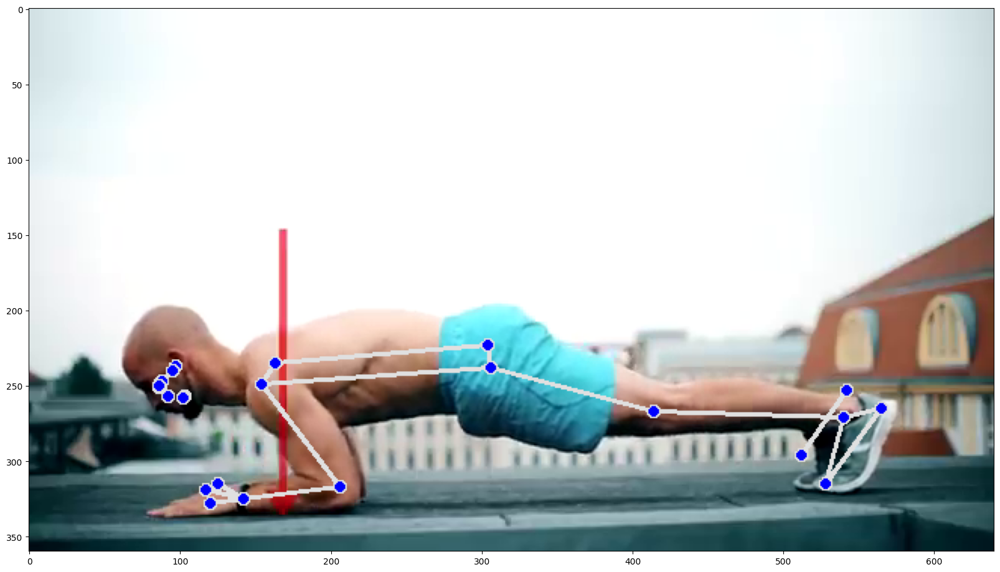

Outlier
  sample path =     fitness_poses_images_out/pushdowns/frame_2610_push_down.png
  sample class =    pushdowns
  detected class =  ['pushups']
  all classes =     {'pushdowns': 2, 'pushups': 8}


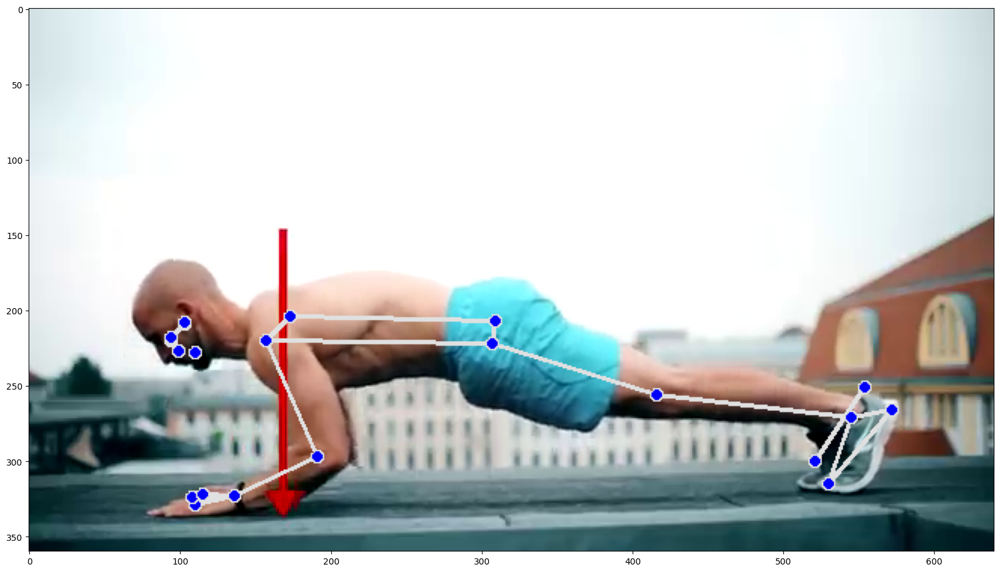

Outlier
  sample path =     fitness_poses_images_out/pushdowns/frame_2668_push_down.png
  sample class =    pushdowns
  detected class =  ['pushups']
  all classes =     {'pushdowns': 4, 'pushups': 6}


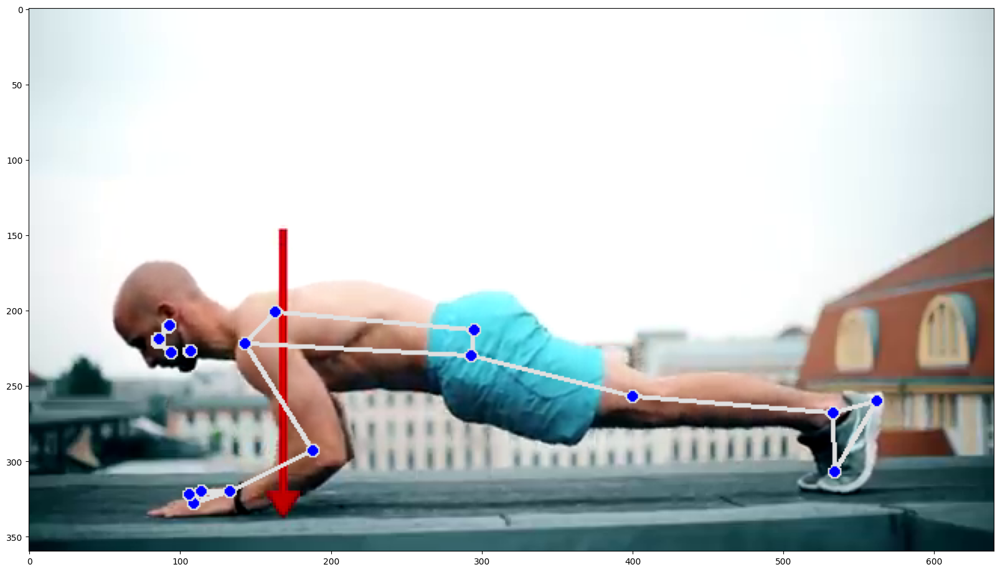

Outlier
  sample path =     fitness_poses_images_out/pushdowns/frame_2683_push_down.png
  sample class =    pushdowns
  detected class =  ['pushups']
  all classes =     {'pushdowns': 4, 'pushups': 6}


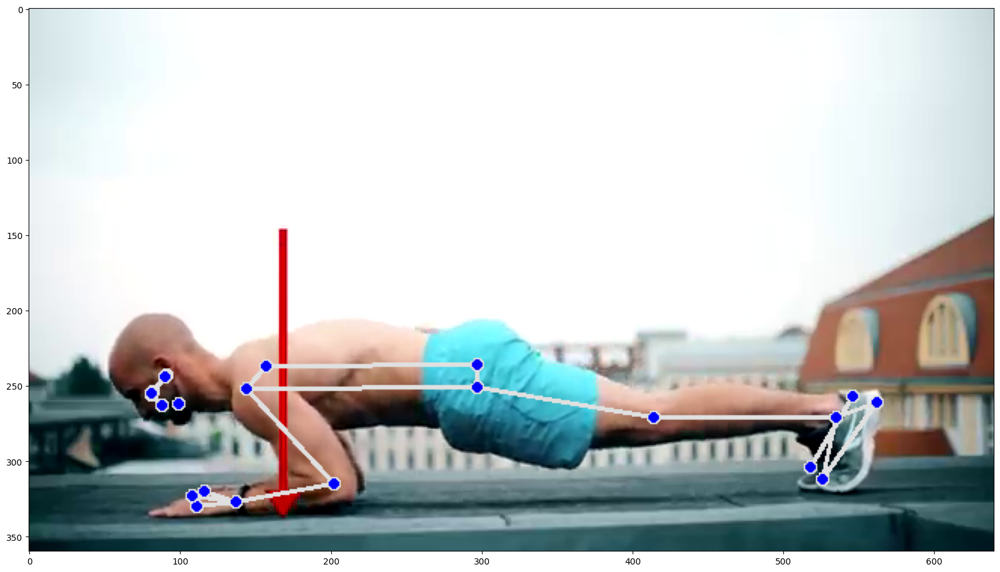

Outlier
  sample path =     fitness_poses_images_out/pushdowns/frame_2693_push_down.png
  sample class =    pushdowns
  detected class =  ['pushups']
  all classes =     {'pushdowns': 4, 'pushups': 6}


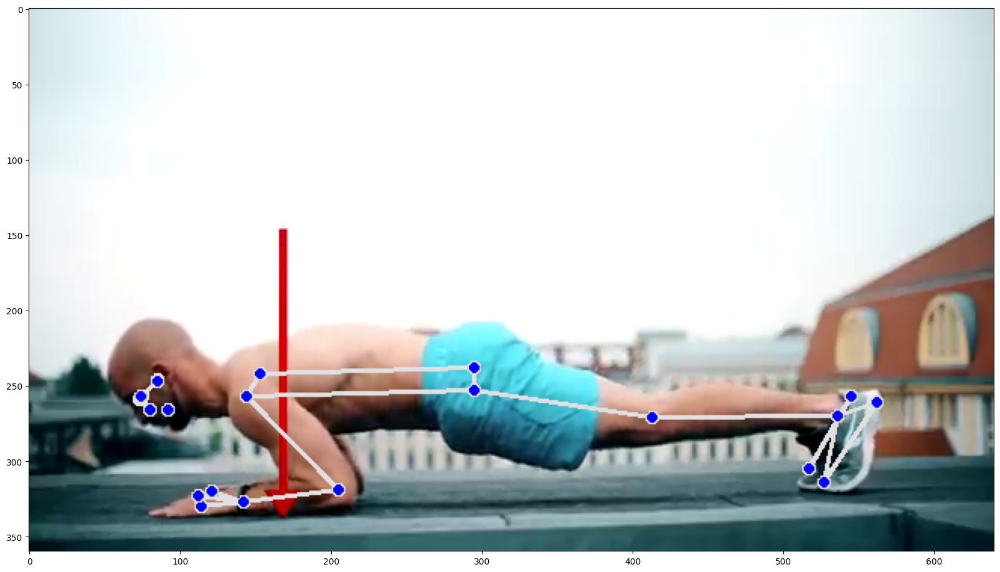

Outlier
  sample path =     fitness_poses_images_out/pushdowns/frame_2898_push_down.png
  sample class =    pushdowns
  detected class =  ['pushups']
  all classes =     {'pushdowns': 1, 'pushups': 9}


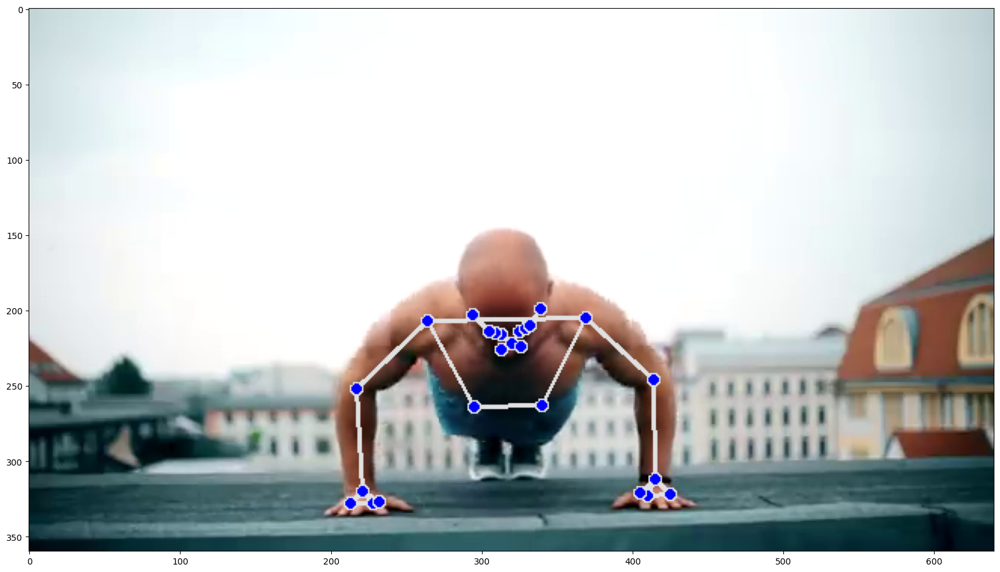

Outlier
  sample path =     fitness_poses_images_out/pushdowns/frame_4459_push_down.png
  sample class =    pushdowns
  detected class =  ['pushups']
  all classes =     {'pushdowns': 3, 'pushups': 7}


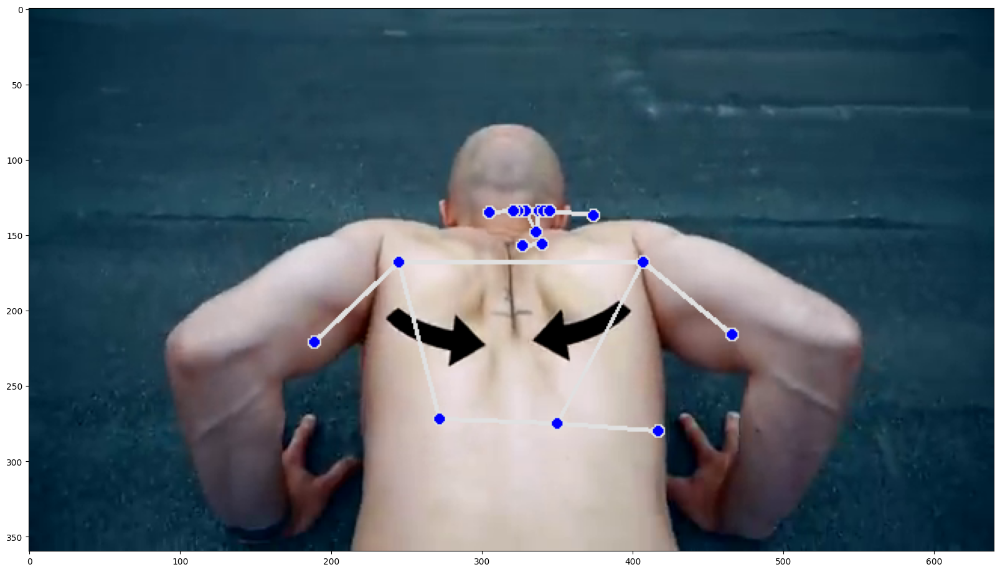

Outlier
  sample path =     fitness_poses_images_out/pushdowns/frame_4465_push_down.png
  sample class =    pushdowns
  detected class =  ['pushups']
  all classes =     {'pushdowns': 3, 'pushups': 7}


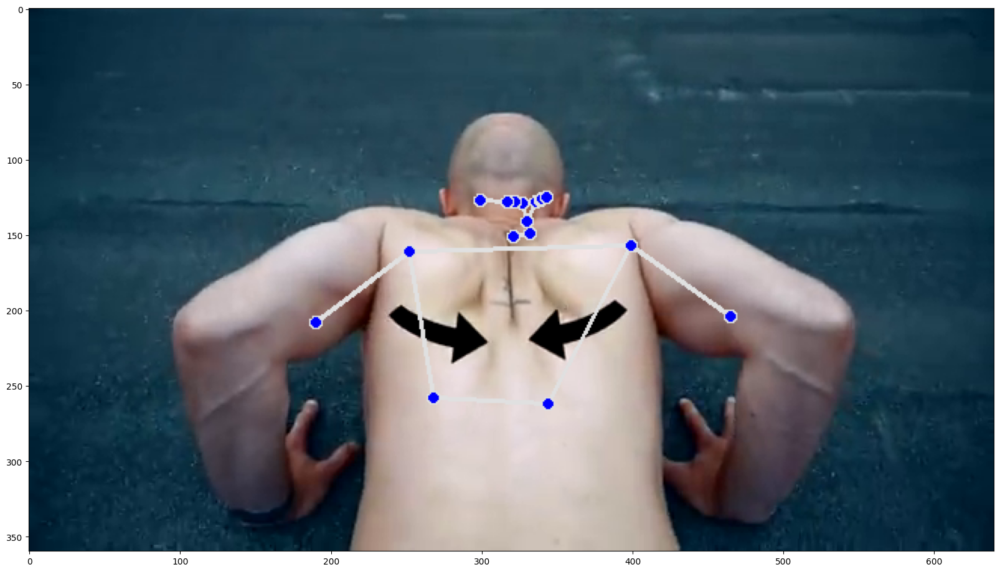

In [ ]:
# Analyze outliers.
bootstrap_helper.analyze_outliers(outliers)

In [ ]:
# Remove all outliers (if you don't want to manually pick).
bootstrap_helper.remove_outliers(outliers)

In [ ]:
# Align CSVs with images after removing outliers.
bootstrap_helper.align_images_and_csvs(print_removed_items=False)
bootstrap_helper.print_images_out_statistics()

Number of images per pose class:
  pushups: 185
  pushdowns: 188


## hasil filter ke csv

hasil filter

Cek tutorial [guide](https://developers.google.com/ml-kit/vision/pose-detection/classifying-poses#4_integrate_with_the_ml_kit_quickstart_app)

In [ ]:
import csv
import os
import numpy as np


def dump_for_the_app():
  pose_samples_folder = 'fitness_poses_csvs_out'
  pose_samples_csv_path = 'fitness_poses_csvs_out.csv'
  file_extension = 'csv'
  file_separator = ','

  # Each file in the folder represents one pose class.
  file_names = [name for name in os.listdir(pose_samples_folder) if name.endswith(file_extension)]

  with open(pose_samples_csv_path, 'w') as csv_out:
    csv_out_writer = csv.writer(csv_out, delimiter=file_separator, quoting=csv.QUOTE_MINIMAL)
    for file_name in file_names:
      # Use file name as pose class name.
      class_name = file_name[:-(len(file_extension) + 1)]

      # One file line: `sample_00001,x1,y1,x2,y2,....`.
      with open(os.path.join(pose_samples_folder, file_name)) as csv_in:
        csv_in_reader = csv.reader(csv_in, delimiter=file_separator)
        for row in csv_in_reader:
          row.insert(1, class_name)
          csv_out_writer.writerow(row)

  files.download(pose_samples_csv_path)


dump_for_the_app()

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Hasil klasifikasi  {'pushdowns': 6, 'pushups': 4}


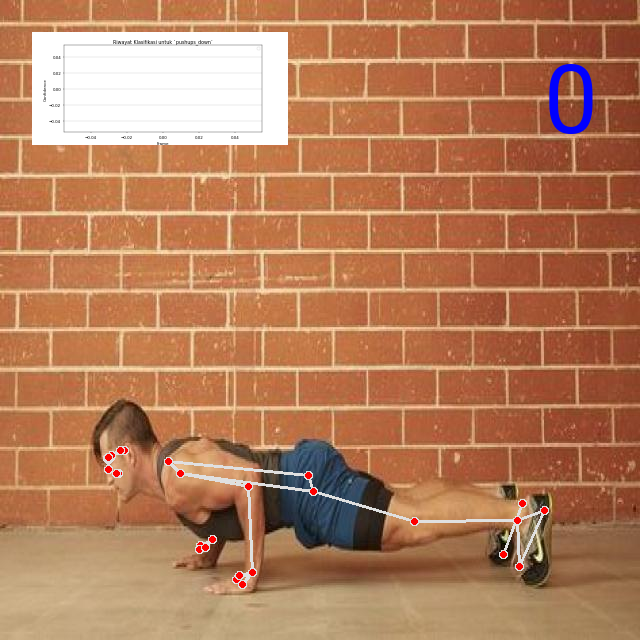

In [ ]:
# Import dependencies
import cv2
import numpy as np
from mediapipe.python.solutions import pose as mp_pose
from mediapipe.python.solutions import drawing_utils as mp_drawing

# Nama file gambar
image_path = 'testing.jpg'
class_name = 'pushups_down'

# Folder CSV kelas pose (sama seperti saat melatih classifier)
pose_samples_folder = 'fitness_poses_csvs_out'

# Inisialisasi tracker, embedder, classifier, dan filter.
pose_tracker = mp_pose.Pose()
pose_embedder = FullBodyPoseEmbedder()
pose_classifier = PoseClassifier(
    pose_samples_folder=pose_samples_folder,
    pose_embedder=pose_embedder,
    top_n_by_max_distance=30,
    top_n_by_mean_distance=10
)
pose_classification_filter = EMADictSmoothing(window_size=10, alpha=0.2)
repetition_counter = RepetitionCounter(
    class_name=class_name,
    enter_threshold=6,
    exit_threshold=4
)
pose_classification_visualizer = PoseClassificationVisualizer(
    class_name=class_name,
    plot_x_max=1,  # Hanya untuk satu gambar
    plot_y_max=10
)

# Baca gambar input
input_frame = cv2.imread(image_path)
if input_frame is None:
    raise ValueError(f"Gambar tidak ditemukan di {image_path}")

# Proses gambar untuk mendeteksi pose
input_frame_rgb = cv2.cvtColor(input_frame, cv2.COLOR_BGR2RGB)
result = pose_tracker.process(image=input_frame_rgb)
pose_landmarks = result.pose_landmarks

# Visualisasi hasil deteksi pose
output_frame = input_frame.copy()
if pose_landmarks is not None:
    mp_drawing.draw_landmarks(
        image=output_frame,
        landmark_list=pose_landmarks,
        connections=mp_pose.POSE_CONNECTIONS
    )

    # Konversi landmark ke array
    frame_height, frame_width = output_frame.shape[:2]
    pose_landmarks_array = np.array([
        [lmk.x * frame_width, lmk.y * frame_height, lmk.z * frame_width]
        for lmk in pose_landmarks.landmark
    ], dtype=np.float32)

    # Klasifikasi pose
    pose_classification = pose_classifier(pose_landmarks_array)

    # Smoothing klasifikasi
    pose_classification_filtered = pose_classification_filter(pose_classification)

    # Hitung repetisi
    repetitions_count = repetition_counter(pose_classification_filtered)

    # Tambahkan visualisasi klasifikasi dan repetisi
    output_frame = pose_classification_visualizer(
        frame=output_frame,
        pose_classification=pose_classification,
        pose_classification_filtered=pose_classification_filtered,
        repetitions_count=repetitions_count
    )
else:
    print("Tidak ada pose terdeteksi pada gambar.")

# Simpan hasil visualisasi
output_image_path = 'image.jpg'
cv2.imwrite(output_image_path, output_frame)
print(f"Hasil klasifikasi  {pose_classification}")

# Tampilkan gambar hasil
from google.colab.patches import cv2_imshow

# Tampilkan gambar hasil di notebook
cv2_imshow(output_frame)

# Release resources
pose_tracker.close()


# Step 2: Classification

**Important!!** gunakan classification parameter yang sama

In [ ]:
# Upload your video.
uploaded = files.upload()
os.listdir('.')

Saving pushup.mp4 to pushup.mp4


['.config',
 'output_images1',
 'fitness_poses_images_out',
 'fitness_poses_csvs_out',
 'fitness_poses_csvs_out.csv',
 'pushup.mp4',
 'output_images1.zip',
 'sample_data']

In [ ]:
# Specify nama video
video_path = 'pushup.mp4'
class_name='pushups_down'
out_video_path = 'pushups-sample-out.mp4'

In [ ]:
# Open video
import cv2

video_cap = cv2.VideoCapture(video_path)

#inisialisasi video parameter
video_n_frames = video_cap.get(cv2.CAP_PROP_FRAME_COUNT)
video_fps = video_cap.get(cv2.CAP_PROP_FPS)
video_width = int(video_cap.get(cv2.CAP_PROP_FRAME_WIDTH))
video_height = int(video_cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

In [ ]:
# Inisialisasi tracker, embedder, classifier, dan counter.
# Lakukan ini sebelum memproses setiap video karena semuanya memiliki state.

from mediapipe.python.solutions import pose as mp_pose

# Folder yang berisi CSV kelas pose. Ini harus sama dengan folder yang digunakan saat
# membangun classifier untuk output CSV.
pose_samples_folder = 'fitness_poses_csvs_out'

# Inisialisasi pose tracker dari MediaPipe.
pose_tracker = mp_pose.Pose()

# Inisialisasi embedder untuk ekstraksi fitur pose tubuh penuh.
pose_embedder = FullBodyPoseEmbedder()

# Inisialisasi pose classifier.
# Pastikan kamu menggunakan parameter yang sama seperti saat bootstrapping.
pose_classifier = PoseClassifier(
    pose_samples_folder=pose_samples_folder,
    pose_embedder=pose_embedder,
    top_n_by_max_distance=30,  # Jumlah sampel teratas berdasarkan jarak maksimal
    top_n_by_mean_distance=10  # Jumlah sampel teratas berdasarkan jarak rata-rata
)

# # Uncomment untuk memvalidasi target pose yang digunakan oleh classifier dan menemukan outliers.
# outliers = pose_classifier.find_pose_sample_outliers()
# print('Jumlah pose sample outliers (pertimbangkan untuk menghapusnya): ', len(outliers))

# Inisialisasi filter untuk klasifikasi pose menggunakan EMA (Exponential Moving Average).
pose_classification_filter = EMADictSmoothing(
    window_size=10,  # Ukuran window untuk smoothing
    alpha=0.2  # Faktor smoothing
)

# Inisialisasi penghitung repetisi untuk menghitung jumlah repetisi gerakan.
repetition_counter = RepetitionCounter(
    class_name=class_name,
    enter_threshold=6,  # Ambang batas saat gerakan terdeteksi sebagai masuk
    exit_threshold=4   # Ambang batas saat gerakan terdeteksi sebagai keluar
)

# Inisialisasi renderer untuk visualisasi klasifikasi pose.
pose_classification_visualizer = PoseClassificationVisualizer(
    class_name=class_name,
    plot_x_max=video_n_frames,  # Jumlah frame video untuk plot
    plot_y_max=10  # Grafik akan lebih baik jika ini sama dengan `top_n_by_mean_distance`
)


  0%|          | 0/6510.0 [00:00<?, ?it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.


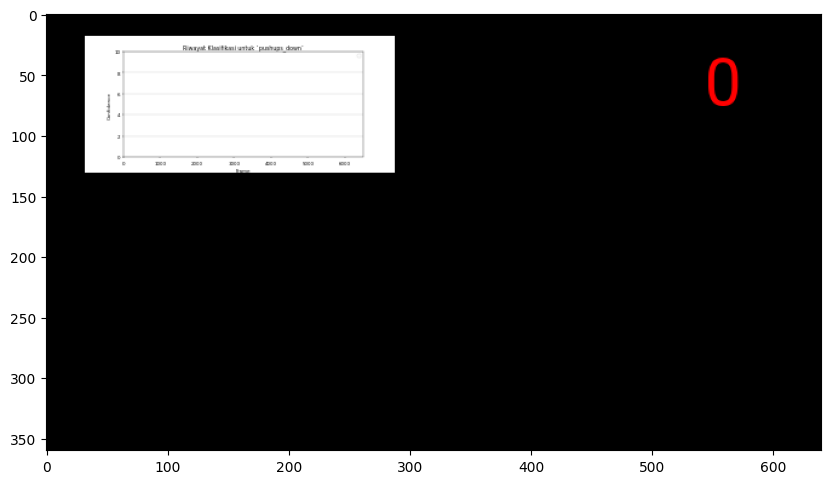

  0%|          | 1/6510.0 [00:00<1:43:25,  1.05it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  0%|          | 2/6510.0 [00:01<49:23,  2.20it/s]  WARNING:matplotlib.legend:No handles with labels found to put in legend.
  0%|          | 3/6510.0 [00:01<32:01,  3.39it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  0%|          | 4/6510.0 [00:01<23:42,  4.57it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  0%|          | 5/6510.0 [00:01<19:19,  5.61it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  0%|          | 6/6510.0 [00:01<16:28,  6.58it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  0%|          | 7/6510.0 [00:01<15:06,  7.17it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  0%|          | 8/6510.0 [00:01<14:24,  7.52it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  0%|       

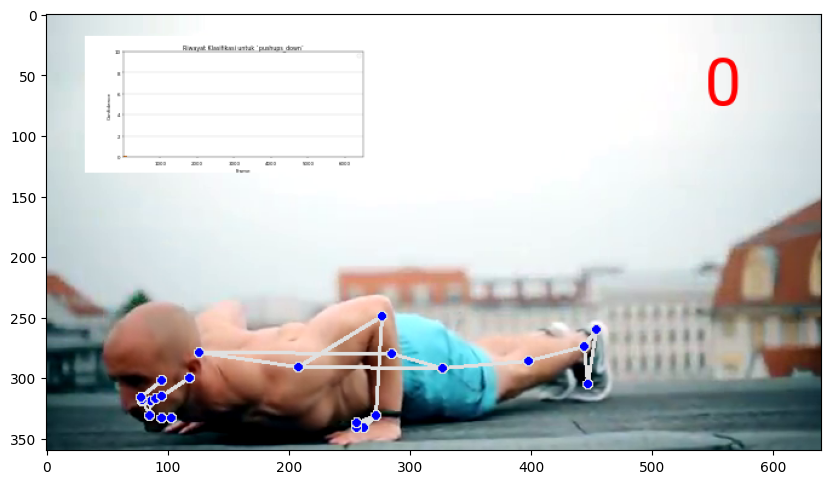

  1%|          | 51/6510.0 [00:07<21:27,  5.02it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  1%|          | 52/6510.0 [00:07<19:37,  5.49it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  1%|          | 53/6510.0 [00:07<18:20,  5.87it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  1%|          | 54/6510.0 [00:07<16:44,  6.43it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  1%|          | 55/6510.0 [00:08<15:44,  6.83it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  1%|          | 56/6510.0 [00:08<14:53,  7.22it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  1%|          | 57/6510.0 [00:08<14:21,  7.49it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  1%|          | 58/6510.0 [00:08<13:59,  7.69it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  1%|   

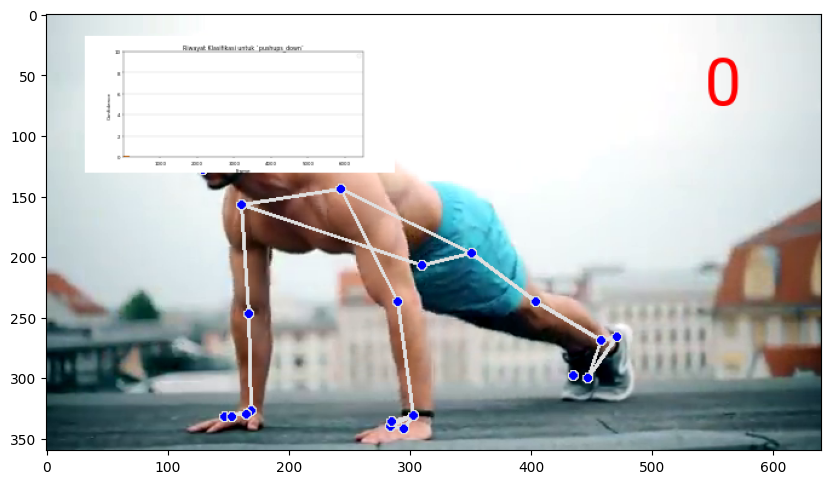

  2%|▏         | 101/6510.0 [00:15<22:44,  4.70it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  2%|▏         | 102/6510.0 [00:15<21:37,  4.94it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  2%|▏         | 103/6510.0 [00:15<19:16,  5.54it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  2%|▏         | 104/6510.0 [00:15<17:34,  6.08it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  2%|▏         | 105/6510.0 [00:16<16:44,  6.37it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  2%|▏         | 106/6510.0 [00:16<16:00,  6.67it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  2%|▏         | 107/6510.0 [00:16<15:20,  6.95it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  2%|▏         | 108/6510.0 [00:16<14:48,  7.21it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.


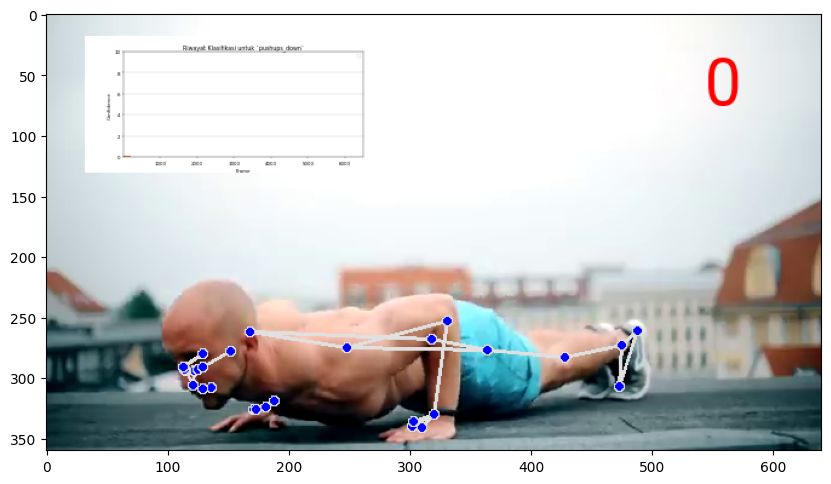

  2%|▏         | 151/6510.0 [00:22<27:39,  3.83it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  2%|▏         | 152/6510.0 [00:23<25:43,  4.12it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  2%|▏         | 153/6510.0 [00:23<23:42,  4.47it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  2%|▏         | 154/6510.0 [00:23<22:36,  4.68it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  2%|▏         | 155/6510.0 [00:23<21:56,  4.83it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  2%|▏         | 156/6510.0 [00:23<21:20,  4.96it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  2%|▏         | 157/6510.0 [00:24<20:18,  5.22it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  2%|▏         | 158/6510.0 [00:24<20:33,  5.15it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.


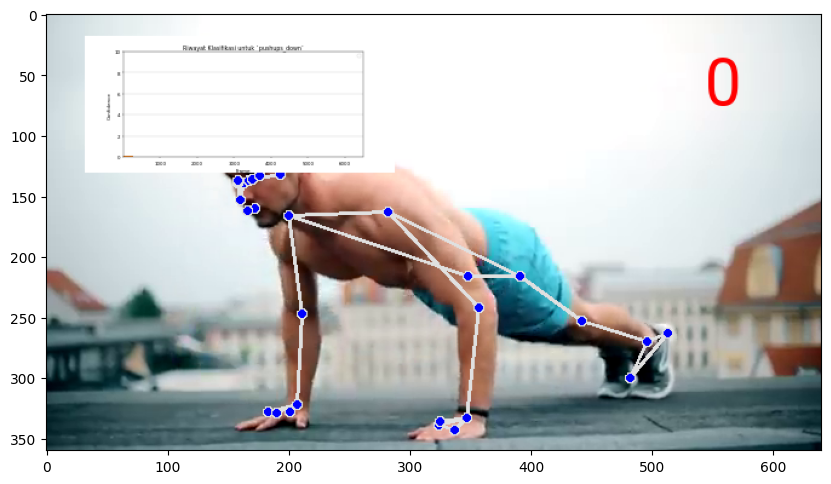

  3%|▎         | 201/6510.0 [00:31<22:27,  4.68it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  3%|▎         | 202/6510.0 [00:31<20:55,  5.02it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  3%|▎         | 203/6510.0 [00:31<18:51,  5.57it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  3%|▎         | 204/6510.0 [00:31<17:51,  5.89it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  3%|▎         | 205/6510.0 [00:31<17:06,  6.14it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  3%|▎         | 206/6510.0 [00:31<16:05,  6.53it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  3%|▎         | 207/6510.0 [00:32<15:29,  6.78it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  3%|▎         | 208/6510.0 [00:32<15:09,  6.93it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.


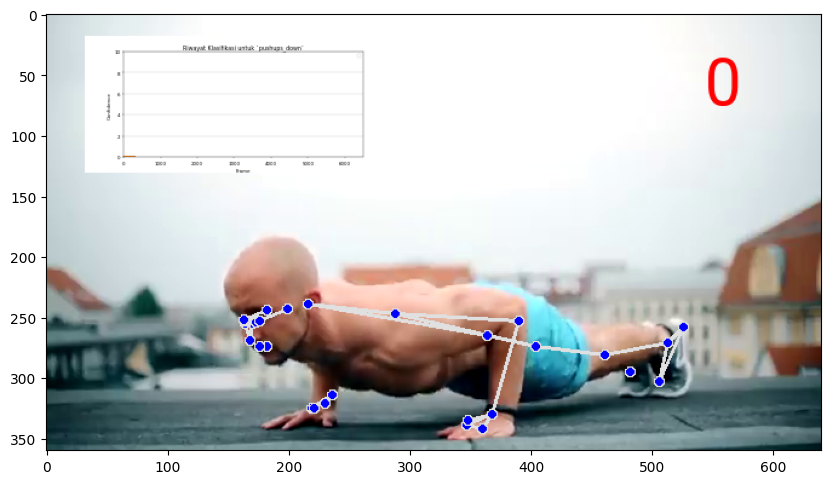

  4%|▍         | 251/6510.0 [00:40<39:26,  2.65it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  4%|▍         | 252/6510.0 [00:40<33:00,  3.16it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  4%|▍         | 253/6510.0 [00:40<27:30,  3.79it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  4%|▍         | 254/6510.0 [00:40<23:46,  4.38it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  4%|▍         | 255/6510.0 [00:40<21:10,  4.93it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  4%|▍         | 256/6510.0 [00:40<19:04,  5.46it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  4%|▍         | 257/6510.0 [00:40<17:38,  5.91it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  4%|▍         | 258/6510.0 [00:41<17:09,  6.07it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.


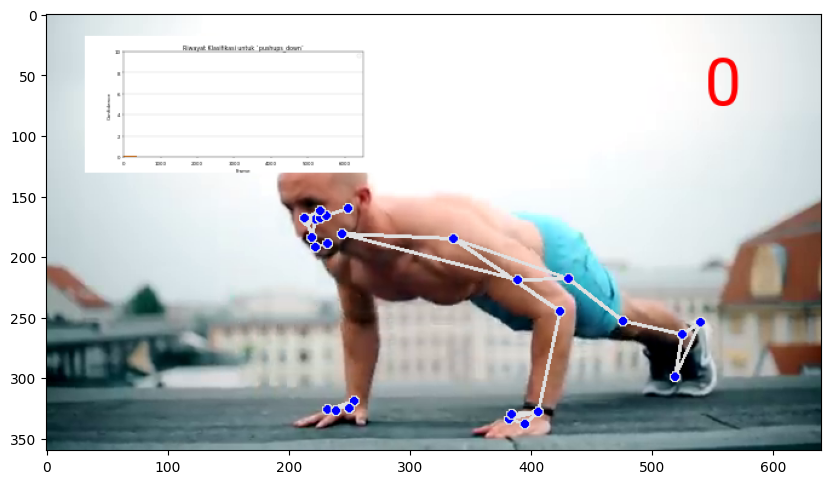

  5%|▍         | 301/6510.0 [00:47<34:20,  3.01it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  5%|▍         | 302/6510.0 [00:48<29:48,  3.47it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  5%|▍         | 303/6510.0 [00:48<25:27,  4.06it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  5%|▍         | 304/6510.0 [00:48<22:11,  4.66it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  5%|▍         | 305/6510.0 [00:48<19:58,  5.18it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  5%|▍         | 306/6510.0 [00:48<18:44,  5.52it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  5%|▍         | 307/6510.0 [00:48<17:22,  5.95it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  5%|▍         | 308/6510.0 [00:48<16:30,  6.26it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.


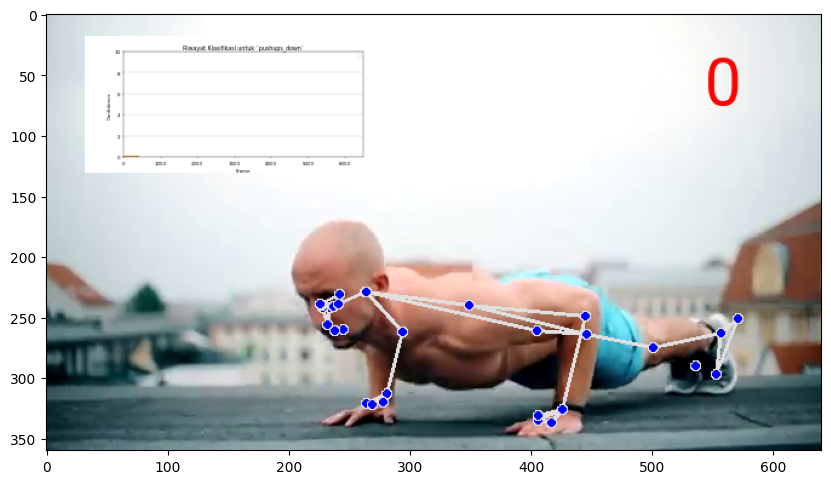

  5%|▌         | 351/6510.0 [00:57<34:05,  3.01it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  5%|▌         | 352/6510.0 [00:57<29:26,  3.49it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  5%|▌         | 353/6510.0 [00:57<25:05,  4.09it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  5%|▌         | 354/6510.0 [00:57<22:48,  4.50it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  5%|▌         | 355/6510.0 [00:57<20:22,  5.03it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  5%|▌         | 356/6510.0 [00:57<18:39,  5.50it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  5%|▌         | 357/6510.0 [00:58<17:33,  5.84it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  5%|▌         | 358/6510.0 [00:58<16:42,  6.14it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.


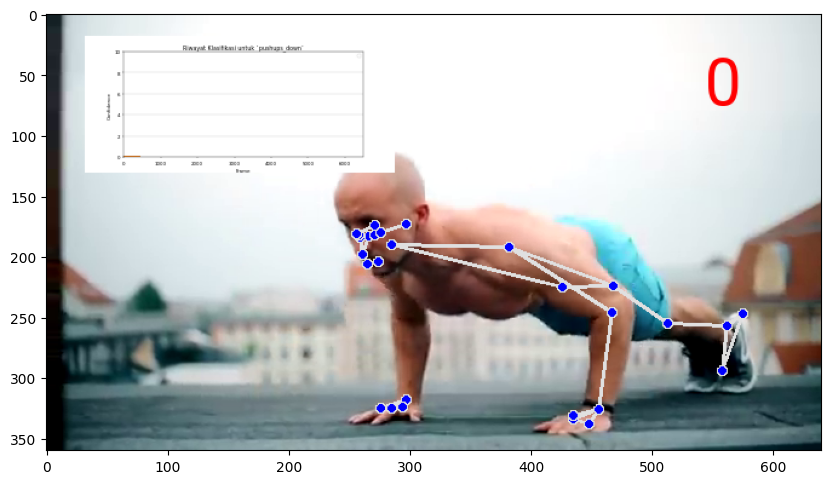

  6%|▌         | 401/6510.0 [01:05<45:24,  2.24it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  6%|▌         | 402/6510.0 [01:06<39:18,  2.59it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  6%|▌         | 403/6510.0 [01:06<34:35,  2.94it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  6%|▌         | 404/6510.0 [01:06<31:15,  3.26it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  6%|▌         | 405/6510.0 [01:06<28:45,  3.54it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  6%|▌         | 406/6510.0 [01:07<27:05,  3.76it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  6%|▋         | 407/6510.0 [01:07<25:38,  3.97it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  6%|▋         | 408/6510.0 [01:07<24:17,  4.19it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.


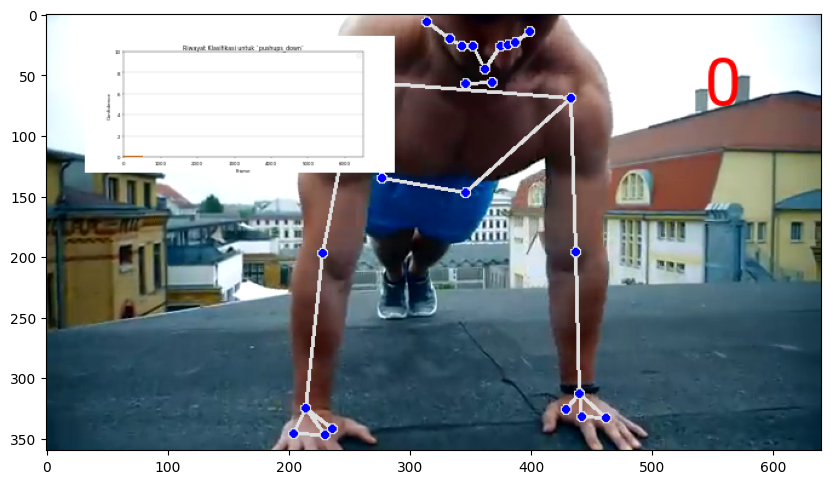

  7%|▋         | 451/6510.0 [01:14<34:41,  2.91it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  7%|▋         | 452/6510.0 [01:14<30:01,  3.36it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  7%|▋         | 453/6510.0 [01:15<26:46,  3.77it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  7%|▋         | 454/6510.0 [01:15<23:28,  4.30it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  7%|▋         | 455/6510.0 [01:15<21:22,  4.72it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  7%|▋         | 456/6510.0 [01:15<19:43,  5.12it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  7%|▋         | 457/6510.0 [01:15<18:34,  5.43it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  7%|▋         | 458/6510.0 [01:15<17:29,  5.76it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.


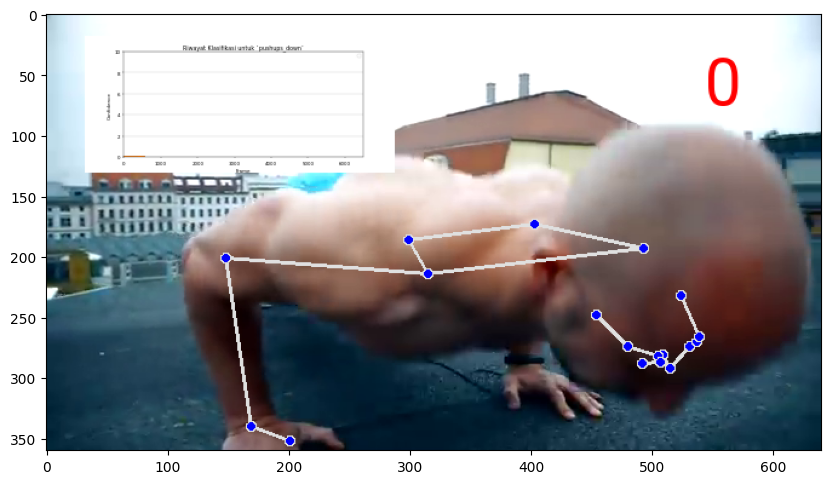

  8%|▊         | 501/6510.0 [01:24<35:40,  2.81it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  8%|▊         | 502/6510.0 [01:24<30:38,  3.27it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  8%|▊         | 503/6510.0 [01:24<26:54,  3.72it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  8%|▊         | 504/6510.0 [01:25<23:40,  4.23it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  8%|▊         | 505/6510.0 [01:25<21:09,  4.73it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  8%|▊         | 506/6510.0 [01:25<19:30,  5.13it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  8%|▊         | 507/6510.0 [01:25<18:32,  5.40it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  8%|▊         | 508/6510.0 [01:25<18:07,  5.52it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.


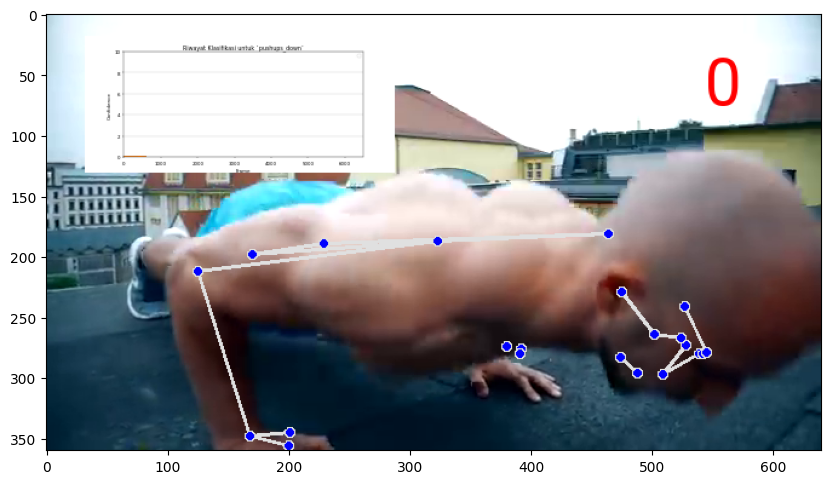

  8%|▊         | 551/6510.0 [01:33<44:35,  2.23it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  8%|▊         | 552/6510.0 [01:34<39:49,  2.49it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  8%|▊         | 553/6510.0 [01:34<35:18,  2.81it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  9%|▊         | 554/6510.0 [01:34<30:54,  3.21it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  9%|▊         | 555/6510.0 [01:34<29:01,  3.42it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  9%|▊         | 556/6510.0 [01:34<27:21,  3.63it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  9%|▊         | 557/6510.0 [01:35<26:26,  3.75it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  9%|▊         | 558/6510.0 [01:35<26:02,  3.81it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.


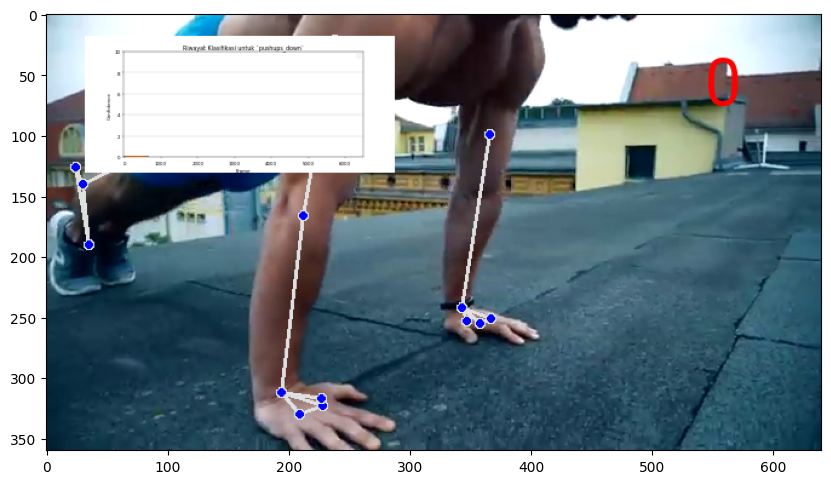

  9%|▉         | 601/6510.0 [01:43<37:46,  2.61it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  9%|▉         | 602/6510.0 [01:43<32:33,  3.02it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  9%|▉         | 603/6510.0 [01:44<28:23,  3.47it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  9%|▉         | 604/6510.0 [01:44<24:37,  4.00it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  9%|▉         | 605/6510.0 [01:44<22:05,  4.45it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  9%|▉         | 606/6510.0 [01:44<20:57,  4.70it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  9%|▉         | 607/6510.0 [01:44<19:54,  4.94it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
  9%|▉         | 608/6510.0 [01:45<19:44,  4.98it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.


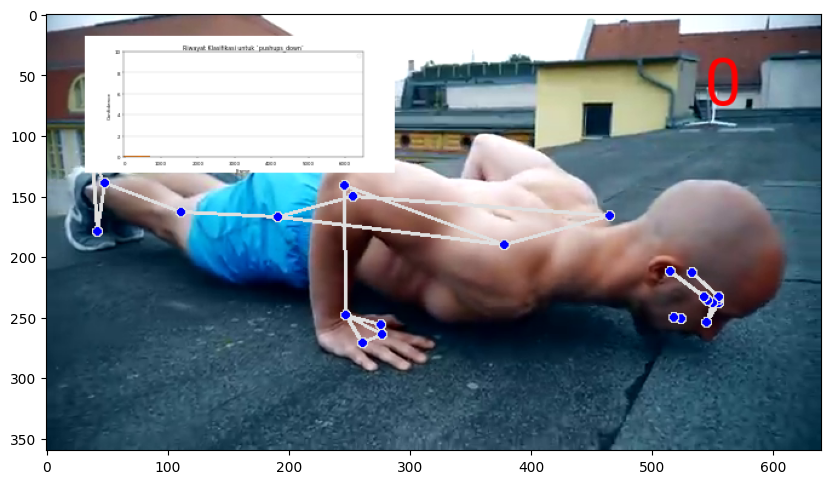

 10%|█         | 651/6510.0 [01:54<36:36,  2.67it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 10%|█         | 652/6510.0 [01:54<30:56,  3.16it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 10%|█         | 653/6510.0 [01:54<27:47,  3.51it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 10%|█         | 654/6510.0 [01:55<24:50,  3.93it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 10%|█         | 655/6510.0 [01:55<22:15,  4.38it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 10%|█         | 656/6510.0 [01:55<20:44,  4.70it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 10%|█         | 657/6510.0 [01:55<19:33,  4.99it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 10%|█         | 658/6510.0 [01:55<19:04,  5.12it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.


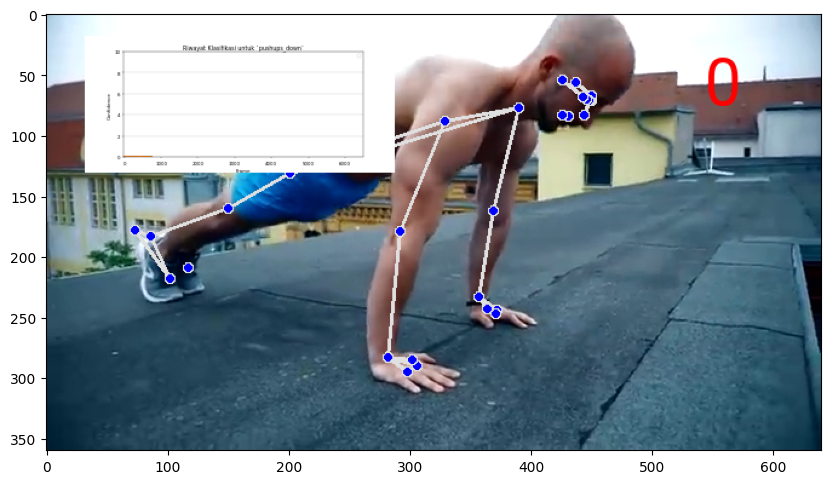

 11%|█         | 701/6510.0 [02:04<46:11,  2.10it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 11%|█         | 702/6510.0 [02:04<40:02,  2.42it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 11%|█         | 703/6510.0 [02:05<35:46,  2.70it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 11%|█         | 704/6510.0 [02:05<33:07,  2.92it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 11%|█         | 705/6510.0 [02:05<31:44,  3.05it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 11%|█         | 706/6510.0 [02:05<29:56,  3.23it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 11%|█         | 707/6510.0 [02:06<28:29,  3.40it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 11%|█         | 708/6510.0 [02:06<25:35,  3.78it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.


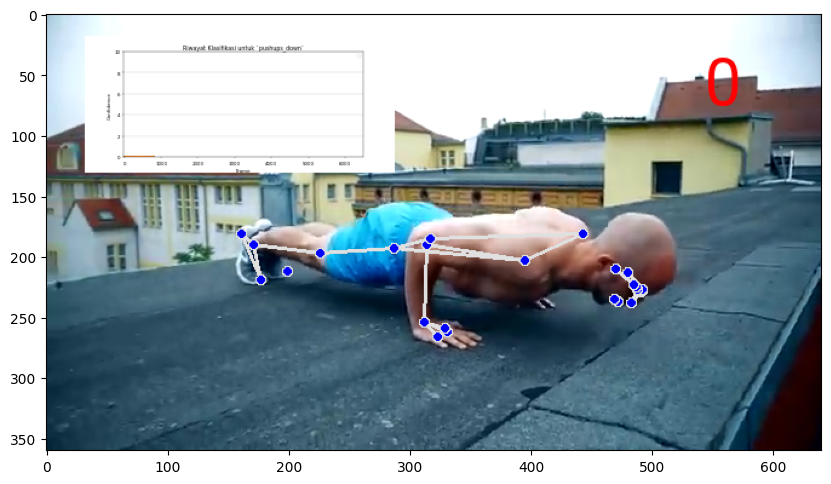

 12%|█▏        | 751/6510.0 [02:14<36:07,  2.66it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 12%|█▏        | 752/6510.0 [02:15<30:33,  3.14it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 12%|█▏        | 753/6510.0 [02:15<27:12,  3.53it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 12%|█▏        | 754/6510.0 [02:15<24:36,  3.90it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 12%|█▏        | 755/6510.0 [02:15<22:55,  4.18it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 12%|█▏        | 756/6510.0 [02:15<21:18,  4.50it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 12%|█▏        | 757/6510.0 [02:15<20:10,  4.75it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 12%|█▏        | 758/6510.0 [02:16<19:28,  4.92it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.


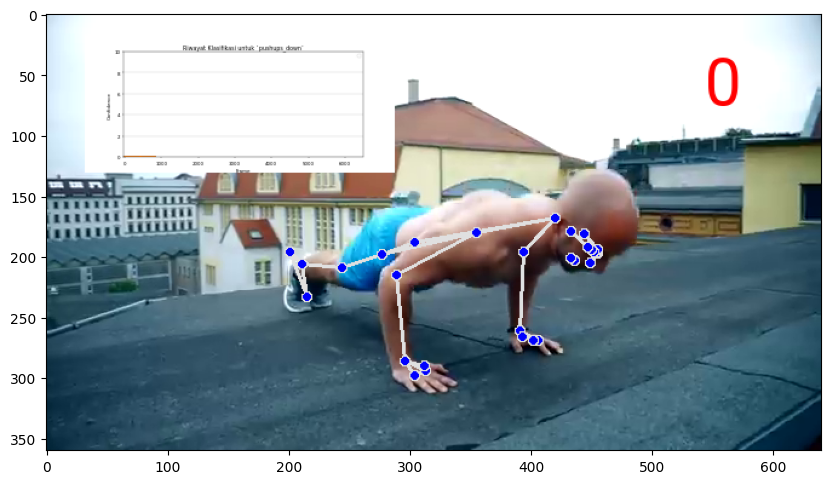

 12%|█▏        | 801/6510.0 [02:25<38:39,  2.46it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 12%|█▏        | 802/6510.0 [02:26<32:39,  2.91it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 12%|█▏        | 803/6510.0 [02:26<27:51,  3.42it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 12%|█▏        | 804/6510.0 [02:26<24:32,  3.87it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 12%|█▏        | 805/6510.0 [02:26<23:05,  4.12it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 12%|█▏        | 806/6510.0 [02:26<21:40,  4.39it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 12%|█▏        | 807/6510.0 [02:27<20:39,  4.60it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 12%|█▏        | 808/6510.0 [02:27<19:36,  4.85it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.


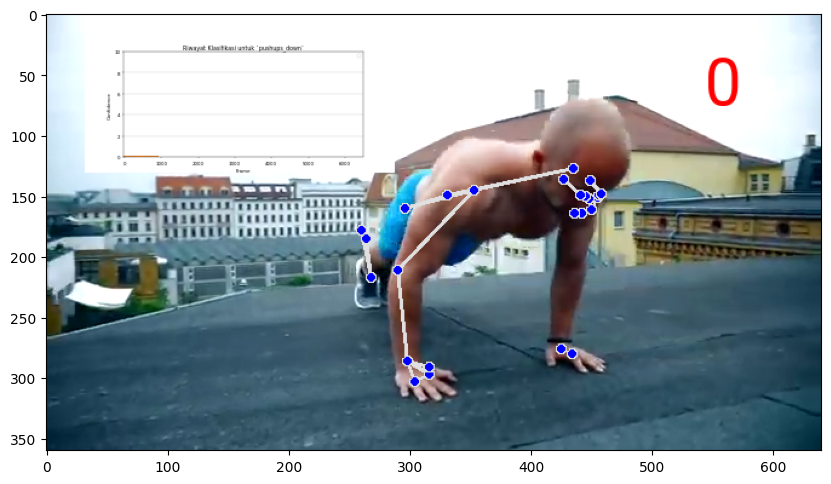

 13%|█▎        | 851/6510.0 [02:37<50:36,  1.86it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 13%|█▎        | 852/6510.0 [02:37<43:11,  2.18it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 13%|█▎        | 853/6510.0 [02:37<35:45,  2.64it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 13%|█▎        | 854/6510.0 [02:37<31:44,  2.97it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 13%|█▎        | 855/6510.0 [02:37<28:31,  3.30it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 13%|█▎        | 856/6510.0 [02:38<26:10,  3.60it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 13%|█▎        | 857/6510.0 [02:38<25:57,  3.63it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 13%|█▎        | 858/6510.0 [02:38<24:13,  3.89it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.


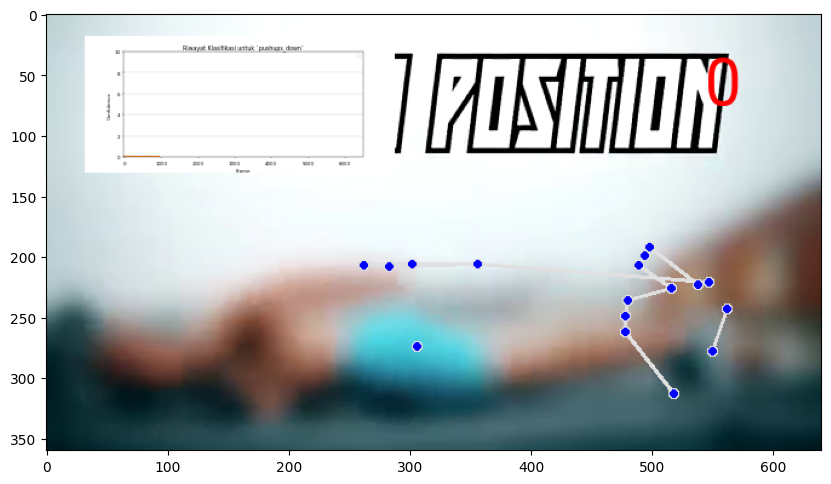

 14%|█▍        | 901/6510.0 [02:47<38:26,  2.43it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 14%|█▍        | 902/6510.0 [02:47<32:16,  2.90it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 14%|█▍        | 903/6510.0 [02:47<27:40,  3.38it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 14%|█▍        | 904/6510.0 [02:48<25:03,  3.73it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 14%|█▍        | 905/6510.0 [02:48<22:47,  4.10it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 14%|█▍        | 906/6510.0 [02:48<22:31,  4.15it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 14%|█▍        | 907/6510.0 [02:48<22:21,  4.18it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 14%|█▍        | 908/6510.0 [02:49<21:13,  4.40it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.


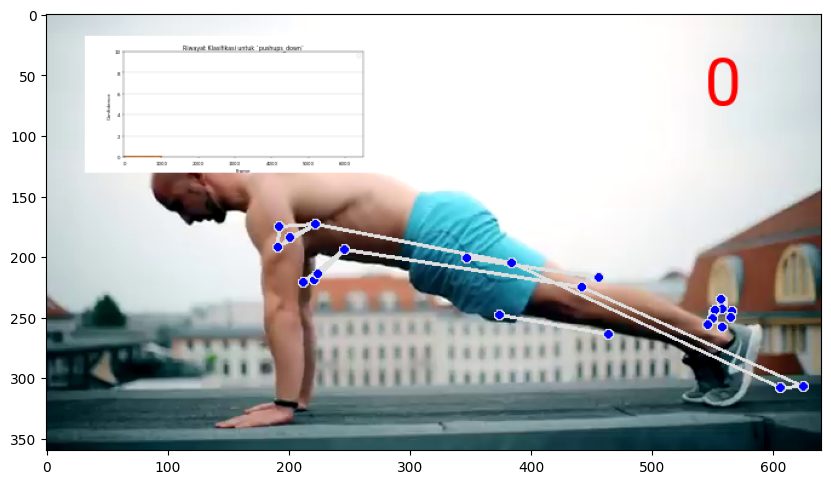

 15%|█▍        | 951/6510.0 [02:59<40:35,  2.28it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 15%|█▍        | 952/6510.0 [02:59<33:48,  2.74it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 15%|█▍        | 953/6510.0 [02:59<28:50,  3.21it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 15%|█▍        | 954/6510.0 [02:59<25:41,  3.60it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 15%|█▍        | 955/6510.0 [02:59<23:12,  3.99it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 15%|█▍        | 956/6510.0 [03:00<22:33,  4.10it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 15%|█▍        | 957/6510.0 [03:00<20:48,  4.45it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 15%|█▍        | 958/6510.0 [03:00<19:36,  4.72it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.


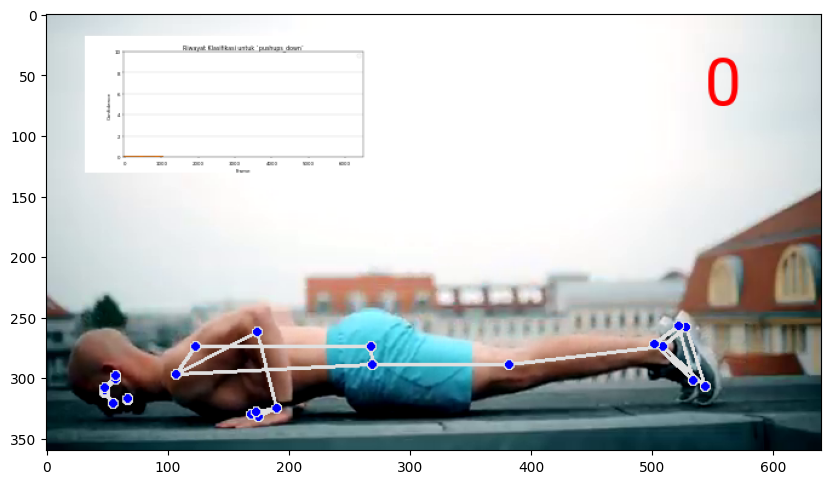

 15%|█▌        | 1001/6510.0 [03:10<45:29,  2.02it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 15%|█▌        | 1002/6510.0 [03:10<37:19,  2.46it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 15%|█▌        | 1003/6510.0 [03:10<31:11,  2.94it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 15%|█▌        | 1004/6510.0 [03:10<26:53,  3.41it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 15%|█▌        | 1005/6510.0 [03:11<24:14,  3.78it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 15%|█▌        | 1006/6510.0 [03:11<21:50,  4.20it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 15%|█▌        | 1007/6510.0 [03:11<20:50,  4.40it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 15%|█▌        | 1008/6510.0 [03:11<19:54,  4.60it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

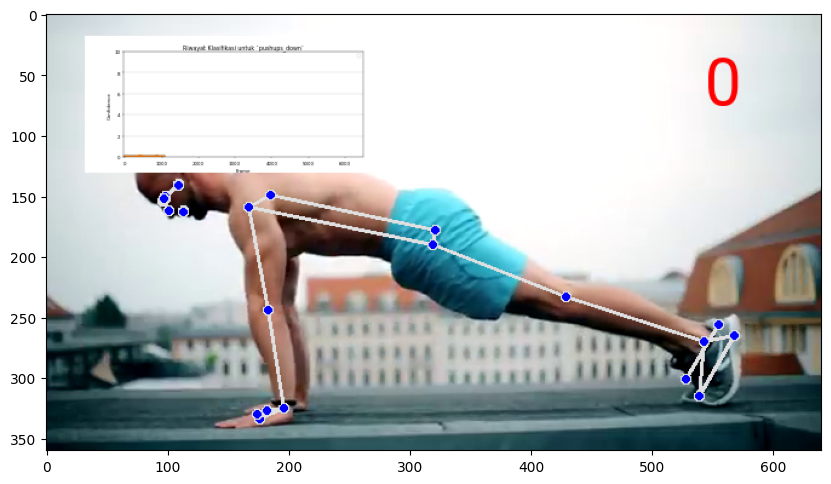

 16%|█▌        | 1051/6510.0 [03:20<44:54,  2.03it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 16%|█▌        | 1052/6510.0 [03:21<38:48,  2.34it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 16%|█▌        | 1053/6510.0 [03:21<34:19,  2.65it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 16%|█▌        | 1054/6510.0 [03:21<32:08,  2.83it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 16%|█▌        | 1055/6510.0 [03:21<29:50,  3.05it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 16%|█▌        | 1056/6510.0 [03:22<28:22,  3.20it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 16%|█▌        | 1057/6510.0 [03:22<26:41,  3.41it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 16%|█▋        | 1058/6510.0 [03:22<25:29,  3.56it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

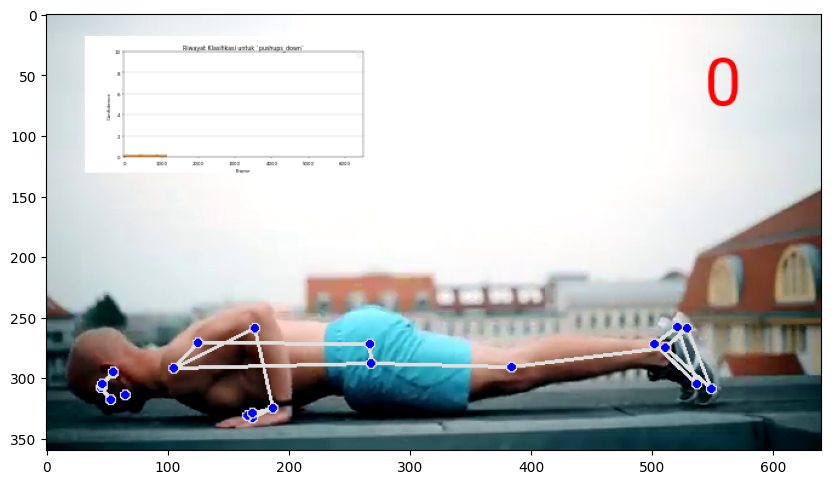

 17%|█▋        | 1101/6510.0 [03:32<40:01,  2.25it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 17%|█▋        | 1102/6510.0 [03:32<32:58,  2.73it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 17%|█▋        | 1103/6510.0 [03:32<28:00,  3.22it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 17%|█▋        | 1104/6510.0 [03:32<25:06,  3.59it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 17%|█▋        | 1105/6510.0 [03:32<22:39,  3.97it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 17%|█▋        | 1106/6510.0 [03:33<20:42,  4.35it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 17%|█▋        | 1107/6510.0 [03:33<19:28,  4.62it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 17%|█▋        | 1108/6510.0 [03:33<18:26,  4.88it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

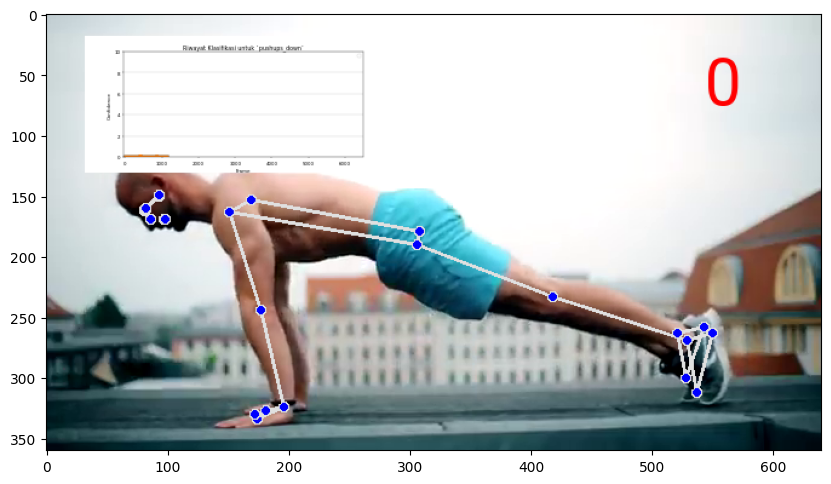

 18%|█▊        | 1151/6510.0 [03:43<39:50,  2.24it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 18%|█▊        | 1152/6510.0 [03:43<32:59,  2.71it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 18%|█▊        | 1153/6510.0 [03:43<28:21,  3.15it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 18%|█▊        | 1154/6510.0 [03:44<25:03,  3.56it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 18%|█▊        | 1155/6510.0 [03:44<22:32,  3.96it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 18%|█▊        | 1156/6510.0 [03:44<20:53,  4.27it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 18%|█▊        | 1157/6510.0 [03:44<20:07,  4.43it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 18%|█▊        | 1158/6510.0 [03:44<19:16,  4.63it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

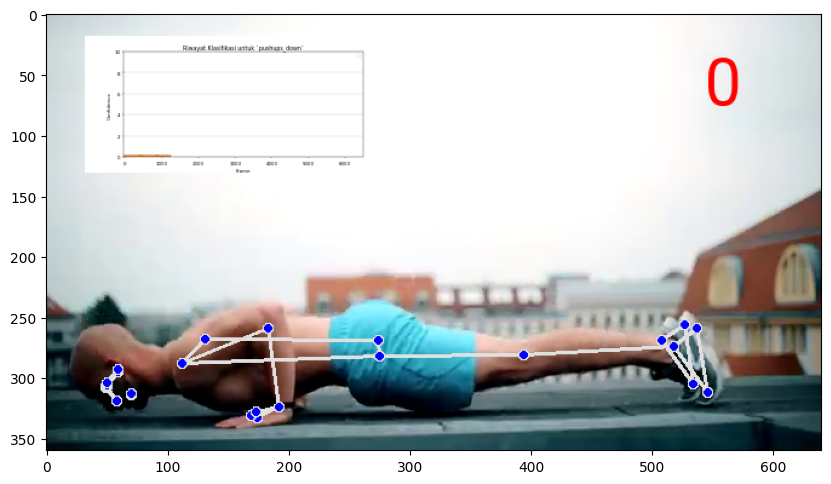

 18%|█▊        | 1201/6510.0 [03:54<45:51,  1.93it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 18%|█▊        | 1202/6510.0 [03:54<37:56,  2.33it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 18%|█▊        | 1203/6510.0 [03:54<33:20,  2.65it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 18%|█▊        | 1204/6510.0 [03:55<29:07,  3.04it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 19%|█▊        | 1205/6510.0 [03:55<25:33,  3.46it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 19%|█▊        | 1206/6510.0 [03:55<23:05,  3.83it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 19%|█▊        | 1207/6510.0 [03:55<21:06,  4.19it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 19%|█▊        | 1208/6510.0 [03:55<19:50,  4.46it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

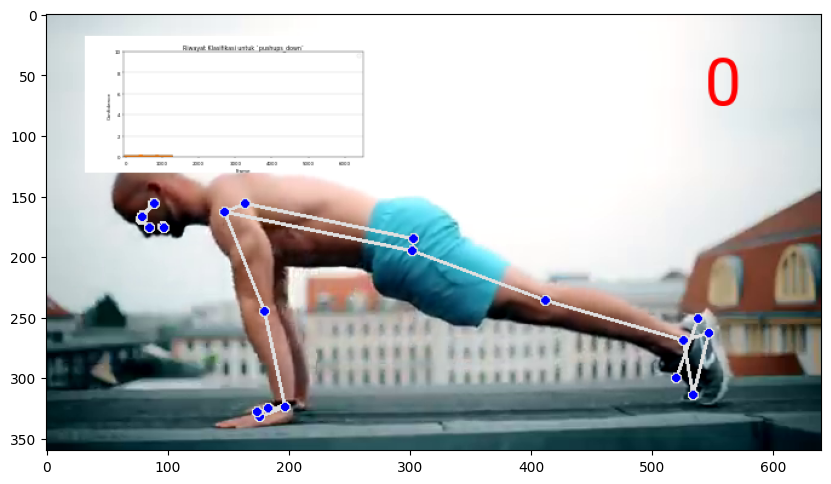

 19%|█▉        | 1251/6510.0 [04:05<39:54,  2.20it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 19%|█▉        | 1252/6510.0 [04:05<32:57,  2.66it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 19%|█▉        | 1253/6510.0 [04:05<27:57,  3.13it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 19%|█▉        | 1254/6510.0 [04:05<24:41,  3.55it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 19%|█▉        | 1255/6510.0 [04:05<22:12,  3.94it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 19%|█▉        | 1256/6510.0 [04:06<20:38,  4.24it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 19%|█▉        | 1257/6510.0 [04:06<19:46,  4.43it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 19%|█▉        | 1258/6510.0 [04:06<18:33,  4.72it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

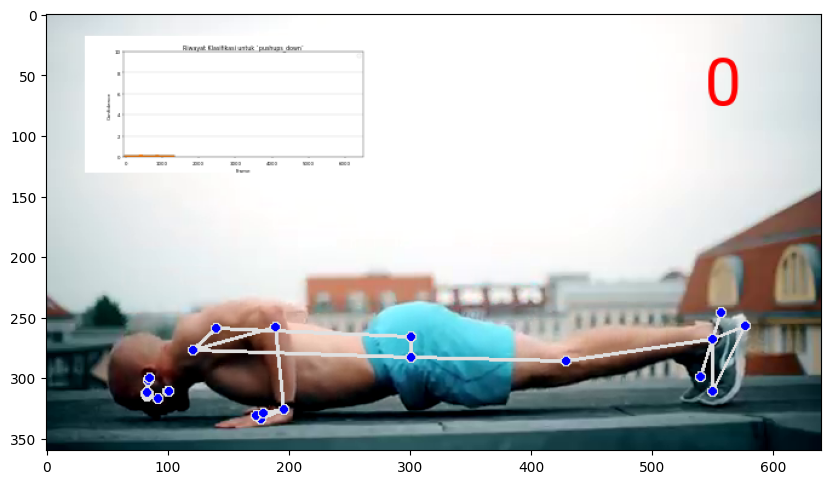

 20%|█▉        | 1301/6510.0 [04:17<39:21,  2.21it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 20%|██        | 1302/6510.0 [04:17<32:39,  2.66it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 20%|██        | 1303/6510.0 [04:17<28:25,  3.05it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 20%|██        | 1304/6510.0 [04:17<25:12,  3.44it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 20%|██        | 1305/6510.0 [04:17<22:19,  3.89it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 20%|██        | 1306/6510.0 [04:17<20:13,  4.29it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 20%|██        | 1307/6510.0 [04:18<18:56,  4.58it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 20%|██        | 1308/6510.0 [04:18<18:08,  4.78it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

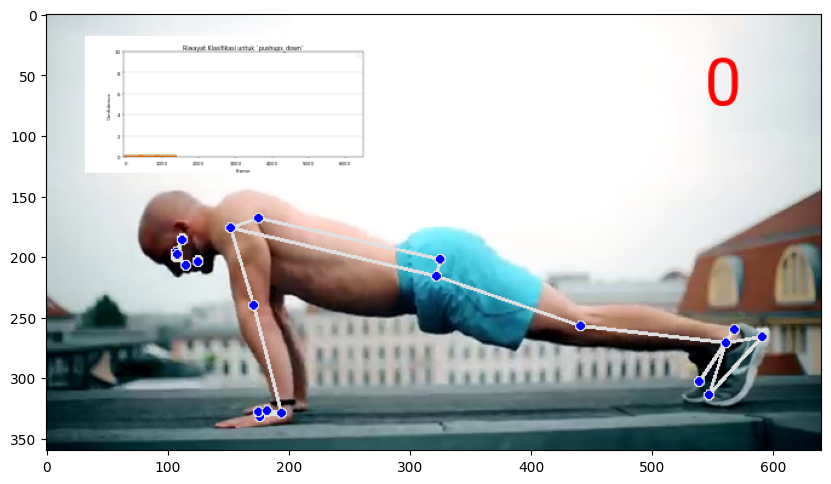

 21%|██        | 1351/6510.0 [04:27<43:21,  1.98it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 21%|██        | 1352/6510.0 [04:27<35:57,  2.39it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 21%|██        | 1353/6510.0 [04:28<30:44,  2.80it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 21%|██        | 1354/6510.0 [04:28<26:40,  3.22it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 21%|██        | 1355/6510.0 [04:28<24:00,  3.58it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 21%|██        | 1356/6510.0 [04:28<22:50,  3.76it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 21%|██        | 1357/6510.0 [04:28<21:01,  4.08it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 21%|██        | 1358/6510.0 [04:29<20:14,  4.24it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

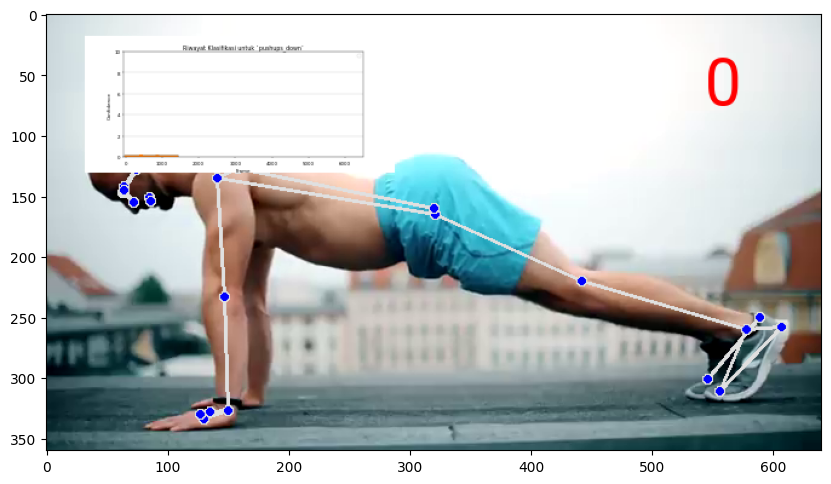

 22%|██▏       | 1401/6510.0 [04:38<38:04,  2.24it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 22%|██▏       | 1402/6510.0 [04:38<31:17,  2.72it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 22%|██▏       | 1403/6510.0 [04:38<26:23,  3.22it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 22%|██▏       | 1404/6510.0 [04:38<23:43,  3.59it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 22%|██▏       | 1405/6510.0 [04:38<21:23,  3.98it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 22%|██▏       | 1406/6510.0 [04:39<19:48,  4.29it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 22%|██▏       | 1407/6510.0 [04:39<18:35,  4.57it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 22%|██▏       | 1408/6510.0 [04:39<17:35,  4.83it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

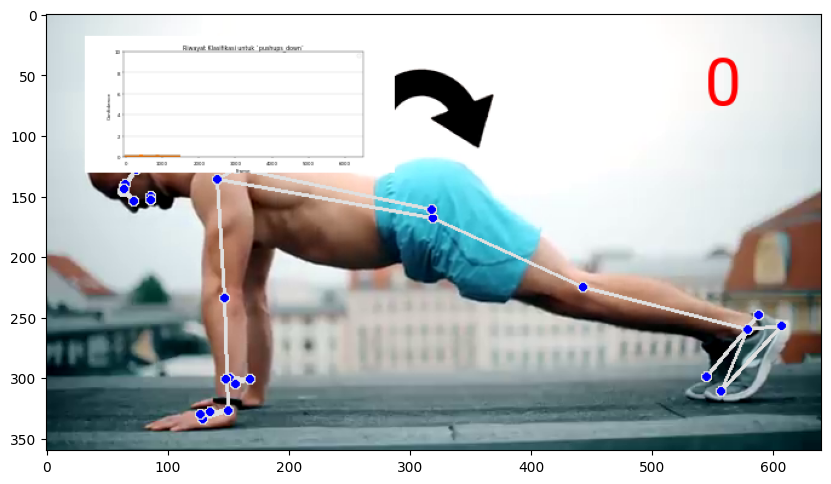

 22%|██▏       | 1451/6510.0 [04:49<37:58,  2.22it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 22%|██▏       | 1452/6510.0 [04:49<31:44,  2.66it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 22%|██▏       | 1453/6510.0 [04:49<26:49,  3.14it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 22%|██▏       | 1454/6510.0 [04:49<23:37,  3.57it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 22%|██▏       | 1455/6510.0 [04:50<21:15,  3.96it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 22%|██▏       | 1456/6510.0 [04:50<19:45,  4.26it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 22%|██▏       | 1457/6510.0 [04:50<18:40,  4.51it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 22%|██▏       | 1458/6510.0 [04:50<17:40,  4.76it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

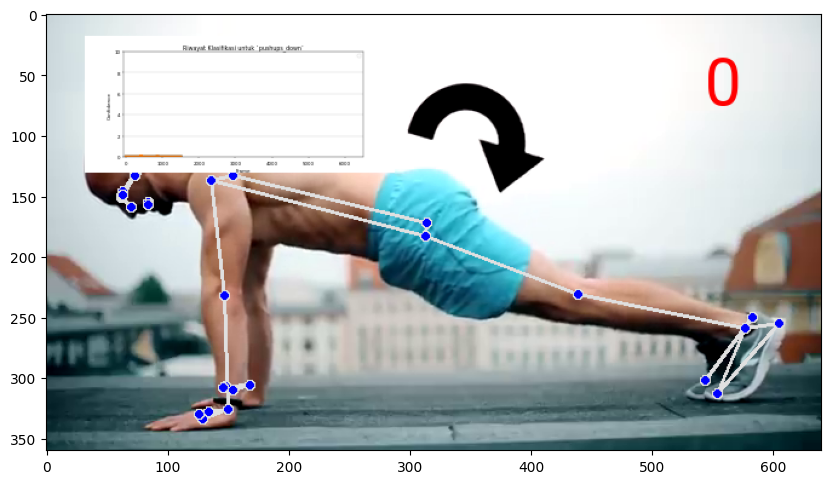

 23%|██▎       | 1501/6510.0 [05:00<44:19,  1.88it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 23%|██▎       | 1502/6510.0 [05:00<38:27,  2.17it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 23%|██▎       | 1503/6510.0 [05:00<32:52,  2.54it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 23%|██▎       | 1504/6510.0 [05:01<27:51,  2.99it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 23%|██▎       | 1505/6510.0 [05:01<24:13,  3.44it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 23%|██▎       | 1506/6510.0 [05:01<21:41,  3.84it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 23%|██▎       | 1507/6510.0 [05:01<19:44,  4.22it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 23%|██▎       | 1508/6510.0 [05:01<18:43,  4.45it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

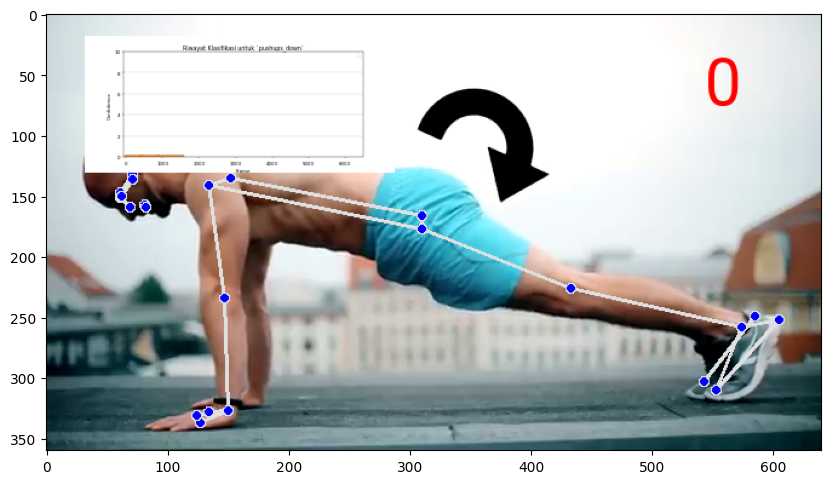

 24%|██▍       | 1551/6510.0 [05:10<37:42,  2.19it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 24%|██▍       | 1552/6510.0 [05:11<31:39,  2.61it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 24%|██▍       | 1553/6510.0 [05:11<27:31,  3.00it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 24%|██▍       | 1554/6510.0 [05:11<24:44,  3.34it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 24%|██▍       | 1555/6510.0 [05:11<23:02,  3.58it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 24%|██▍       | 1556/6510.0 [05:12<22:25,  3.68it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 24%|██▍       | 1557/6510.0 [05:12<21:53,  3.77it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 24%|██▍       | 1558/6510.0 [05:12<21:46,  3.79it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

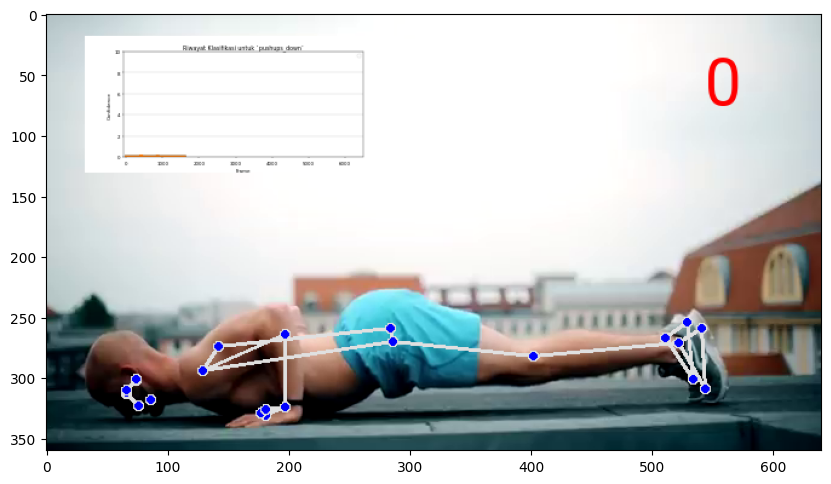

 25%|██▍       | 1601/6510.0 [05:22<36:13,  2.26it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 25%|██▍       | 1602/6510.0 [05:22<30:09,  2.71it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 25%|██▍       | 1603/6510.0 [05:22<25:50,  3.16it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 25%|██▍       | 1604/6510.0 [05:22<22:39,  3.61it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 25%|██▍       | 1605/6510.0 [05:23<20:13,  4.04it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 25%|██▍       | 1606/6510.0 [05:23<18:52,  4.33it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 25%|██▍       | 1607/6510.0 [05:23<18:03,  4.53it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 25%|██▍       | 1608/6510.0 [05:23<17:05,  4.78it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

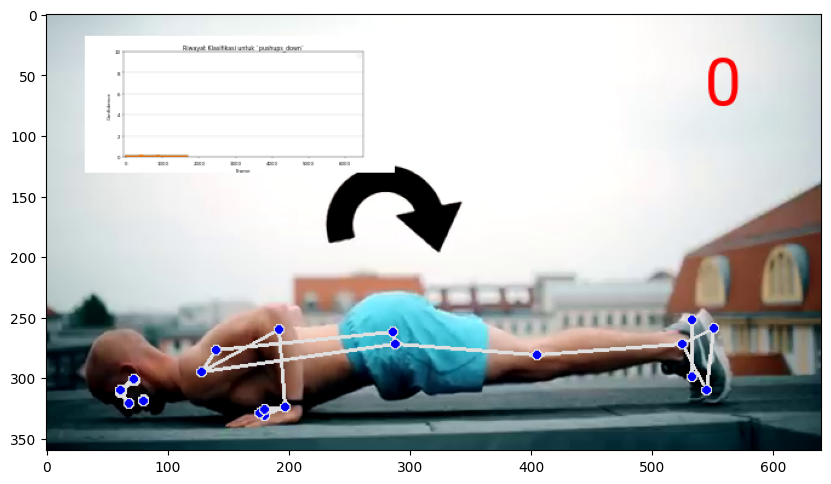

 25%|██▌       | 1651/6510.0 [05:34<38:34,  2.10it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 25%|██▌       | 1652/6510.0 [05:34<31:54,  2.54it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 25%|██▌       | 1653/6510.0 [05:34<26:53,  3.01it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 25%|██▌       | 1654/6510.0 [05:34<23:54,  3.38it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 25%|██▌       | 1655/6510.0 [05:34<21:02,  3.84it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 25%|██▌       | 1656/6510.0 [05:35<20:17,  3.99it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 25%|██▌       | 1657/6510.0 [05:35<18:30,  4.37it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 25%|██▌       | 1658/6510.0 [05:35<17:21,  4.66it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

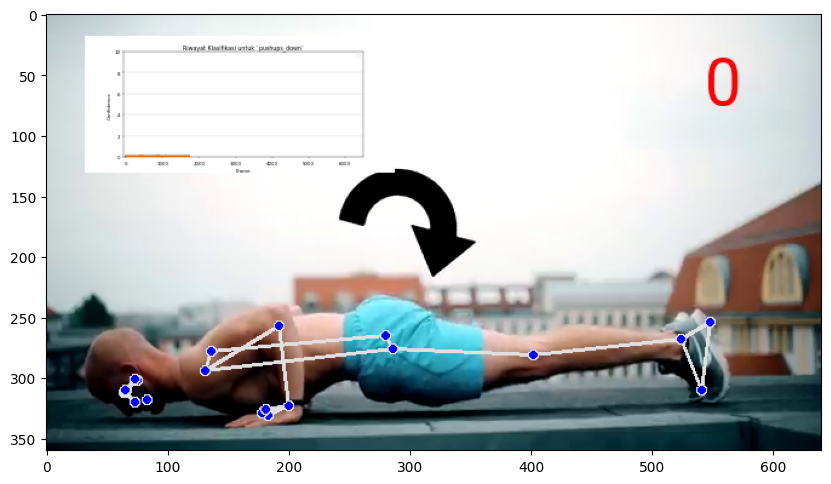

 26%|██▌       | 1701/6510.0 [05:44<43:40,  1.84it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 26%|██▌       | 1702/6510.0 [05:45<37:13,  2.15it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 26%|██▌       | 1703/6510.0 [05:45<32:10,  2.49it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 26%|██▌       | 1704/6510.0 [05:45<28:59,  2.76it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 26%|██▌       | 1705/6510.0 [05:46<27:31,  2.91it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 26%|██▌       | 1706/6510.0 [05:46<25:38,  3.12it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 26%|██▌       | 1707/6510.0 [05:46<23:40,  3.38it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 26%|██▌       | 1708/6510.0 [05:46<22:01,  3.63it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

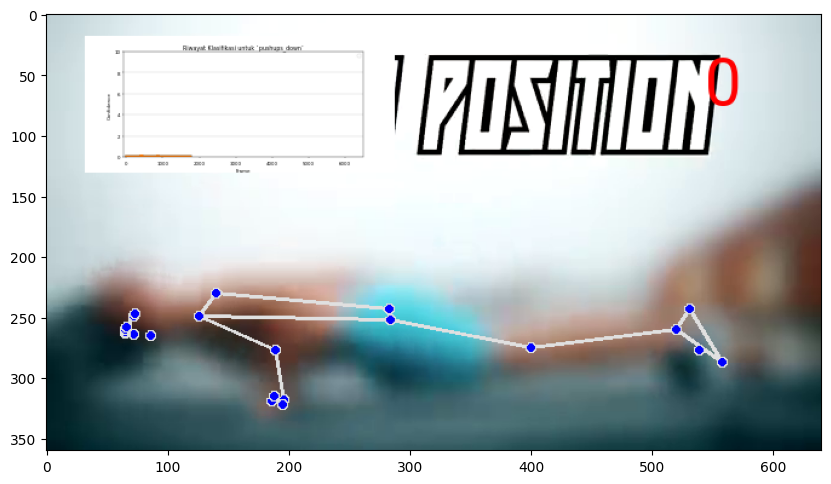

 27%|██▋       | 1751/6510.0 [05:56<36:05,  2.20it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 27%|██▋       | 1752/6510.0 [05:56<29:40,  2.67it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 27%|██▋       | 1753/6510.0 [05:56<25:15,  3.14it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 27%|██▋       | 1754/6510.0 [05:56<22:21,  3.55it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 27%|██▋       | 1755/6510.0 [05:56<19:54,  3.98it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 27%|██▋       | 1756/6510.0 [05:57<19:04,  4.15it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 27%|██▋       | 1757/6510.0 [05:57<17:39,  4.49it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 27%|██▋       | 1758/6510.0 [05:57<17:04,  4.64it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

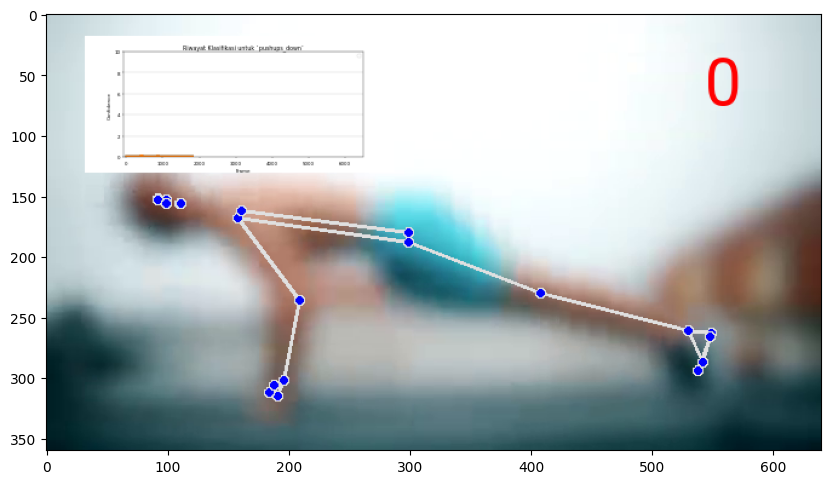

 28%|██▊       | 1801/6510.0 [06:08<34:45,  2.26it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 28%|██▊       | 1802/6510.0 [06:08<28:44,  2.73it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 28%|██▊       | 1803/6510.0 [06:08<24:13,  3.24it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 28%|██▊       | 1804/6510.0 [06:08<21:16,  3.69it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 28%|██▊       | 1805/6510.0 [06:08<19:21,  4.05it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 28%|██▊       | 1806/6510.0 [06:08<17:50,  4.40it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 28%|██▊       | 1807/6510.0 [06:09<16:50,  4.65it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 28%|██▊       | 1808/6510.0 [06:09<16:05,  4.87it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

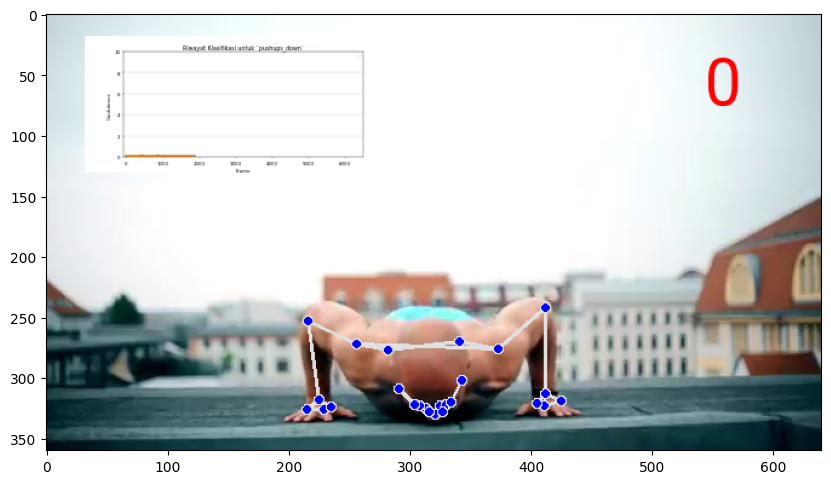

 28%|██▊       | 1851/6510.0 [06:19<42:40,  1.82it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 28%|██▊       | 1852/6510.0 [06:19<34:21,  2.26it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 28%|██▊       | 1853/6510.0 [06:19<28:18,  2.74it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 28%|██▊       | 1854/6510.0 [06:20<24:11,  3.21it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 28%|██▊       | 1855/6510.0 [06:20<21:33,  3.60it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 29%|██▊       | 1856/6510.0 [06:20<19:21,  4.01it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 29%|██▊       | 1857/6510.0 [06:20<18:30,  4.19it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 29%|██▊       | 1858/6510.0 [06:20<17:30,  4.43it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

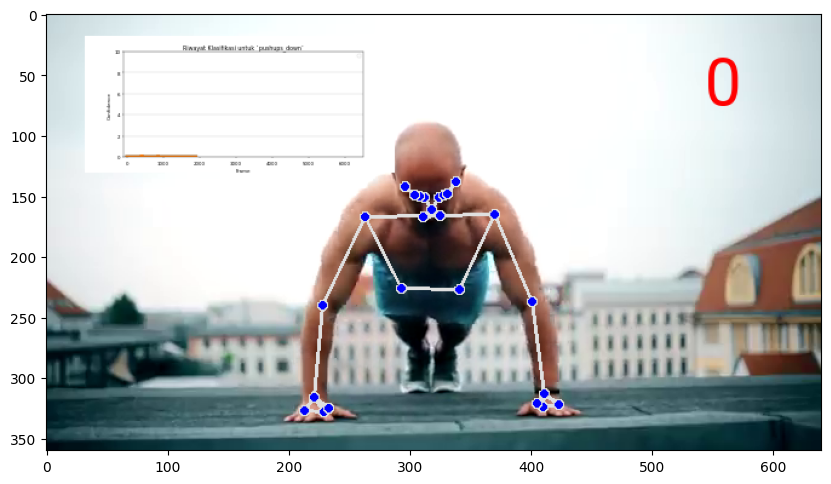

 29%|██▉       | 1901/6510.0 [06:30<36:45,  2.09it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 29%|██▉       | 1902/6510.0 [06:30<32:38,  2.35it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 29%|██▉       | 1903/6510.0 [06:30<29:28,  2.61it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 29%|██▉       | 1904/6510.0 [06:30<26:50,  2.86it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 29%|██▉       | 1905/6510.0 [06:31<23:21,  3.29it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 29%|██▉       | 1906/6510.0 [06:31<22:54,  3.35it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 29%|██▉       | 1907/6510.0 [06:31<22:32,  3.40it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 29%|██▉       | 1908/6510.0 [06:31<22:46,  3.37it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

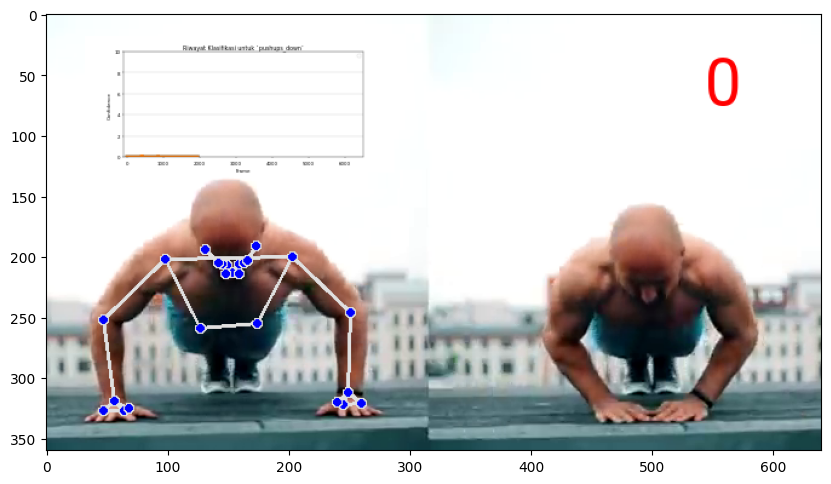

 30%|██▉       | 1951/6510.0 [06:41<33:56,  2.24it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 30%|██▉       | 1952/6510.0 [06:41<28:15,  2.69it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 30%|███       | 1953/6510.0 [06:41<24:05,  3.15it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 30%|███       | 1954/6510.0 [06:42<21:10,  3.59it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 30%|███       | 1955/6510.0 [06:42<18:48,  4.03it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 30%|███       | 1956/6510.0 [06:42<17:09,  4.42it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 30%|███       | 1957/6510.0 [06:42<16:51,  4.50it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 30%|███       | 1958/6510.0 [06:42<16:03,  4.72it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

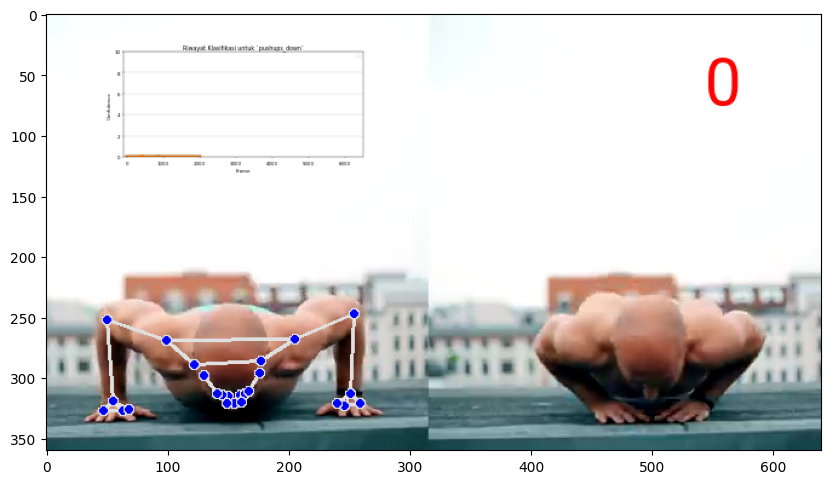

 31%|███       | 2001/6510.0 [06:53<33:41,  2.23it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 31%|███       | 2002/6510.0 [06:53<28:21,  2.65it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 31%|███       | 2003/6510.0 [06:53<23:57,  3.14it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 31%|███       | 2004/6510.0 [06:53<21:09,  3.55it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 31%|███       | 2005/6510.0 [06:53<18:56,  3.97it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 31%|███       | 2006/6510.0 [06:54<17:17,  4.34it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 31%|███       | 2007/6510.0 [06:54<16:33,  4.53it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 31%|███       | 2008/6510.0 [06:54<15:45,  4.76it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

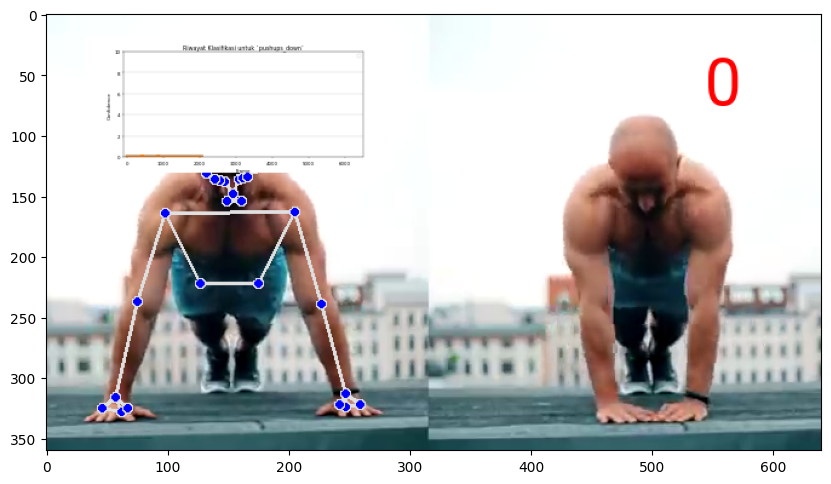

 32%|███▏      | 2051/6510.0 [07:04<38:43,  1.92it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 32%|███▏      | 2052/6510.0 [07:04<33:08,  2.24it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 32%|███▏      | 2053/6510.0 [07:04<27:17,  2.72it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 32%|███▏      | 2054/6510.0 [07:04<23:40,  3.14it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 32%|███▏      | 2055/6510.0 [07:04<21:15,  3.49it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 32%|███▏      | 2056/6510.0 [07:05<19:18,  3.84it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 32%|███▏      | 2057/6510.0 [07:05<17:45,  4.18it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 32%|███▏      | 2058/6510.0 [07:05<17:29,  4.24it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

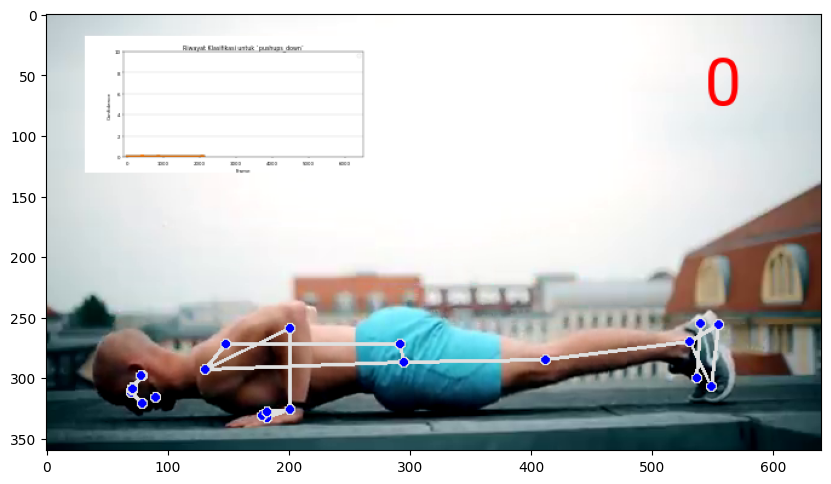

 32%|███▏      | 2101/6510.0 [07:14<33:32,  2.19it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 32%|███▏      | 2102/6510.0 [07:14<27:51,  2.64it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 32%|███▏      | 2103/6510.0 [07:15<23:38,  3.11it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 32%|███▏      | 2104/6510.0 [07:15<20:27,  3.59it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 32%|███▏      | 2105/6510.0 [07:15<18:11,  4.04it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 32%|███▏      | 2106/6510.0 [07:15<17:16,  4.25it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 32%|███▏      | 2107/6510.0 [07:15<17:03,  4.30it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 32%|███▏      | 2108/6510.0 [07:16<17:26,  4.21it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

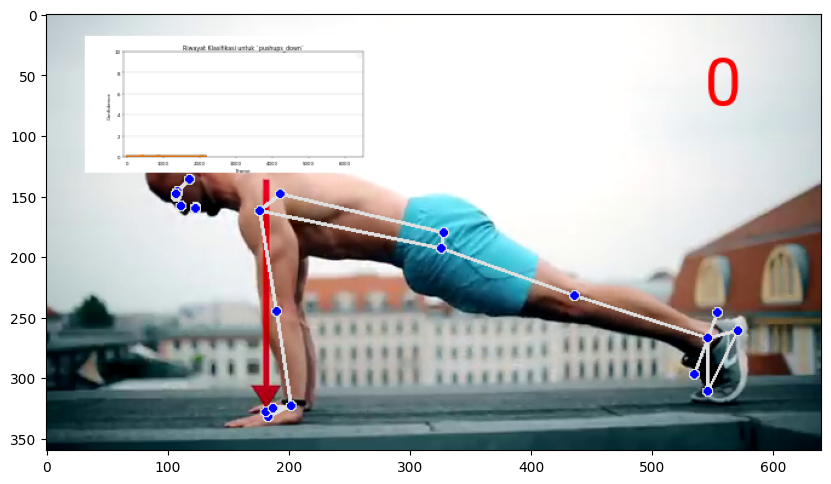

 33%|███▎      | 2151/6510.0 [07:26<33:10,  2.19it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 33%|███▎      | 2152/6510.0 [07:26<27:36,  2.63it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 33%|███▎      | 2153/6510.0 [07:26<23:20,  3.11it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 33%|███▎      | 2154/6510.0 [07:27<20:40,  3.51it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 33%|███▎      | 2155/6510.0 [07:27<19:06,  3.80it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 33%|███▎      | 2156/6510.0 [07:27<17:40,  4.11it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 33%|███▎      | 2157/6510.0 [07:27<16:42,  4.34it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 33%|███▎      | 2158/6510.0 [07:27<15:47,  4.60it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

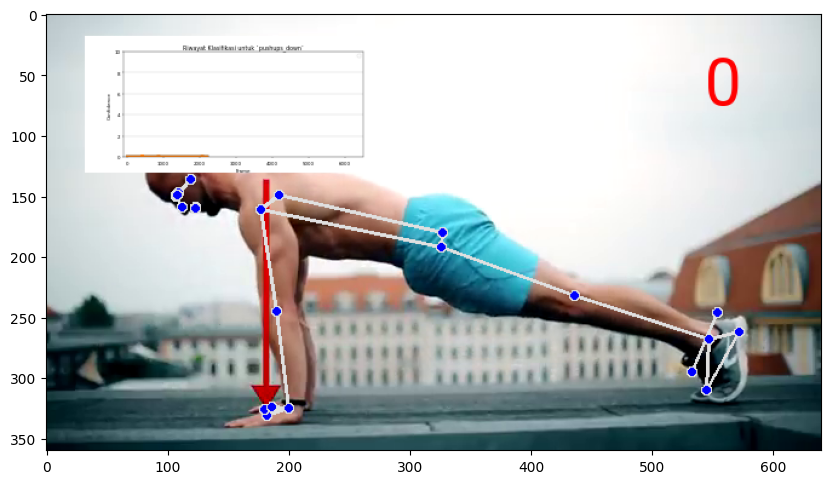

 34%|███▍      | 2201/6510.0 [07:38<33:11,  2.16it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 34%|███▍      | 2202/6510.0 [07:38<27:12,  2.64it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 34%|███▍      | 2203/6510.0 [07:38<22:56,  3.13it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 34%|███▍      | 2204/6510.0 [07:38<20:17,  3.54it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 34%|███▍      | 2205/6510.0 [07:39<18:14,  3.93it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 34%|███▍      | 2206/6510.0 [07:39<16:48,  4.27it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 34%|███▍      | 2207/6510.0 [07:39<15:44,  4.56it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 34%|███▍      | 2208/6510.0 [07:39<14:56,  4.80it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

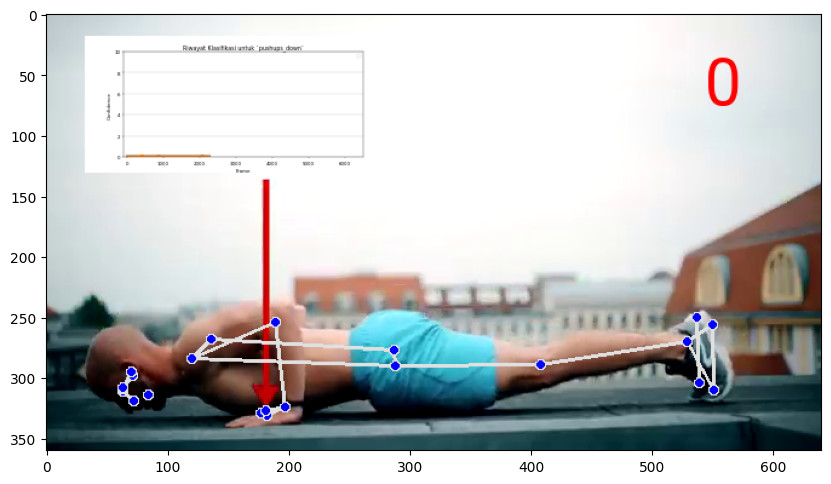

 35%|███▍      | 2251/6510.0 [07:48<33:49,  2.10it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 35%|███▍      | 2252/6510.0 [07:49<28:20,  2.50it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 35%|███▍      | 2253/6510.0 [07:49<24:49,  2.86it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 35%|███▍      | 2254/6510.0 [07:49<22:08,  3.20it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 35%|███▍      | 2255/6510.0 [07:49<21:20,  3.32it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 35%|███▍      | 2256/6510.0 [07:50<20:30,  3.46it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 35%|███▍      | 2257/6510.0 [07:50<20:33,  3.45it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 35%|███▍      | 2258/6510.0 [07:50<19:38,  3.61it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

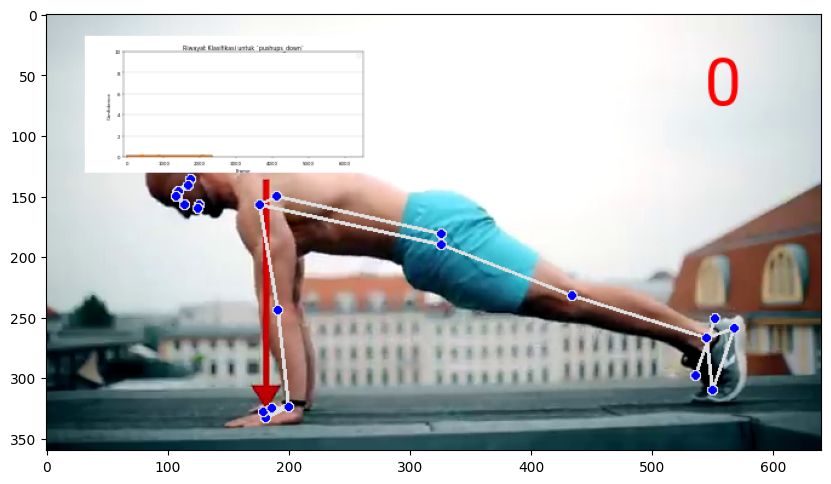

 35%|███▌      | 2301/6510.0 [07:59<31:52,  2.20it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 35%|███▌      | 2302/6510.0 [08:00<26:34,  2.64it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 35%|███▌      | 2303/6510.0 [08:00<22:27,  3.12it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 35%|███▌      | 2304/6510.0 [08:00<19:28,  3.60it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 35%|███▌      | 2305/6510.0 [08:00<17:47,  3.94it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 35%|███▌      | 2306/6510.0 [08:00<16:23,  4.27it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 35%|███▌      | 2307/6510.0 [08:01<15:29,  4.52it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 35%|███▌      | 2308/6510.0 [08:01<14:58,  4.68it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

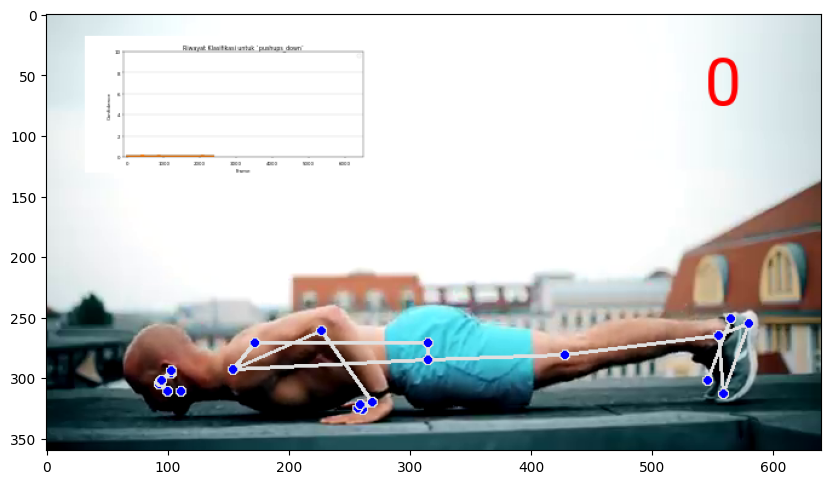

 36%|███▌      | 2351/6510.0 [08:11<30:49,  2.25it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 36%|███▌      | 2352/6510.0 [08:11<25:33,  2.71it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 36%|███▌      | 2353/6510.0 [08:11<22:10,  3.12it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 36%|███▌      | 2354/6510.0 [08:11<19:30,  3.55it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 36%|███▌      | 2355/6510.0 [08:12<17:33,  3.95it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 36%|███▌      | 2356/6510.0 [08:12<16:07,  4.29it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 36%|███▌      | 2357/6510.0 [08:12<15:06,  4.58it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 36%|███▌      | 2358/6510.0 [08:12<14:39,  4.72it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

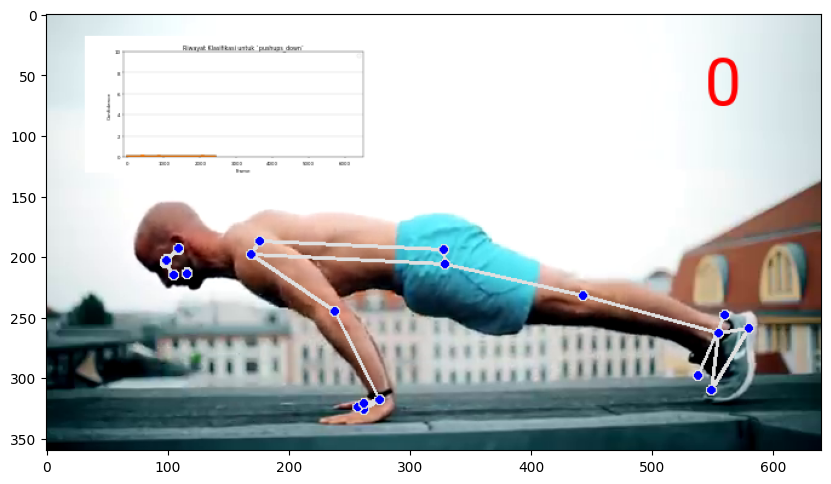

 37%|███▋      | 2401/6510.0 [08:22<35:13,  1.94it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 37%|███▋      | 2402/6510.0 [08:22<28:50,  2.37it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 37%|███▋      | 2403/6510.0 [08:23<25:14,  2.71it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 37%|███▋      | 2404/6510.0 [08:23<22:22,  3.06it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 37%|███▋      | 2405/6510.0 [08:23<19:21,  3.53it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 37%|███▋      | 2406/6510.0 [08:23<17:18,  3.95it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 37%|███▋      | 2407/6510.0 [08:23<16:04,  4.26it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 37%|███▋      | 2408/6510.0 [08:24<15:18,  4.47it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

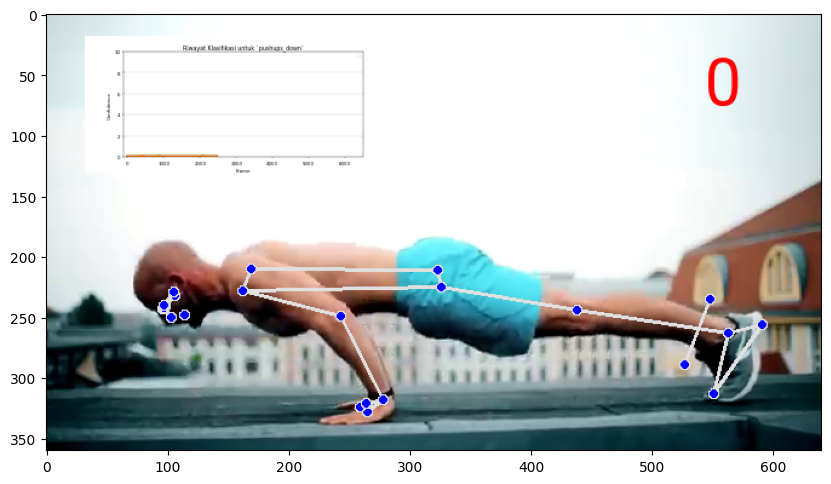

 38%|███▊      | 2451/6510.0 [08:33<30:12,  2.24it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 38%|███▊      | 2452/6510.0 [08:33<25:09,  2.69it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 38%|███▊      | 2453/6510.0 [08:33<21:34,  3.13it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 38%|███▊      | 2454/6510.0 [08:33<19:25,  3.48it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 38%|███▊      | 2455/6510.0 [08:33<18:00,  3.75it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 38%|███▊      | 2456/6510.0 [08:34<16:37,  4.06it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 38%|███▊      | 2457/6510.0 [08:34<16:26,  4.11it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 38%|███▊      | 2458/6510.0 [08:34<16:25,  4.11it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

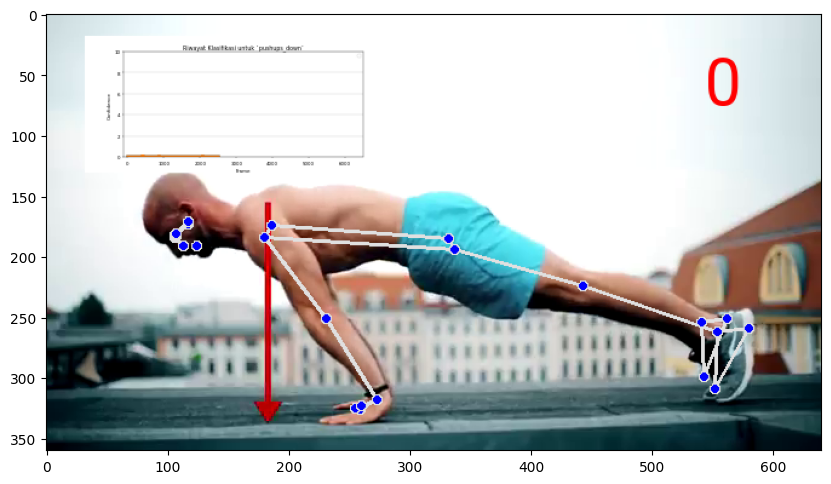

 38%|███▊      | 2501/6510.0 [08:44<29:54,  2.23it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 38%|███▊      | 2502/6510.0 [08:44<24:47,  2.69it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 38%|███▊      | 2503/6510.0 [08:44<21:07,  3.16it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 38%|███▊      | 2504/6510.0 [08:45<18:32,  3.60it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 38%|███▊      | 2505/6510.0 [08:45<16:48,  3.97it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 38%|███▊      | 2506/6510.0 [08:45<15:16,  4.37it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 39%|███▊      | 2507/6510.0 [08:45<14:31,  4.59it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 39%|███▊      | 2508/6510.0 [08:45<13:51,  4.81it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

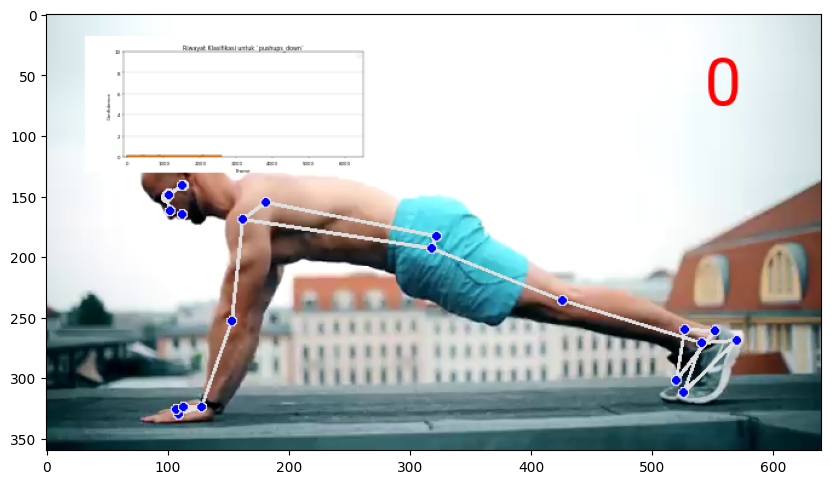

 39%|███▉      | 2551/6510.0 [08:55<30:42,  2.15it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 39%|███▉      | 2552/6510.0 [08:56<25:17,  2.61it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 39%|███▉      | 2553/6510.0 [08:56<21:29,  3.07it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 39%|███▉      | 2554/6510.0 [08:56<18:40,  3.53it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 39%|███▉      | 2555/6510.0 [08:56<16:48,  3.92it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 39%|███▉      | 2556/6510.0 [08:56<15:28,  4.26it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 39%|███▉      | 2557/6510.0 [08:57<15:02,  4.38it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 39%|███▉      | 2558/6510.0 [08:57<14:17,  4.61it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

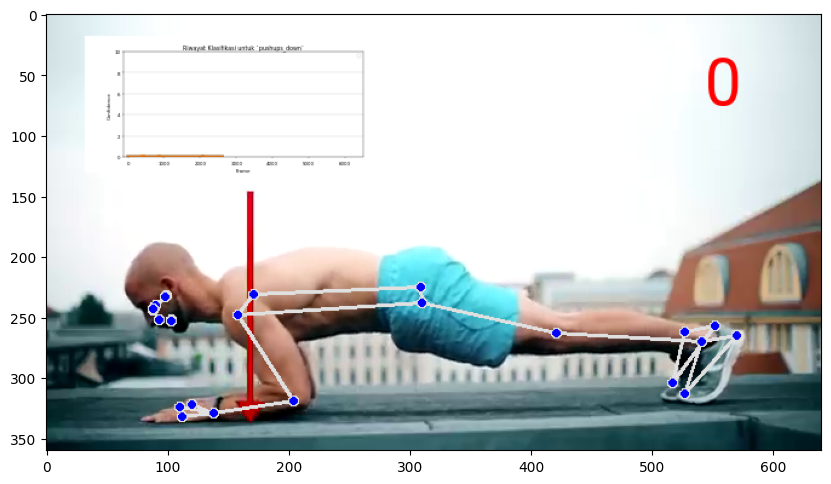

 40%|███▉      | 2601/6510.0 [09:06<29:42,  2.19it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 40%|███▉      | 2602/6510.0 [09:06<24:34,  2.65it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 40%|███▉      | 2603/6510.0 [09:06<20:47,  3.13it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 40%|████      | 2604/6510.0 [09:07<18:08,  3.59it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 40%|████      | 2605/6510.0 [09:07<16:25,  3.96it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 40%|████      | 2606/6510.0 [09:07<15:22,  4.23it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 40%|████      | 2607/6510.0 [09:07<15:25,  4.22it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 40%|████      | 2608/6510.0 [09:07<14:41,  4.43it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

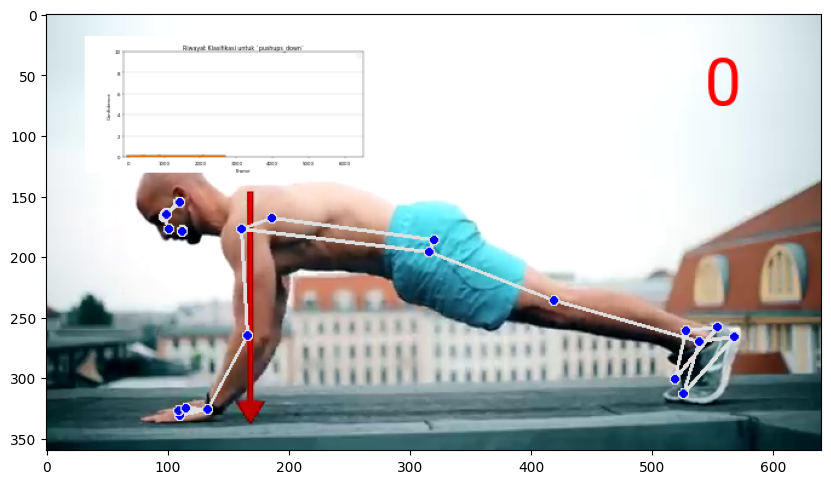

 41%|████      | 2651/6510.0 [09:17<29:25,  2.19it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 41%|████      | 2652/6510.0 [09:17<24:09,  2.66it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 41%|████      | 2653/6510.0 [09:17<20:36,  3.12it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 41%|████      | 2654/6510.0 [09:17<17:59,  3.57it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 41%|████      | 2655/6510.0 [09:18<16:09,  3.98it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 41%|████      | 2656/6510.0 [09:18<15:13,  4.22it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 41%|████      | 2657/6510.0 [09:18<14:11,  4.52it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 41%|████      | 2658/6510.0 [09:18<13:40,  4.69it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

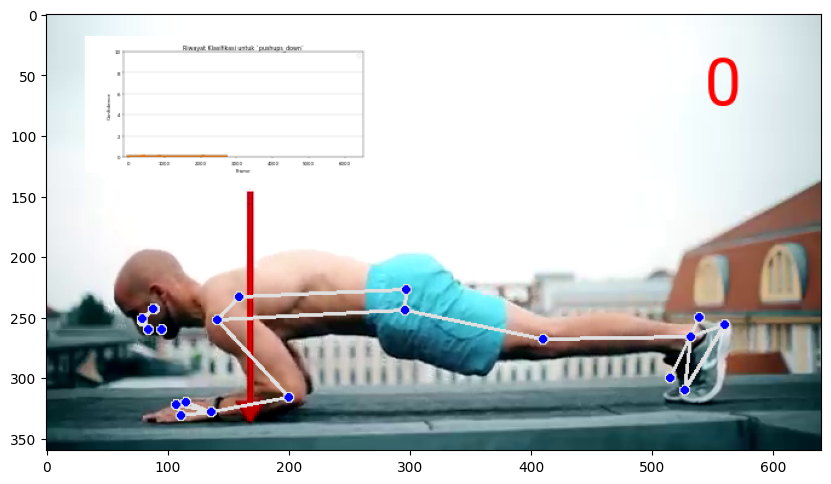

 41%|████▏     | 2701/6510.0 [09:28<28:29,  2.23it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 42%|████▏     | 2702/6510.0 [09:29<23:26,  2.71it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 42%|████▏     | 2703/6510.0 [09:29<19:52,  3.19it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 42%|████▏     | 2704/6510.0 [09:29<17:26,  3.64it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 42%|████▏     | 2705/6510.0 [09:29<15:46,  4.02it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 42%|████▏     | 2706/6510.0 [09:29<14:29,  4.37it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 42%|████▏     | 2707/6510.0 [09:29<14:02,  4.51it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 42%|████▏     | 2708/6510.0 [09:30<13:28,  4.70it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

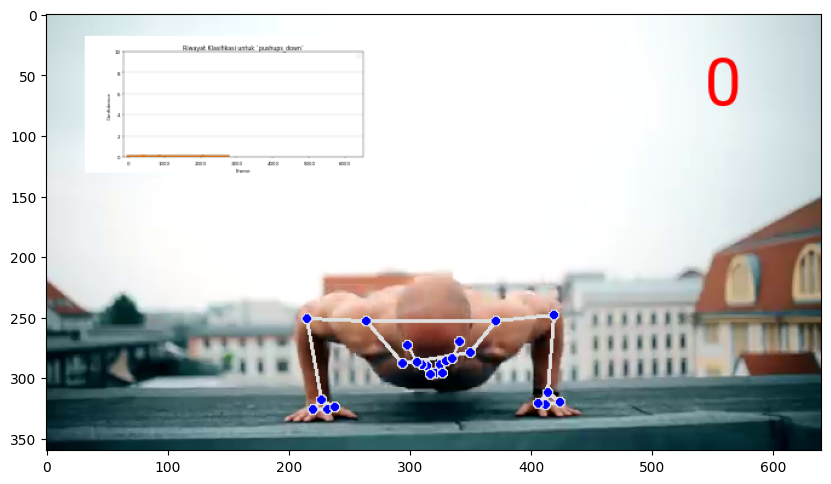

 42%|████▏     | 2751/6510.0 [09:40<33:32,  1.87it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 42%|████▏     | 2752/6510.0 [09:40<27:45,  2.26it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 42%|████▏     | 2753/6510.0 [09:40<23:43,  2.64it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 42%|████▏     | 2754/6510.0 [09:40<20:10,  3.10it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 42%|████▏     | 2755/6510.0 [09:41<17:30,  3.57it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 42%|████▏     | 2756/6510.0 [09:41<15:48,  3.96it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 42%|████▏     | 2757/6510.0 [09:41<14:30,  4.31it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 42%|████▏     | 2758/6510.0 [09:41<13:58,  4.47it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

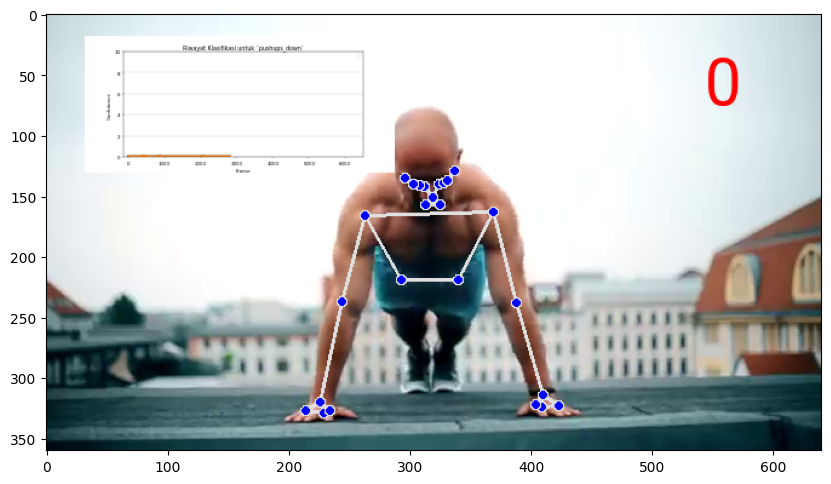

 43%|████▎     | 2801/6510.0 [09:50<27:46,  2.23it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 43%|████▎     | 2802/6510.0 [09:50<22:57,  2.69it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 43%|████▎     | 2803/6510.0 [09:51<19:40,  3.14it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 43%|████▎     | 2804/6510.0 [09:51<17:15,  3.58it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 43%|████▎     | 2805/6510.0 [09:51<15:31,  3.98it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 43%|████▎     | 2806/6510.0 [09:51<14:25,  4.28it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 43%|████▎     | 2807/6510.0 [09:51<13:27,  4.58it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 43%|████▎     | 2808/6510.0 [09:52<12:49,  4.81it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

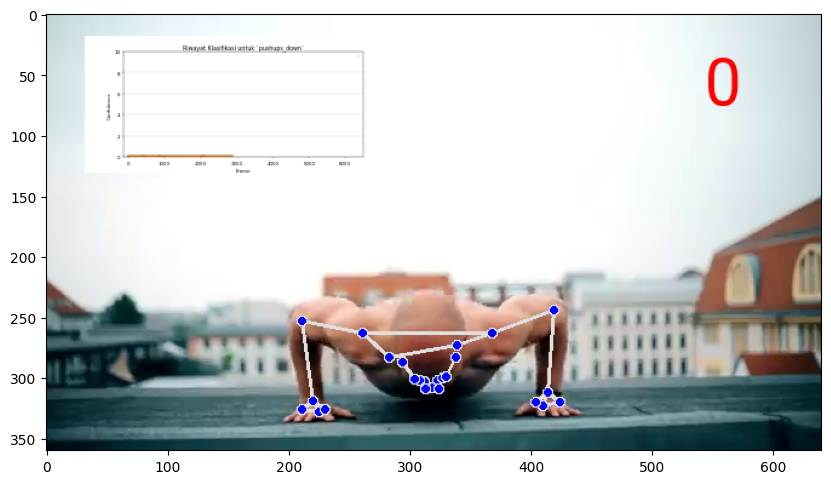

 44%|████▍     | 2851/6510.0 [10:02<27:06,  2.25it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 44%|████▍     | 2852/6510.0 [10:02<22:31,  2.71it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 44%|████▍     | 2853/6510.0 [10:02<19:04,  3.20it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 44%|████▍     | 2854/6510.0 [10:02<16:40,  3.66it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 44%|████▍     | 2855/6510.0 [10:02<15:07,  4.03it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 44%|████▍     | 2856/6510.0 [10:02<14:06,  4.32it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 44%|████▍     | 2857/6510.0 [10:03<13:15,  4.59it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 44%|████▍     | 2858/6510.0 [10:03<12:34,  4.84it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

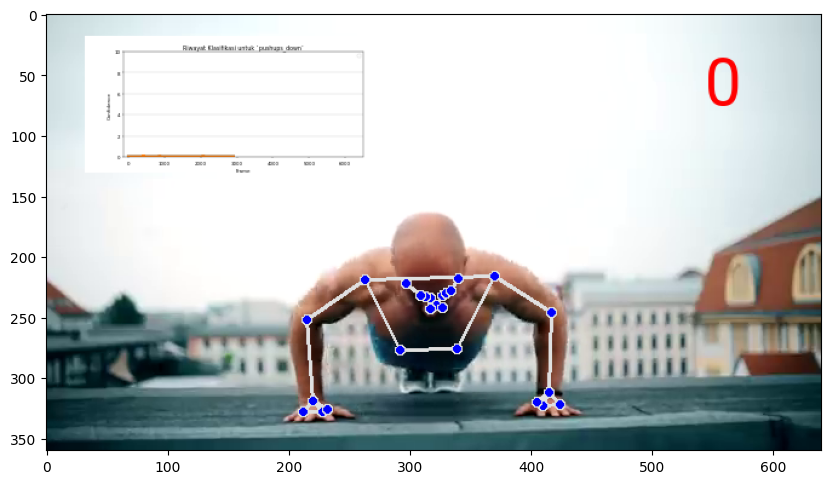

 45%|████▍     | 2901/6510.0 [10:13<32:37,  1.84it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 45%|████▍     | 2902/6510.0 [10:13<26:40,  2.25it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 45%|████▍     | 2903/6510.0 [10:13<21:57,  2.74it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 45%|████▍     | 2904/6510.0 [10:14<18:50,  3.19it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 45%|████▍     | 2905/6510.0 [10:14<16:30,  3.64it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 45%|████▍     | 2906/6510.0 [10:14<15:00,  4.00it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 45%|████▍     | 2907/6510.0 [10:14<13:54,  4.32it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 45%|████▍     | 2908/6510.0 [10:14<13:01,  4.61it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

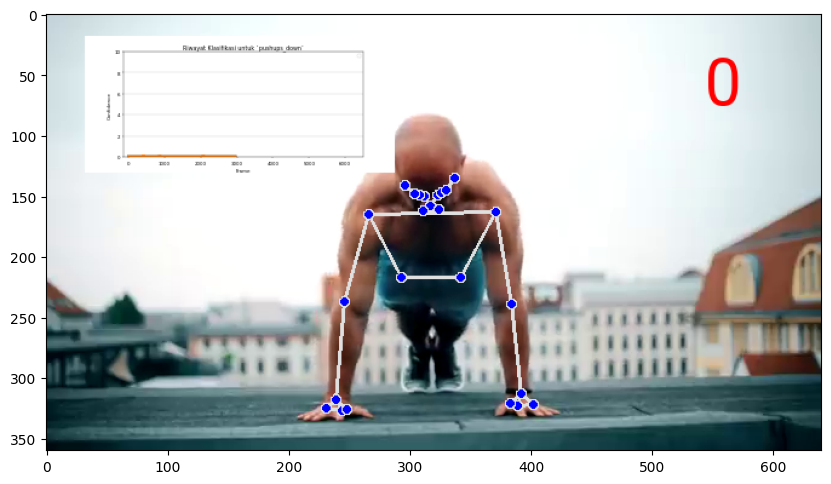

 45%|████▌     | 2951/6510.0 [10:23<27:38,  2.15it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 45%|████▌     | 2952/6510.0 [10:24<22:52,  2.59it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 45%|████▌     | 2953/6510.0 [10:24<19:59,  2.97it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 45%|████▌     | 2954/6510.0 [10:24<17:32,  3.38it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 45%|████▌     | 2955/6510.0 [10:24<15:38,  3.79it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 45%|████▌     | 2956/6510.0 [10:24<14:22,  4.12it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 45%|████▌     | 2957/6510.0 [10:25<13:43,  4.31it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 45%|████▌     | 2958/6510.0 [10:25<12:50,  4.61it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

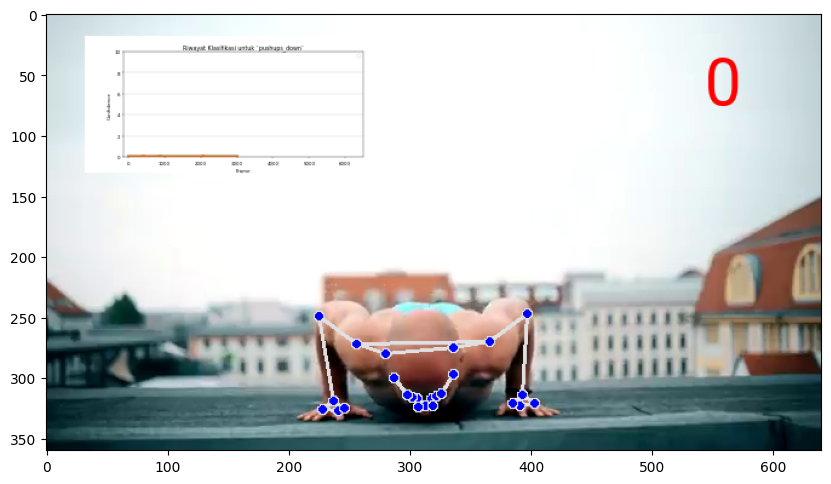

 46%|████▌     | 3001/6510.0 [10:35<26:59,  2.17it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 46%|████▌     | 3002/6510.0 [10:35<22:16,  2.63it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 46%|████▌     | 3003/6510.0 [10:35<18:56,  3.09it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 46%|████▌     | 3004/6510.0 [10:35<16:58,  3.44it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 46%|████▌     | 3005/6510.0 [10:35<15:09,  3.86it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 46%|████▌     | 3006/6510.0 [10:36<13:50,  4.22it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 46%|████▌     | 3007/6510.0 [10:36<12:58,  4.50it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 46%|████▌     | 3008/6510.0 [10:36<12:14,  4.77it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

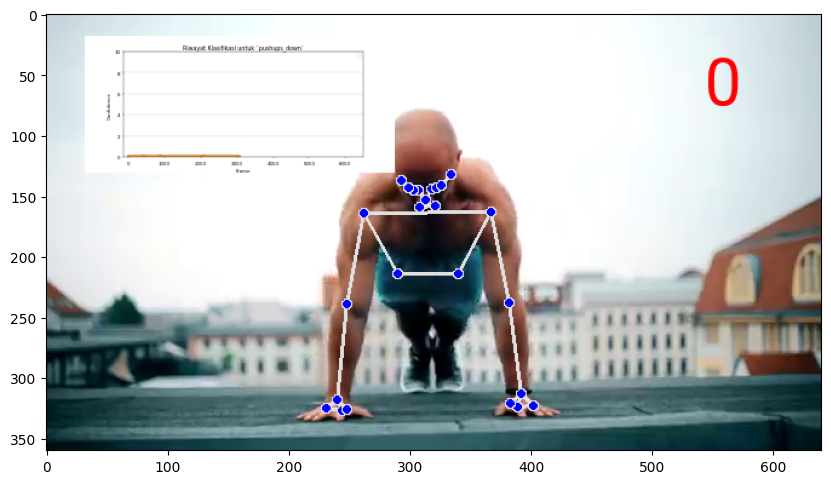

 47%|████▋     | 3051/6510.0 [10:46<26:51,  2.15it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 47%|████▋     | 3052/6510.0 [10:46<22:11,  2.60it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 47%|████▋     | 3053/6510.0 [10:47<18:44,  3.07it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 47%|████▋     | 3054/6510.0 [10:47<16:31,  3.49it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 47%|████▋     | 3055/6510.0 [10:47<14:49,  3.88it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 47%|████▋     | 3056/6510.0 [10:47<13:43,  4.19it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 47%|████▋     | 3057/6510.0 [10:47<12:54,  4.46it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 47%|████▋     | 3058/6510.0 [10:47<12:15,  4.69it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

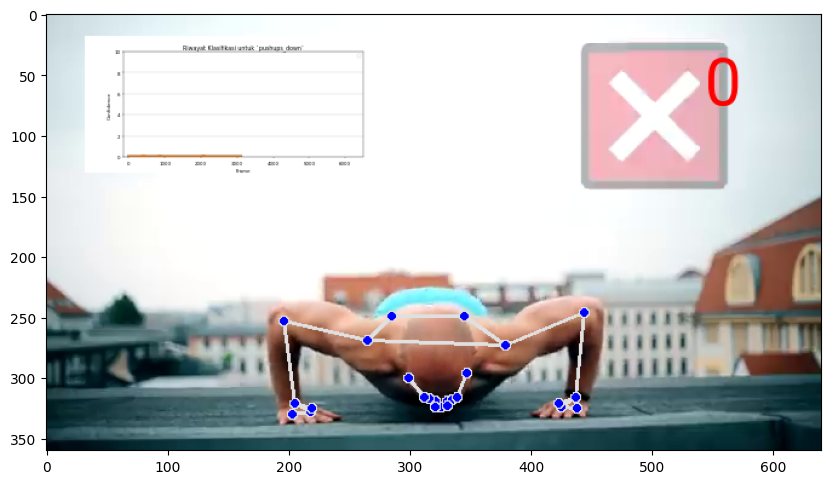

 48%|████▊     | 3101/6510.0 [10:57<28:00,  2.03it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 48%|████▊     | 3102/6510.0 [10:57<23:08,  2.45it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 48%|████▊     | 3103/6510.0 [10:57<20:00,  2.84it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 48%|████▊     | 3104/6510.0 [10:58<17:37,  3.22it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 48%|████▊     | 3105/6510.0 [10:58<16:01,  3.54it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 48%|████▊     | 3106/6510.0 [10:58<15:00,  3.78it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 48%|████▊     | 3107/6510.0 [10:58<14:16,  3.97it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 48%|████▊     | 3108/6510.0 [10:59<13:35,  4.17it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

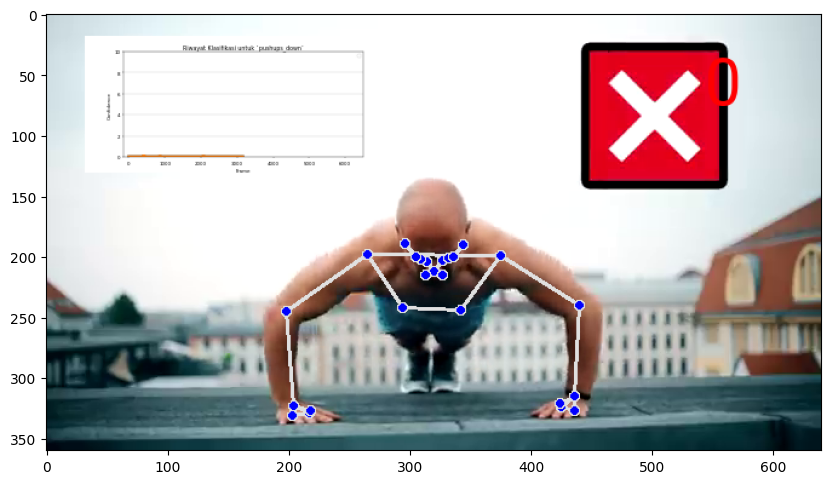

 48%|████▊     | 3151/6510.0 [11:08<25:46,  2.17it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 48%|████▊     | 3152/6510.0 [11:08<21:18,  2.63it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 48%|████▊     | 3153/6510.0 [11:08<18:13,  3.07it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 48%|████▊     | 3154/6510.0 [11:09<15:49,  3.54it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 48%|████▊     | 3155/6510.0 [11:09<14:09,  3.95it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 48%|████▊     | 3156/6510.0 [11:09<12:57,  4.31it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 48%|████▊     | 3157/6510.0 [11:09<12:26,  4.49it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 49%|████▊     | 3158/6510.0 [11:09<12:06,  4.61it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

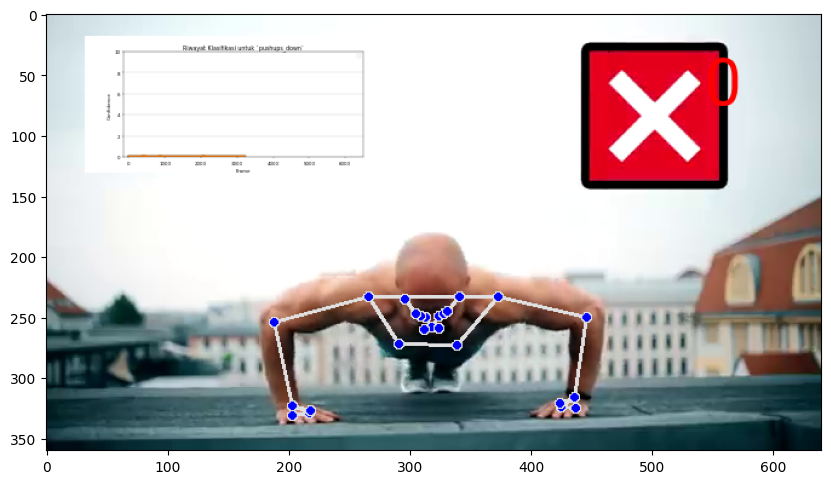

 49%|████▉     | 3201/6510.0 [11:19<25:22,  2.17it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 49%|████▉     | 3202/6510.0 [11:19<20:52,  2.64it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 49%|████▉     | 3203/6510.0 [11:19<17:45,  3.10it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 49%|████▉     | 3204/6510.0 [11:20<15:54,  3.46it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 49%|████▉     | 3205/6510.0 [11:20<14:10,  3.89it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 49%|████▉     | 3206/6510.0 [11:20<13:13,  4.16it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 49%|████▉     | 3207/6510.0 [11:20<12:22,  4.45it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 49%|████▉     | 3208/6510.0 [11:20<11:50,  4.65it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

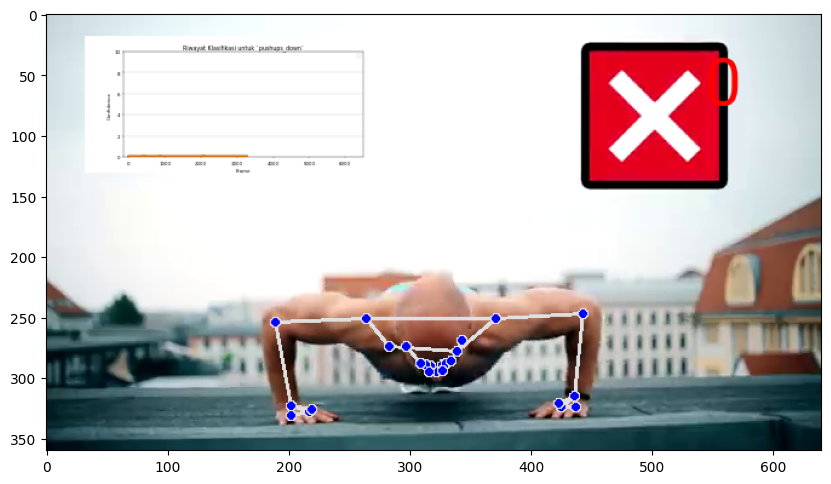

 50%|████▉     | 3251/6510.0 [11:30<25:20,  2.14it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 50%|████▉     | 3252/6510.0 [11:30<22:20,  2.43it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 50%|████▉     | 3253/6510.0 [11:30<19:15,  2.82it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 50%|████▉     | 3254/6510.0 [11:30<17:27,  3.11it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 50%|█████     | 3255/6510.0 [11:31<16:51,  3.22it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 50%|█████     | 3256/6510.0 [11:31<15:00,  3.61it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 50%|█████     | 3257/6510.0 [11:31<14:03,  3.86it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 50%|█████     | 3258/6510.0 [11:31<13:21,  4.06it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

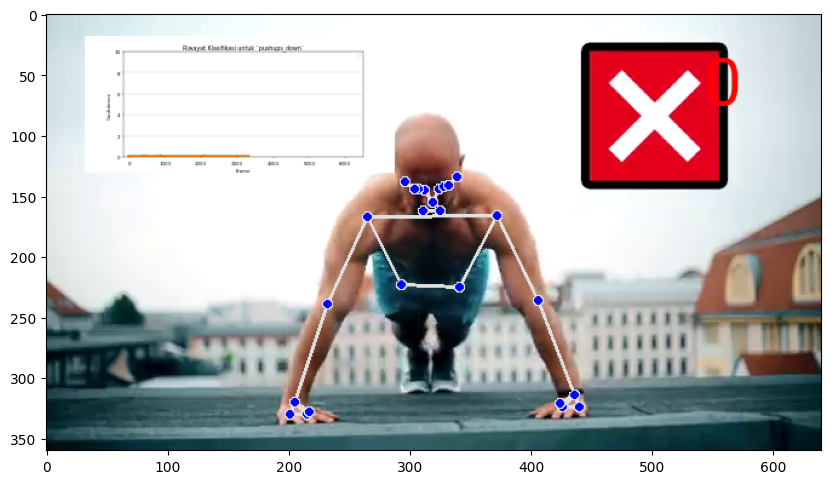

 51%|█████     | 3301/6510.0 [11:41<24:38,  2.17it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 51%|█████     | 3302/6510.0 [11:41<20:43,  2.58it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 51%|█████     | 3303/6510.0 [11:41<17:40,  3.02it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 51%|█████     | 3304/6510.0 [11:41<15:36,  3.42it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 51%|█████     | 3305/6510.0 [11:42<13:53,  3.84it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 51%|█████     | 3306/6510.0 [11:42<12:50,  4.16it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 51%|█████     | 3307/6510.0 [11:42<12:04,  4.42it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 51%|█████     | 3308/6510.0 [11:42<12:11,  4.38it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

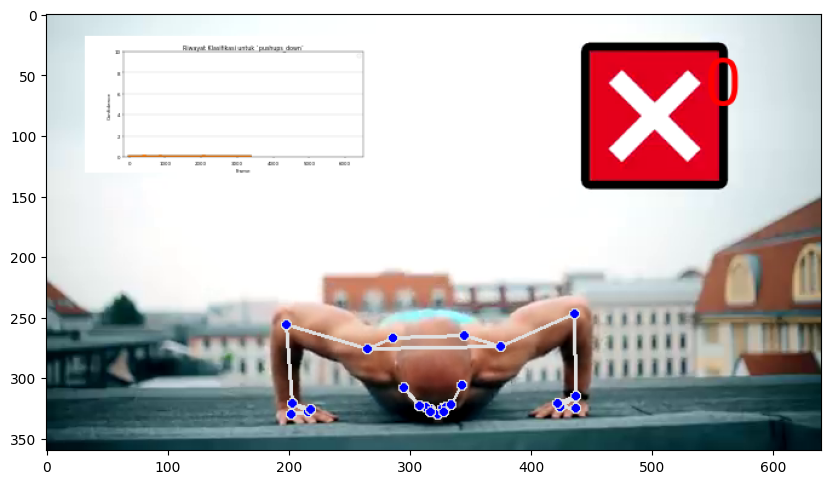

 51%|█████▏    | 3351/6510.0 [11:52<23:22,  2.25it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 51%|█████▏    | 3352/6510.0 [11:52<19:15,  2.73it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 52%|█████▏    | 3353/6510.0 [11:52<16:27,  3.20it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 52%|█████▏    | 3354/6510.0 [11:53<14:36,  3.60it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 52%|█████▏    | 3355/6510.0 [11:53<13:05,  4.02it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 52%|█████▏    | 3356/6510.0 [11:53<12:02,  4.37it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 52%|█████▏    | 3357/6510.0 [11:53<11:24,  4.60it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 52%|█████▏    | 3358/6510.0 [11:53<10:56,  4.80it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

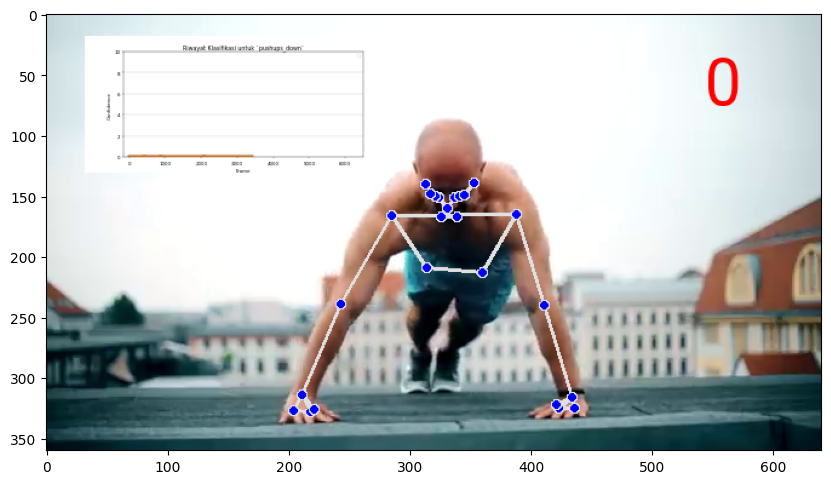

 52%|█████▏    | 3401/6510.0 [12:03<27:31,  1.88it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 52%|█████▏    | 3402/6510.0 [12:03<22:21,  2.32it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 52%|█████▏    | 3403/6510.0 [12:04<18:41,  2.77it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 52%|█████▏    | 3404/6510.0 [12:04<15:59,  3.24it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 52%|█████▏    | 3405/6510.0 [12:04<13:59,  3.70it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 52%|█████▏    | 3406/6510.0 [12:04<12:55,  4.00it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 52%|█████▏    | 3407/6510.0 [12:04<12:11,  4.24it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 52%|█████▏    | 3408/6510.0 [12:05<11:59,  4.31it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

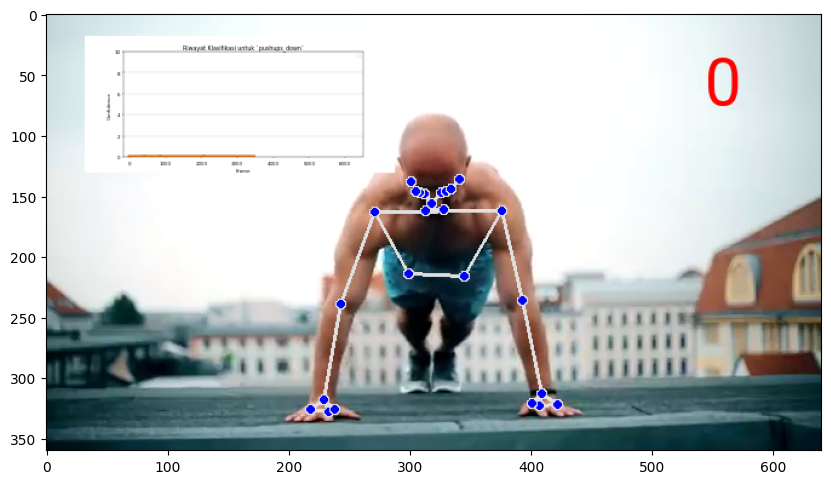

 53%|█████▎    | 3451/6510.0 [12:14<25:28,  2.00it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 53%|█████▎    | 3452/6510.0 [12:14<21:53,  2.33it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 53%|█████▎    | 3453/6510.0 [12:14<19:31,  2.61it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 53%|█████▎    | 3454/6510.0 [12:15<17:50,  2.85it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 53%|█████▎    | 3455/6510.0 [12:15<16:51,  3.02it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 53%|█████▎    | 3456/6510.0 [12:15<15:52,  3.21it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 53%|█████▎    | 3457/6510.0 [12:15<15:28,  3.29it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 53%|█████▎    | 3458/6510.0 [12:16<15:09,  3.36it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

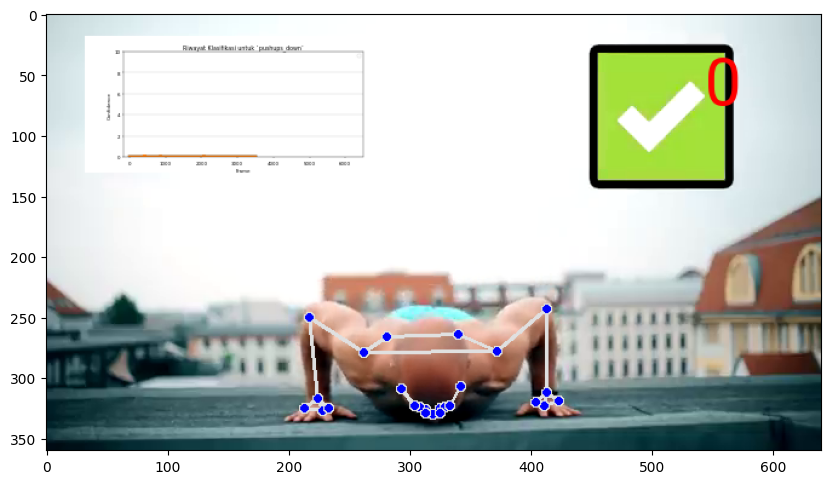

 54%|█████▍    | 3501/6510.0 [12:25<22:03,  2.27it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 54%|█████▍    | 3502/6510.0 [12:25<18:18,  2.74it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 54%|█████▍    | 3503/6510.0 [12:26<16:05,  3.12it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 54%|█████▍    | 3504/6510.0 [12:26<14:05,  3.55it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 54%|█████▍    | 3505/6510.0 [12:26<12:43,  3.94it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 54%|█████▍    | 3506/6510.0 [12:26<11:46,  4.25it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 54%|█████▍    | 3507/6510.0 [12:26<11:07,  4.50it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 54%|█████▍    | 3508/6510.0 [12:27<10:38,  4.70it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

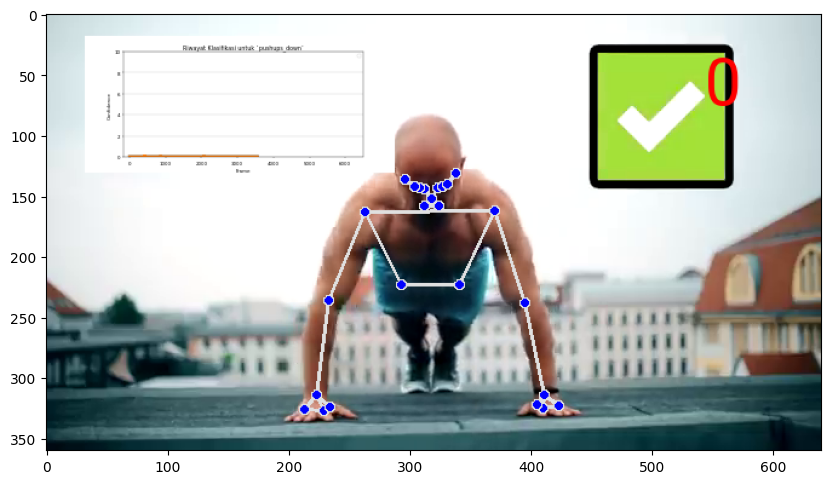

 55%|█████▍    | 3551/6510.0 [12:37<22:17,  2.21it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 55%|█████▍    | 3552/6510.0 [12:37<18:26,  2.67it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 55%|█████▍    | 3553/6510.0 [12:37<15:48,  3.12it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 55%|█████▍    | 3554/6510.0 [12:37<13:52,  3.55it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 55%|█████▍    | 3555/6510.0 [12:38<12:35,  3.91it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 55%|█████▍    | 3556/6510.0 [12:38<11:27,  4.30it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 55%|█████▍    | 3557/6510.0 [12:38<10:48,  4.55it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 55%|█████▍    | 3558/6510.0 [12:38<10:28,  4.70it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

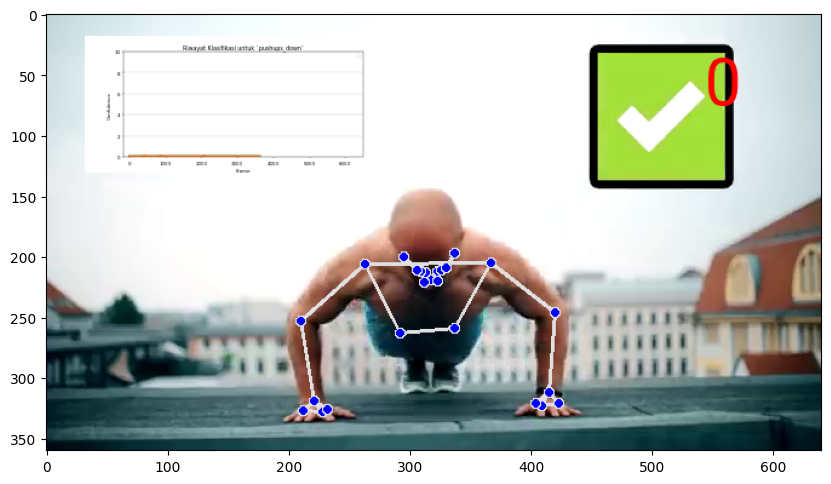

 55%|█████▌    | 3601/6510.0 [12:48<26:25,  1.83it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 55%|█████▌    | 3602/6510.0 [12:49<22:08,  2.19it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 55%|█████▌    | 3603/6510.0 [12:49<19:55,  2.43it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 55%|█████▌    | 3604/6510.0 [12:49<17:00,  2.85it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 55%|█████▌    | 3605/6510.0 [12:49<14:44,  3.28it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 55%|█████▌    | 3606/6510.0 [12:49<12:59,  3.72it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 55%|█████▌    | 3607/6510.0 [12:50<11:46,  4.11it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 55%|█████▌    | 3608/6510.0 [12:50<10:57,  4.41it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

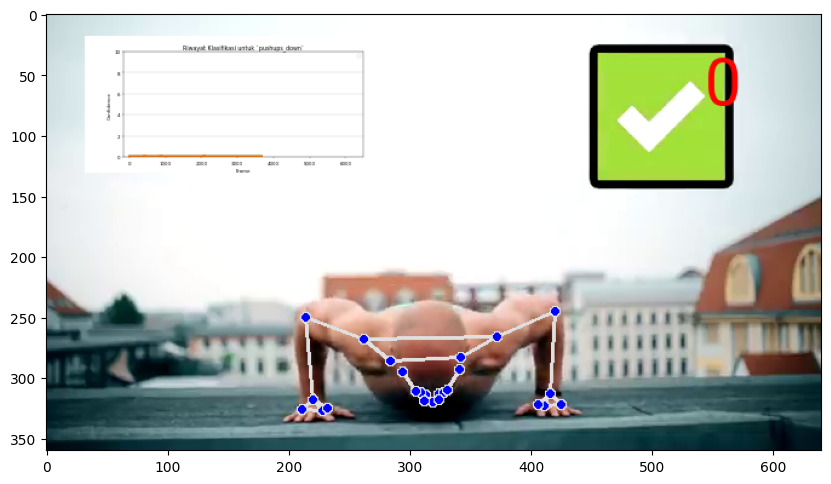

 56%|█████▌    | 3651/6510.0 [12:59<20:55,  2.28it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 56%|█████▌    | 3652/6510.0 [12:59<17:57,  2.65it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 56%|█████▌    | 3653/6510.0 [12:59<16:05,  2.96it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 56%|█████▌    | 3654/6510.0 [13:00<14:18,  3.33it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 56%|█████▌    | 3655/6510.0 [13:00<12:52,  3.70it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 56%|█████▌    | 3656/6510.0 [13:00<11:59,  3.97it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 56%|█████▌    | 3657/6510.0 [13:00<11:30,  4.13it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 56%|█████▌    | 3658/6510.0 [13:00<10:44,  4.43it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

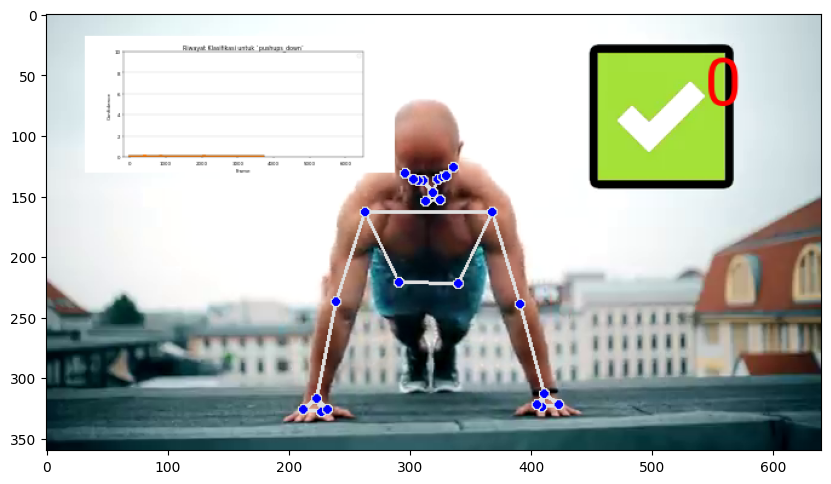

 57%|█████▋    | 3701/6510.0 [13:10<20:51,  2.24it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 57%|█████▋    | 3702/6510.0 [13:10<17:04,  2.74it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 57%|█████▋    | 3703/6510.0 [13:11<15:16,  3.06it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 57%|█████▋    | 3704/6510.0 [13:11<13:18,  3.51it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 57%|█████▋    | 3705/6510.0 [13:11<11:52,  3.94it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 57%|█████▋    | 3706/6510.0 [13:11<11:09,  4.19it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 57%|█████▋    | 3707/6510.0 [13:11<10:21,  4.51it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 57%|█████▋    | 3708/6510.0 [13:12<09:52,  4.73it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

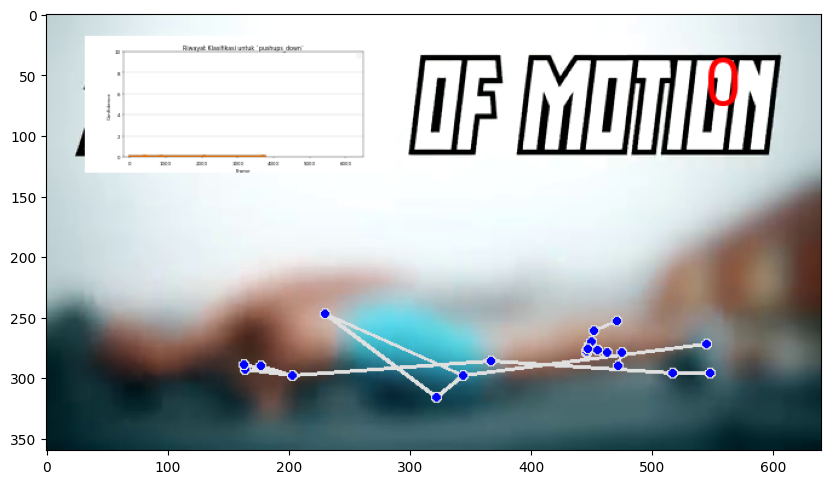

 58%|█████▊    | 3751/6510.0 [13:22<20:52,  2.20it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 58%|█████▊    | 3752/6510.0 [13:22<17:12,  2.67it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 58%|█████▊    | 3753/6510.0 [13:22<14:38,  3.14it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 58%|█████▊    | 3754/6510.0 [13:22<12:50,  3.58it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 58%|█████▊    | 3755/6510.0 [13:22<11:35,  3.96it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 58%|█████▊    | 3756/6510.0 [13:23<10:47,  4.25it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 58%|█████▊    | 3757/6510.0 [13:23<10:17,  4.46it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 58%|█████▊    | 3758/6510.0 [13:23<09:56,  4.62it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

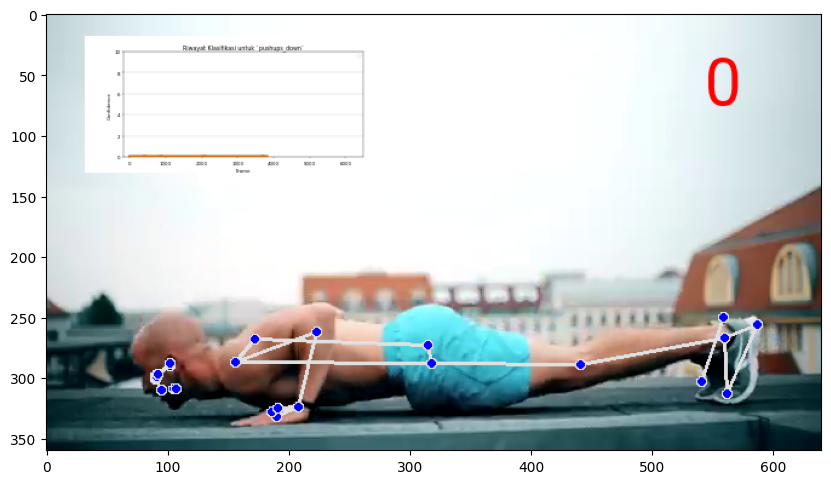

 58%|█████▊    | 3801/6510.0 [13:33<25:05,  1.80it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 58%|█████▊    | 3802/6510.0 [13:33<20:52,  2.16it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 58%|█████▊    | 3803/6510.0 [13:33<18:07,  2.49it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 58%|█████▊    | 3804/6510.0 [13:34<16:00,  2.82it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 58%|█████▊    | 3805/6510.0 [13:34<15:22,  2.93it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 58%|█████▊    | 3806/6510.0 [13:34<14:03,  3.21it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 58%|█████▊    | 3807/6510.0 [13:34<12:51,  3.50it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 58%|█████▊    | 3808/6510.0 [13:35<12:13,  3.68it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

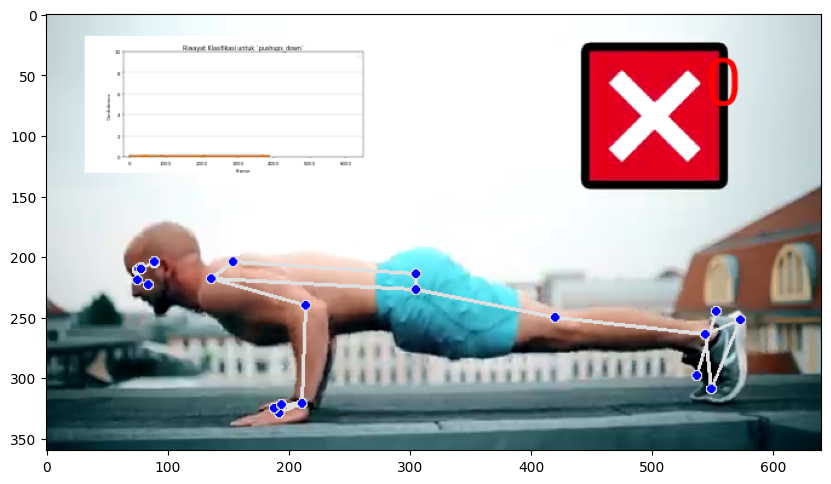

 59%|█████▉    | 3851/6510.0 [13:44<20:26,  2.17it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 59%|█████▉    | 3852/6510.0 [13:44<17:05,  2.59it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 59%|█████▉    | 3853/6510.0 [13:44<14:45,  3.00it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 59%|█████▉    | 3854/6510.0 [13:44<13:01,  3.40it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 59%|█████▉    | 3855/6510.0 [13:45<11:35,  3.82it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 59%|█████▉    | 3856/6510.0 [13:45<10:47,  4.10it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 59%|█████▉    | 3857/6510.0 [13:45<10:28,  4.22it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 59%|█████▉    | 3858/6510.0 [13:45<10:13,  4.33it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

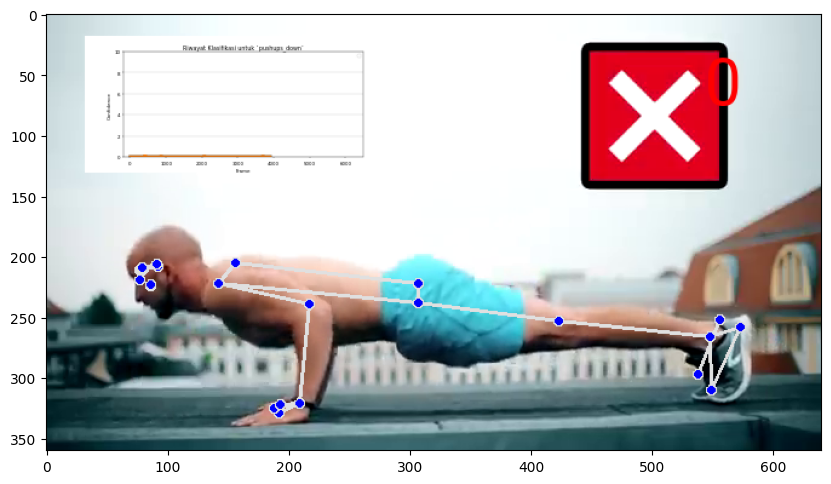

 60%|█████▉    | 3901/6510.0 [13:55<19:45,  2.20it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 60%|█████▉    | 3902/6510.0 [13:56<16:24,  2.65it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 60%|█████▉    | 3903/6510.0 [13:56<14:06,  3.08it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 60%|█████▉    | 3904/6510.0 [13:56<12:14,  3.55it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 60%|█████▉    | 3905/6510.0 [13:56<11:01,  3.94it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 60%|██████    | 3906/6510.0 [13:56<10:09,  4.27it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 60%|██████    | 3907/6510.0 [13:56<09:30,  4.56it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 60%|██████    | 3908/6510.0 [13:57<09:18,  4.66it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

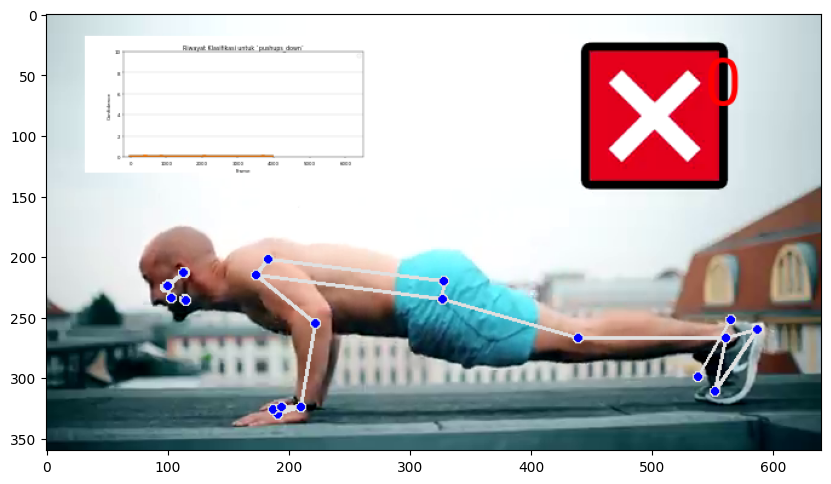

 61%|██████    | 3951/6510.0 [14:06<21:07,  2.02it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 61%|██████    | 3952/6510.0 [14:06<17:52,  2.38it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 61%|██████    | 3953/6510.0 [14:07<14:51,  2.87it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 61%|██████    | 3954/6510.0 [14:07<12:51,  3.31it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 61%|██████    | 3955/6510.0 [14:07<11:22,  3.74it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 61%|██████    | 3956/6510.0 [14:07<10:29,  4.06it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 61%|██████    | 3957/6510.0 [14:07<09:51,  4.31it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 61%|██████    | 3958/6510.0 [14:08<09:17,  4.58it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

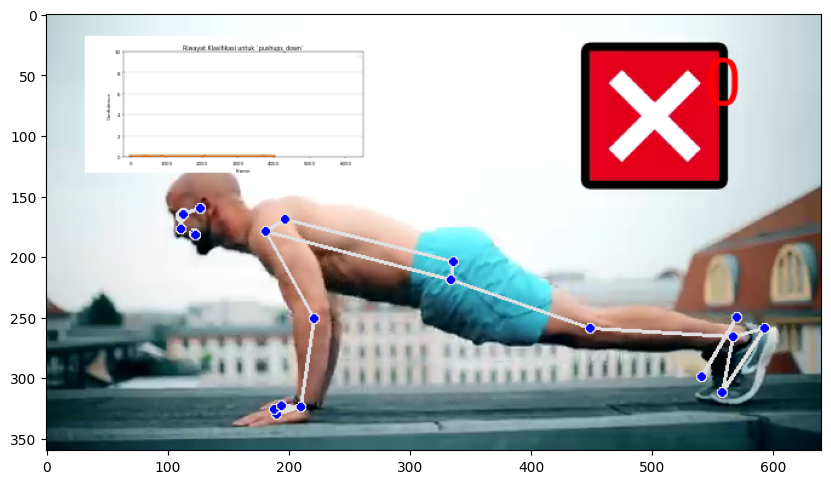

 61%|██████▏   | 4001/6510.0 [14:17<19:55,  2.10it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 61%|██████▏   | 4002/6510.0 [14:17<17:22,  2.40it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 61%|██████▏   | 4003/6510.0 [14:17<15:06,  2.76it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 62%|██████▏   | 4004/6510.0 [14:18<13:59,  2.99it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 62%|██████▏   | 4005/6510.0 [14:18<13:34,  3.08it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 62%|██████▏   | 4006/6510.0 [14:18<12:22,  3.37it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 62%|██████▏   | 4007/6510.0 [14:18<12:14,  3.41it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 62%|██████▏   | 4008/6510.0 [14:19<12:00,  3.47it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

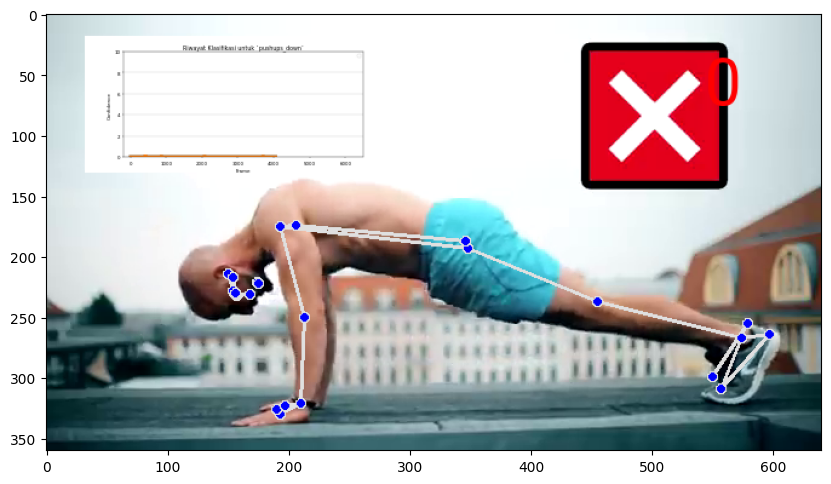

 62%|██████▏   | 4051/6510.0 [14:28<18:28,  2.22it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 62%|██████▏   | 4052/6510.0 [14:28<15:27,  2.65it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 62%|██████▏   | 4053/6510.0 [14:29<13:11,  3.10it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 62%|██████▏   | 4054/6510.0 [14:29<11:34,  3.54it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 62%|██████▏   | 4055/6510.0 [14:29<10:28,  3.90it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 62%|██████▏   | 4056/6510.0 [14:29<09:49,  4.17it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 62%|██████▏   | 4057/6510.0 [14:29<09:10,  4.45it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 62%|██████▏   | 4058/6510.0 [14:30<08:59,  4.54it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

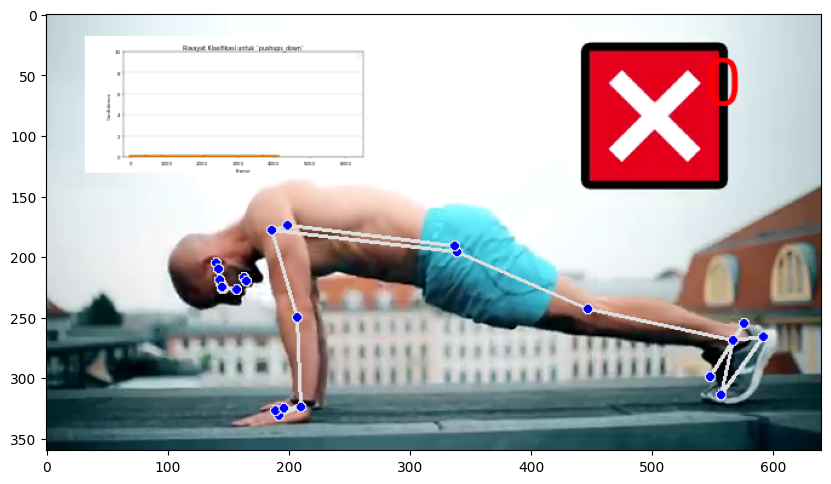

 63%|██████▎   | 4101/6510.0 [14:40<18:27,  2.17it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 63%|██████▎   | 4102/6510.0 [14:40<15:23,  2.61it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 63%|██████▎   | 4103/6510.0 [14:40<13:06,  3.06it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 63%|██████▎   | 4104/6510.0 [14:41<11:27,  3.50it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 63%|██████▎   | 4105/6510.0 [14:41<10:21,  3.87it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 63%|██████▎   | 4106/6510.0 [14:41<09:44,  4.11it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 63%|██████▎   | 4107/6510.0 [14:41<09:15,  4.33it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 63%|██████▎   | 4108/6510.0 [14:41<08:46,  4.56it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

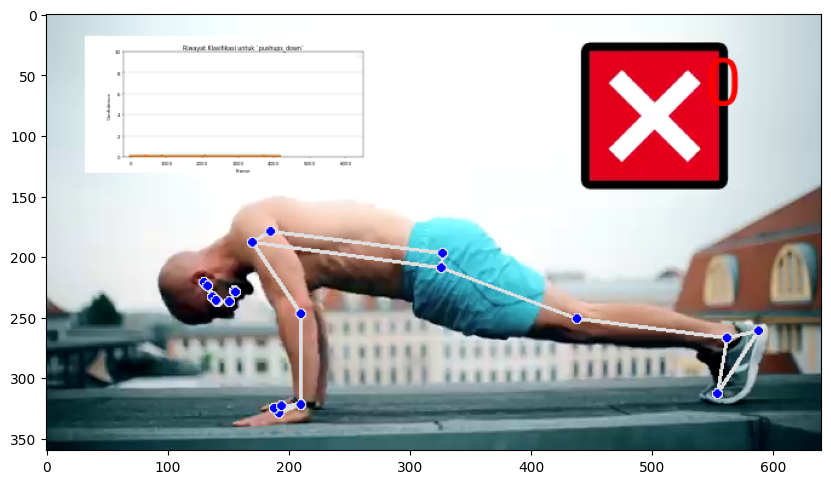

 64%|██████▍   | 4151/6510.0 [14:51<21:13,  1.85it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 64%|██████▍   | 4152/6510.0 [14:51<18:19,  2.15it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 64%|██████▍   | 4153/6510.0 [14:52<15:42,  2.50it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 64%|██████▍   | 4154/6510.0 [14:52<13:44,  2.86it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 64%|██████▍   | 4155/6510.0 [14:52<12:10,  3.22it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 64%|██████▍   | 4156/6510.0 [14:52<11:05,  3.54it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 64%|██████▍   | 4157/6510.0 [14:52<10:08,  3.87it/s]WARNING:matplotlib.legend:No handles with labels found to put in legend.
 64%|██████▍   | 4158/6510.0 [14:53<09:25,  4.16it/s]WARNING:matplotlib.legend:No handles with labels found to put in 

KeyboardInterrupt: 

In [ ]:
# Run classification on a video.
import os
import tqdm

from mediapipe.python.solutions import drawing_utils as mp_drawing


# Open output video.
out_video = cv2.VideoWriter(out_video_path, cv2.VideoWriter_fourcc(*'mp4v'), video_fps, (video_width, video_height))

frame_idx = 0
output_frame = None
with tqdm.tqdm(total=video_n_frames, position=0, leave=True) as pbar:
  while True:
    # Get next frame of the video.
    success, input_frame = video_cap.read()
    if not success:
      break

    # Run pose tracker.
    input_frame = cv2.cvtColor(input_frame, cv2.COLOR_BGR2RGB)
    result = pose_tracker.process(image=input_frame)
    pose_landmarks = result.pose_landmarks

    # Draw pose prediction.
    output_frame = input_frame.copy()
    if pose_landmarks is not None:
      mp_drawing.draw_landmarks(
          image=output_frame,
          landmark_list=pose_landmarks,
          connections=mp_pose.POSE_CONNECTIONS)

    if pose_landmarks is not None:
      # Get landmarks.
      frame_height, frame_width = output_frame.shape[0], output_frame.shape[1]
      pose_landmarks = np.array([[lmk.x * frame_width, lmk.y * frame_height, lmk.z * frame_width]
                                 for lmk in pose_landmarks.landmark], dtype=np.float32)
      assert pose_landmarks.shape == (33, 3), 'Unexpected landmarks shape: {}'.format(pose_landmarks.shape)

      # Classify the pose on the current frame.
      pose_classification = pose_classifier(pose_landmarks)

      # Smooth classification using EMA.
      pose_classification_filtered = pose_classification_filter(pose_classification)

      # Count repetitions.
      repetitions_count = repetition_counter(pose_classification_filtered)
    else:
      # No pose => no classification on current frame.
      pose_classification = None

      # Still add empty classification to the filter to maintaing correct
      # smoothing for future frames.
      pose_classification_filtered = pose_classification_filter(dict())
      pose_classification_filtered = None

      # Don't update the counter presuming that person is 'frozen'. Just
      # take the latest repetitions count.
      repetitions_count = repetition_counter.n_repeats

    # Draw classification plot and repetition counter.
    output_frame = pose_classification_visualizer(
        frame=output_frame,
        pose_classification=pose_classification,
        pose_classification_filtered=pose_classification_filtered,
        repetitions_count=repetitions_count)

    # Save the output frame.
    out_video.write(cv2.cvtColor(np.array(output_frame), cv2.COLOR_RGB2BGR))

    # Show intermediate frames of the video to track progress.
    if frame_idx % 50 == 0:
      show_image(output_frame)

    frame_idx += 1
    pbar.update()

# Close output video.
out_video.release()

# Release MediaPipe resources.
pose_tracker.close()

# Show the last frame of the video.
if output_frame is not None:
  show_image(output_frame)

In [ ]:
# Download generated video
files.download(out_video_path)